In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [4]:
bus = pd.read_json('yelp_academic_dataset_business.json',lines=True)

In [6]:
user = pd.read_json('yelp_academic_dataset_user.json',lines=True)

In [6]:
review = pd.read_json('yelp_academic_dataset_review.json',lines=True)

In [7]:
tip = pd.read_json('yelp_academic_dataset_tip.json',lines=True)

In [8]:
user[user['user_id']=='WCjg0jdHXMlwbqS9tZUx8Q']

In [10]:
checkin = pd.read_json('yelp_academic_dataset_checkin.json',lines=True)

In [12]:
buscheck = pd.merge(bus, checkin)

In [13]:
buscheck.dropna(inplace=True)

In [14]:
buscheck = buscheck.reset_index(drop=True)

In [16]:
buscheck['checkincnt'] = buscheck['date'].str.count(',')+1

In [17]:
buscheck = buscheck.drop('date', axis =1)
buscheck = buscheck.drop('name', axis =1)
buscheck = buscheck.drop('address', axis =1)
buscheck = buscheck.drop('latitude', axis =1)
buscheck = buscheck.drop('longitude', axis =1)

In [19]:
buscheck['hours2'] = buscheck['hours'].str.join(', ')

In [20]:
buscheck['#ofdaysopen'] = buscheck['hours2'].str.count(',')+1
buscheck = buscheck.drop('hours2', axis =1)

In [21]:
buscheck['Mondaytime'] = buscheck['hours'].str.get('Monday')
buscheck['Tuesdaytime'] = buscheck['hours'].str.get('Tuesday')
buscheck['Wednesdaytime'] = buscheck['hours'].str.get('Wednesday')
buscheck['Thursdaytime'] = buscheck['hours'].str.get('Thursday')
buscheck['Fridaytime'] = buscheck['hours'].str.get('Friday')
buscheck['Saturdaytime'] = buscheck['hours'].str.get('Saturday')
buscheck['Sundaytime'] = buscheck['hours'].str.get('Sunday')

#splitting data 1
buscheck[['MhoursO', 'MhoursC']] = buscheck['Mondaytime'].str.split('-',1, expand=True)
buscheck[['TuhoursO', 'TuhoursC']] = buscheck['Tuesdaytime'].str.split('-',1, expand=True)
buscheck[['WhoursO', 'WhoursC']] = buscheck['Wednesdaytime'].str.split('-',1, expand=True)
buscheck[['ThoursO', 'ThoursC']] = buscheck['Thursdaytime'].str.split('-',1, expand=True)
buscheck[['FhoursO', 'FhoursC']] = buscheck['Fridaytime'].str.split('-',1, expand=True)
buscheck[['SahoursO', 'SahoursC']] = buscheck['Saturdaytime'].str.split('-',1, expand=True)
buscheck[['ShoursO', 'ShoursC']] = buscheck['Sundaytime'].str.split('-',1, expand=True)

#splitting data 2
buscheck[['MhoursCint1', 'MhoursCint2']] = buscheck['MhoursC'].str.split(':',1, expand=True)
buscheck[['MhoursOint1', 'MhoursOint2']] = buscheck['MhoursO'].str.split(':',1, expand=True)

buscheck[['TuhoursCint1', 'TuhoursCint2']] = buscheck['TuhoursC'].str.split(':',1, expand=True)
buscheck[['TuhoursOint1', 'TuhoursOint2']] = buscheck['TuhoursO'].str.split(':',1, expand=True)

buscheck[['WhoursCint1', 'WhoursCint2']] = buscheck['WhoursC'].str.split(':',1, expand=True)
buscheck[['WhoursOint1', 'WhoursOint2']] = buscheck['WhoursO'].str.split(':',1, expand=True)

buscheck[['ThoursCint1', 'ThoursCint2']] = buscheck['ThoursC'].str.split(':',1, expand=True)
buscheck[['ThoursOint1', 'ThoursOint2']] = buscheck['ThoursO'].str.split(':',1, expand=True)

buscheck[['FhoursCint1', 'FhoursCint2']] = buscheck['FhoursC'].str.split(':',1, expand=True)
buscheck[['FhoursOint1', 'FhoursOint2']] = buscheck['FhoursO'].str.split(':',1, expand=True)

buscheck[['SahoursCint1', 'SahoursCint2']] = buscheck['SahoursC'].str.split(':',1, expand=True)
buscheck[['SahoursOint1', 'SahoursOint2']] = buscheck['SahoursO'].str.split(':',1, expand=True)

buscheck[['ShoursCint1', 'ShoursCint2']] = buscheck['ShoursC'].str.split(':',1, expand=True)
buscheck[['ShoursOint1', 'ShoursOint2']] = buscheck['ShoursO'].str.split(':',1, expand=True)

#fill none value with 0
buscheck = buscheck.fillna(0)

#change data type and calculate
buscheck['MhoursCint1'] = buscheck['MhoursCint1'].astype(np.int64)
buscheck['MhoursCint2'] = buscheck['MhoursCint2'].astype(np.int64)
buscheck['MhoursOint1'] = buscheck['MhoursOint1'].astype(np.int64)
buscheck['MhoursOint2'] = buscheck['MhoursOint2'].astype(np.int64)
buscheck['MhoursCint']= buscheck['MhoursCint1'] + (buscheck['MhoursCint2']/60)
buscheck['MhoursOint']= buscheck['MhoursOint1'] + (buscheck['MhoursOint2']/60)
buscheck['MHours']= buscheck['MhoursCint']-buscheck['MhoursOint']

buscheck['TuhoursCint1'] = buscheck['TuhoursCint1'].astype(np.int64)
buscheck['TuhoursCint2'] = buscheck['TuhoursCint2'].astype(np.int64)
buscheck['TuhoursOint1'] = buscheck['TuhoursOint1'].astype(np.int64)
buscheck['TuhoursOint2'] = buscheck['TuhoursOint2'].astype(np.int64)
buscheck['TuhoursCint']= buscheck['TuhoursCint1'] + (buscheck['TuhoursCint2']/60)
buscheck['TuhoursOint']= buscheck['TuhoursOint1'] + (buscheck['TuhoursOint2']/60)
buscheck['TuHours']= buscheck['TuhoursCint']-buscheck['TuhoursOint']

buscheck['WhoursCint1'] = buscheck['WhoursCint1'].astype(np.int64)
buscheck['WhoursCint2'] = buscheck['WhoursCint2'].astype(np.int64)
buscheck['WhoursOint1'] = buscheck['WhoursOint1'].astype(np.int64)
buscheck['WhoursOint2'] = buscheck['WhoursOint2'].astype(np.int64)
buscheck['WhoursCint']= buscheck['WhoursCint1'] + (buscheck['WhoursCint2']/60)
buscheck['WhoursOint']= buscheck['WhoursOint1'] + (buscheck['WhoursOint2']/60)
buscheck['WHours']= buscheck['WhoursCint']-buscheck['WhoursOint']

buscheck['ThoursCint1'] = buscheck['ThoursCint1'].astype(np.int64)
buscheck['ThoursCint2'] = buscheck['ThoursCint2'].astype(np.int64)
buscheck['ThoursOint1'] = buscheck['ThoursOint1'].astype(np.int64)
buscheck['ThoursOint2'] = buscheck['ThoursOint2'].astype(np.int64)
buscheck['ThoursCint']= buscheck['ThoursCint1'] + (buscheck['ThoursCint2']/60)
buscheck['ThoursOint']= buscheck['ThoursOint1'] + (buscheck['ThoursOint2']/60)
buscheck['THours']= buscheck['ThoursCint']-buscheck['ThoursOint']

buscheck['FhoursCint1'] = buscheck['FhoursCint1'].astype(np.int64)
buscheck['FhoursCint2'] = buscheck['FhoursCint2'].astype(np.int64)
buscheck['FhoursOint1'] = buscheck['FhoursOint1'].astype(np.int64)
buscheck['FhoursOint2'] = buscheck['FhoursOint2'].astype(np.int64)
buscheck['FhoursCint']= buscheck['FhoursCint1'] + (buscheck['FhoursCint2']/60)
buscheck['FhoursOint']= buscheck['FhoursOint1'] + (buscheck['FhoursOint2']/60)
buscheck['FHours']= buscheck['FhoursCint']-buscheck['FhoursOint']

buscheck['SahoursCint1'] = buscheck['SahoursCint1'].astype(np.int64)
buscheck['SahoursCint2'] = buscheck['SahoursCint2'].astype(np.int64)
buscheck['SahoursOint1'] = buscheck['SahoursOint1'].astype(np.int64)
buscheck['SahoursOint2'] = buscheck['SahoursOint2'].astype(np.int64)
buscheck['SahoursCint']= buscheck['SahoursCint1'] + (buscheck['SahoursCint2']/60)
buscheck['SahoursOint']= buscheck['SahoursOint1'] + (buscheck['SahoursOint2']/60)
buscheck['SaHours']= buscheck['SahoursCint']-buscheck['SahoursOint']

buscheck['ShoursCint1'] = buscheck['ShoursCint1'].astype(np.int64)
buscheck['ShoursCint2'] = buscheck['ShoursCint2'].astype(np.int64)
buscheck['ShoursOint1'] = buscheck['ShoursOint1'].astype(np.int64)
buscheck['ShoursOint2'] = buscheck['ShoursOint2'].astype(np.int64)
buscheck['ShoursCint']= buscheck['ShoursCint1'] + (buscheck['ShoursCint2']/60)
buscheck['ShoursOint']= buscheck['ShoursOint1'] + (buscheck['ShoursOint2']/60)
buscheck['SHours']= buscheck['ShoursCint']-buscheck['ShoursOint']

#dropping unnecessary column
buscheck = buscheck.drop('MhoursO', axis =1)
buscheck = buscheck.drop('MhoursC', axis =1)
buscheck = buscheck.drop('MhoursOint', axis =1)
buscheck = buscheck.drop('MhoursCint', axis =1)
buscheck = buscheck.drop('MhoursOint1', axis =1)
buscheck = buscheck.drop('MhoursCint1', axis =1)
buscheck = buscheck.drop('MhoursOint2', axis =1)
buscheck = buscheck.drop('MhoursCint2', axis =1)

buscheck = buscheck.drop('TuhoursO', axis =1)
buscheck = buscheck.drop('TuhoursC', axis =1)
buscheck = buscheck.drop('TuhoursOint', axis =1)
buscheck = buscheck.drop('TuhoursCint', axis =1)
buscheck = buscheck.drop('TuhoursOint1', axis =1)
buscheck = buscheck.drop('TuhoursCint1', axis =1)
buscheck = buscheck.drop('TuhoursOint2', axis =1)
buscheck = buscheck.drop('TuhoursCint2', axis =1)

buscheck = buscheck.drop('WhoursO', axis =1)
buscheck = buscheck.drop('WhoursC', axis =1)
buscheck = buscheck.drop('WhoursOint', axis =1)
buscheck = buscheck.drop('WhoursCint', axis =1)
buscheck = buscheck.drop('WhoursOint1', axis =1)
buscheck = buscheck.drop('WhoursCint1', axis =1)
buscheck = buscheck.drop('WhoursOint2', axis =1)
buscheck = buscheck.drop('WhoursCint2', axis =1)

buscheck = buscheck.drop('ThoursO', axis =1)
buscheck = buscheck.drop('ThoursC', axis =1)
buscheck = buscheck.drop('ThoursOint', axis =1)
buscheck = buscheck.drop('ThoursCint', axis =1)
buscheck = buscheck.drop('ThoursOint1', axis =1)
buscheck = buscheck.drop('ThoursCint1', axis =1)
buscheck = buscheck.drop('ThoursOint2', axis =1)
buscheck = buscheck.drop('ThoursCint2', axis =1)

buscheck = buscheck.drop('FhoursO', axis =1)
buscheck = buscheck.drop('FhoursC', axis =1)
buscheck = buscheck.drop('FhoursOint', axis =1)
buscheck = buscheck.drop('FhoursCint', axis =1)
buscheck = buscheck.drop('FhoursOint1', axis =1)
buscheck = buscheck.drop('FhoursCint1', axis =1)
buscheck = buscheck.drop('FhoursOint2', axis =1)
buscheck = buscheck.drop('FhoursCint2', axis =1)

buscheck = buscheck.drop('SahoursO', axis =1)
buscheck = buscheck.drop('SahoursC', axis =1)
buscheck = buscheck.drop('SahoursOint', axis =1)
buscheck = buscheck.drop('SahoursCint', axis =1)
buscheck = buscheck.drop('SahoursOint1', axis =1)
buscheck = buscheck.drop('SahoursCint1', axis =1)
buscheck = buscheck.drop('SahoursOint2', axis =1)
buscheck = buscheck.drop('SahoursCint2', axis =1)

buscheck = buscheck.drop('ShoursO', axis =1)
buscheck = buscheck.drop('ShoursC', axis =1)
buscheck = buscheck.drop('ShoursOint', axis =1)
buscheck = buscheck.drop('ShoursCint', axis =1)
buscheck = buscheck.drop('ShoursOint1', axis =1)
buscheck = buscheck.drop('ShoursCint1', axis =1)
buscheck = buscheck.drop('ShoursOint2', axis =1)
buscheck = buscheck.drop('ShoursCint2', axis =1)

buscheck = buscheck.drop('Mondaytime', axis=1)
buscheck = buscheck.drop('Tuesdaytime', axis =1)
buscheck = buscheck.drop('Wednesdaytime', axis =1)
buscheck = buscheck.drop('Thursdaytime', axis =1)
buscheck = buscheck.drop('Fridaytime', axis =1)
buscheck = buscheck.drop('Saturdaytime', axis =1)
buscheck = buscheck.drop('Sundaytime', axis =1)

buscheck['Totaltime'] = buscheck.MHours +buscheck.TuHours+ buscheck.WHours +buscheck.THours+ buscheck.FHours+ buscheck.SaHours+buscheck.SHours

In [4]:
buscheck

In [23]:
buscheck['AcceptCreditCard'] = buscheck['attributes'].str.get('BusinessAcceptsCreditCards')
buscheck['AcceptCreditCard'] = buscheck['AcceptCreditCard'].replace(to_replace='True', value=1)
buscheck['AcceptCreditCard'] = buscheck['AcceptCreditCard'].replace(to_replace='False', value=0)
buscheck['AcceptCreditCard'] = buscheck['AcceptCreditCard'].fillna(0)

In [37]:
buscheck.categories.unique()

In [25]:
from sklearn.preprocessing import OneHotEncoder

buscheck['Wifi'] = buscheck['attributes'].str.get('WiFi')
buscheck['Wifi'] = buscheck['Wifi'].fillna('no')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="u'no'", value='no')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="u'free'", value='free')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="'free'", value='free')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="'no'", value='no')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="u'paid'", value='pay')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace="'paid'", value='pay')
buscheck['Wifi'] = buscheck['Wifi'].replace(to_replace='None', value='no')

enc = OneHotEncoder(dtype='int64')
enc_df = pd.DataFrame(enc.fit_transform(buscheck[['Wifi']]).toarray())
enc_df['Wifi_free'] = enc_df[0]
enc_df['Wifi_no'] = enc_df[1]
enc_df['Wifi_pay'] = enc_df[2]

buscheck = pd.concat([buscheck,enc_df], axis=1)

buscheck['Noise'] = buscheck['attributes'].str.get('NoiseLevel')

buscheck['Noise'] = buscheck['Noise'].fillna('None')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="u'average'", value='average')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="'average'", value='average')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="u'quiet'", value='quiet')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="'quiet'", value='quiet')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="'loud'", value='loud')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="u'loud'", value='loud')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="u'very_loud'", value='very loud')
buscheck['Noise'] = buscheck['Noise'].replace(to_replace="'very_loud'", value='very loud')

scale_mapper = {'None':0, 'quiet':1, 'average':2, 'loud':3, 'very loud':4}
buscheck['Noise'] = buscheck['Noise'].replace(scale_mapper)

In [26]:
buscheck = buscheck.drop(0, axis =1)
buscheck = buscheck.drop(1, axis =1)
buscheck = buscheck.drop(2, axis =1)
buscheck = buscheck.drop('Wifi', axis =1)

In [27]:
import ast

buscheck['Parking'] = buscheck['attributes'].str.get('BusinessParking')

park = buscheck[['Parking', 'business_id']]
park['Parking'][0]
park['Parking'] = park['Parking'].fillna(0)
isParking = []
w = 0
par = park['Parking']
for i in par:
    w = w+1
#     print(w)
    if i == None or i == 0 or i=='None':
        res = 0
#         print(res)
        isParking.append(res)
    else:
        res = ast.literal_eval(i)
#         print(res)
        isParking.append(res)

C:\Users\nirva\AppData\Local\Temp/ipykernel_7056/3020154129.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  park['Parking'] = park['Parking'].fillna(0)


In [28]:
parking = []
y = 0
for i in isParking:
    y = y+1
#     print(y)
#     print(i)
    if i == 0:
        parking.append(0)
    else:
        values = i.values()
        total = sum(filter(None,values))
#         print(total)
        parking.append(total)

In [29]:
parking_fin = []
for i in parking:
    if i >= 1:
        i = 1
    else:
        i = 0
    parking_fin.append(i)

In [30]:
buscheck.drop('Parking',axis=1,inplace=True)

In [31]:
buscheck['parking'] = parking_fin

In [38]:
tipt = tip.groupby('business_id')['user_id'].value_counts().reset_index(name='nu')
tipt

In [51]:
usertipt = pd.merge(user,tipt)
# usertipt

In [7]:
pd.set_option('display.max_columns', None)
usertipt

In [53]:
els = [] 
for i in range(0,len(usertipt['elite'])):
    els.append(len(usertipt['elite'][i].split(',')))

In [54]:
usertipt['elite_years'] = els

In [55]:
usertipt.drop('elite',axis=1,inplace=True)

In [56]:
usertipt['yelping_since'] = pd.to_datetime(usertipt['yelping_since'])

In [57]:
usertipt['days_yelped'] = pd.to_datetime('today') - usertipt['yelping_since']

In [58]:
usertipt['days_yelped'] = usertipt['days_yelped'].dt.days

In [59]:
usertipt.drop('yelping_since',axis=1,inplace=True)

In [8]:
usertipt

In [64]:
classifier = pipeline('zero-shot-classification',device=0)

In [39]:
test_list_restaurant = ['Restaurant','restaurant','Food','food','Bar','bar','Hotel','hotel']
w = 0
isRestaurant = []

for i in buscheck.categories:
     print(i)
    w=w+1
     print(w)
    res = any(ele in i for ele in test_list_restaurant)
    if res==True:
        res=1
        isRestaurant.append(res)
    else:
        res=0
        isRestaurant.append(res)
    print(res)

In [71]:
test_list_health = ['Health','health','Medical','medical','Dentist','dentist']
w = 0
isHealth = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_health)
    if res==True:
        res=1
        isHealth.append(res)
    else:
        res=0
        isHealth.append(res)
#     print(res)

In [72]:
test_list_education = ['School','school','Education','education']
w = 0
isEducation = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_education)
    if res==True:
        res=1
        isEducation.append(res)
    else:
        res=0
        isEducation.append(res)
#     print(res)

In [73]:
test_list_spa = ['Spa','spa']
w = 0
isSpa = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_spa)
    if res==True:
        res=1
        isSpa.append(res)
    else:
        res=0
        isSpa.append(res)
#     print(res)

In [74]:
test_list_spa = ['Spa','spa']
w = 0
isSpa = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_spa)
    if res==True:
        res=1
        isSpa.append(res)
    else:
        res=0
        isSpa.append(res)
#     print(res)

In [77]:
test_list_fit = ['Sport','sport','Gym','gym','Fitness','fitness']
w = 0
isFit = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_fit)
    if res==True:
        res=1
        isFit.append(res)
    else:
        res=0
        isFit.append(res)
#     print(res)

Gastropubs, Food, Beer Gardens, Restaurants, Bars, American (Traditional), Beer Bar, Nightlife, Breweries
1
0
Salad, Soup, Sandwiches, Delis, Restaurants, Cafes, Vegetarian
2
0
Antiques, Fashion, Used, Vintage & Consignment, Shopping, Furniture Stores, Home & Garden
3
0
Gyms, Active Life, Interval Training Gyms, Fitness & Instruction
4
1
Restaurants, Thai
5
0
Dentists, Health & Medical, Orthodontists
6
0
Shopping, Jewelry Repair, Appraisal Services, Local Services, Jewelry, Engraving, Gold Buyers
7
0
Barbers, Beauty & Spas
8
0
Food, Shopping, Convenience Stores, Souvenir Shops
9
0
Wigs, Hair Extensions, Hair Salons, Blow Dry/Out Services, Hair Stylists, Beauty & Spas, Shopping
10
0
Food, Pizza, Restaurants
11
0
Restaurants, American (New), Bakeries, Desserts, Food, Cupcakes
12
0
Books, Mags, Music & Video, Musical Instruments & Teachers, Pawn Shops, Shopping, Videos & Video Game Rental, Jewelry
13
0
Oil Change Stations, Smog Check Stations, Automotive, Car Wash
14
0
Restaurants, Americ

850
0
Rehabilitation Center, Hospice, Health & Medical, Retirement Homes, Counseling & Mental Health
851
0
Restaurants, Tacos, Mexican, Tex-Mex
852
0
Massage, Makeup Artists, Day Spas, Skin Care, Beauty & Spas
853
0
Electronics, Shopping
854
0
Mobile Phones, Shopping
855
0
Burgers, Restaurants, Gastropubs, American (New)
856
0
Restaurants, Food Trucks, Caterers, Taiwanese, Asian Fusion, Event Planning & Services, Food
857
0
Tobacco Shops, Shopping
858
0
Food, Cosmetics & Beauty Supply, Shopping, Drugstores, Beauty & Spas, Convenience Stores
859
0
Chinese, Food, Restaurants, Specialty Food
860
0
Bridal, Fashion, Wedding Planning, Event Planning & Services, Shopping, Formal Wear
861
0
Vacation Rentals, Home Services, Real Estate, Hotels, Guest Houses, Event Planning & Services, Apartments, Hotels & Travel
862
0
Financial Services, Banks & Credit Unions
863
0
Beauty & Spas, Day Spas, Skin Care, Massage
864
0
Chiropractors, Physical Therapy, Medical Centers, Health & Medical
865
0
Beauty &

1748
0
Fashion, Shopping, Swimwear
1749
0
Home Services, Flooring, Carpeting
1750
0
Food Trucks, Vegan, Gluten-Free, Burgers, Restaurants, Food
1751
0
Pediatricians, Family Practice, Doctors, Obstetricians & Gynecologists, Health & Medical, Internal Medicine
1752
0
CSA, Fruits & Veggies, Grocery, Food Delivery Services, Food, Farmers Market, Specialty Food
1753
0
Pubs, Bars, Nightlife
1754
0
Hair Salons, Beauty & Spas
1755
0
Local Services, Self Storage
1756
0
Beauty & Spas, Barbers
1757
0
Food, Coffee & Tea
1758
0
Fitness & Instruction, Active Life, Yoga
1759
1
Real Estate Agents, Home Services, Commercial Real Estate, Real Estate, Real Estate Services
1760
0
Donuts, Food, Coffee & Tea
1761
0
Local Services, Sewing & Alterations, Professional Services
1762
0
Beauty & Spas, Massage
1763
0
Mediterranean, Kebab, Middle Eastern, Restaurants, Sandwiches, Greek
1764
0
Nightlife, Bars, Thai, Food, Restaurants, Event Planning & Services, Beer, Wine & Spirits, Caterers
1765
0
Ice Cream & Froze

2723
0
Restaurants, Fast Food, Burgers
2724
0
Pizza, Restaurants, Italian
2725
0
Car Wash, Automotive
2726
0
Restaurants, Hawaiian
2727
0
Nightlife, Cocktail Bars, Bars, Lounges, Hookah Bars
2728
0
Caterers, Bars, Salad, Mexican, Restaurants, Seafood, Event Planning & Services, Nightlife
2729
0
Wineries, Arts & Entertainment, Food, Local Flavor
2730
0
Doctors, Health & Medical, Medical Centers, Naturopathic/Holistic, Midwives
2731
0
Self Storage, Local Services
2732
0
Health & Medical, General Dentistry, Dentists, Cosmetic Dentists, Pediatric Dentists
2733
0
Shopping, Thrift Stores, Community Service/Non-Profit, Local Services
2734
0
Turkish, Delis, Restaurants, Mediterranean, Kebab
2735
0
Office Cleaning, Professional Services, Home Organization, Window Washing, Home Cleaning, Home Services
2736
0
General Dentistry, Health & Medical, Dentists
2737
0
Medical Centers, Health & Medical, Doctors, Urgent Care
2738
0
Health & Medical, General Dentistry, Trainers, Fitness & Instruction, Acti

Restaurants, Hot Dogs, Burgers, Diners
3690
0
Beauty & Spas, Nail Salons
3691
0
Chinese, Restaurants, Asian Fusion, Gluten-Free
3692
0
American (Traditional), Restaurants, Bars, Salad, Nightlife, Seafood, Steakhouses
3693
0
Ethnic Grocery, Food, International Grocery, Grocery
3694
0
Asian Fusion, Chinese, Dim Sum, Event Planning & Services, Caterers, Cantonese, Party & Event Planning, Sushi Bars, Restaurants, Venues & Event Spaces
3695
0
Hobby Shops, Shopping, Arts & Crafts, Event Planning & Services, Knitting Supplies, Party Supplies, Art Supplies
3696
0
Plumbing, Professional Services, Home Services
3697
0
Beauty & Spas, Massage
3698
0
Appliances & Repair, Handyman, Home Services, Professional Services, Local Services, Appliances, Home & Garden, Shopping
3699
0
Home Services, Real Estate, Restaurants, Breakfast & Brunch, Apartments
3700
0
Coffee & Tea, Convenience Stores, Food
3701
0
Museums, Arts & Entertainment
3702
0
Home Services, Home & Garden, Shopping, Contractors, Countertop 

0
Tobacco Shops, Shopping, Nightlife, Bars, Hookah Bars, Vape Shops
4541
0
Restaurants, Nightlife, Bars, Wine Bars, Italian, American (New)
4542
0
Halotherapy, Medical Spas, Massage, Day Spas, Doctors, Health & Medical, Beauty & Spas, Naturopathic/Holistic
4543
0
Ice Cream & Frozen Yogurt, Food
4544
0
Local Services, Self Storage
4545
0
Contractors, Windows Installation, Home & Garden, Door Sales/Installation, Kitchen & Bath, Home Decor, Glass & Mirrors, Shopping, Home Services
4546
0
Restaurants, Cafes, Vegetarian
4547
0
Cocktail Bars, American (New), Nightlife, Food, Restaurants, Mexican, Bars, Desserts
4548
0
Vegetarian, Shopping, Restaurants, Food Stands, Food, Food Trucks, Sandwiches
4549
0
Hair Salons, Hair Removal, Beauty & Spas
4550
0
Pediatricians, Doctors, Home Health Care, Urgent Care, Health & Medical, Family Practice
4551
0
American (New), Sandwiches, Event Planning & Services, Restaurants, Breweries, Food, Venues & Event Spaces, Tapas/Small Plates
4552
0
Beauty & Spas, Na

Burgers, Fast Food, Restaurants
5534
0
Bars, American (New), Wine Bars, Restaurants, Nightlife, Food, Beer, Wine & Spirits, Tapas/Small Plates, Sandwiches, Beer Bar
5535
0
Sushi Bars, Japanese, Restaurants
5536
0
Health & Medical, Urgent Care
5537
0
Food, Restaurants, Coffee & Tea, Breakfast & Brunch, Desserts, Cafes, Austrian
5538
0
Specialty Schools, Cosmetology Schools, Education, Beauty & Spas, Massage, Makeup Artists, Hair Removal, Skin Care
5539
0
Hair Removal, Cosmetics & Beauty Supply, Beauty & Spas, Shopping, Makeup Artists
5540
0
Massage Therapy, Health & Medical, Reflexology
5541
0
Diagnostic Imaging, Urgent Care, Medical Centers, Hospitals, Emergency Rooms, Diagnostic Services, Health & Medical
5542
0
Restaurants, Vietnamese
5543
0
Massage, Skin Care, Beauty & Spas, Day Spas
5544
0
Shopping, Home & Garden, Hardware Stores
5545
0
Doctors, Pediatricians, Health & Medical
5546
0
Health & Medical, Weight Loss Centers, Chiropractors, Doctors, Massage Therapy, Sports Medicine
554

Local Services, Carpet Cleaning, Pressure Washers, Automotive, Home Services, Auto Detailing, Carpeting
6442
0
Chiropractors, Health & Medical, Acupuncture, Massage Therapy
6443
0
Art Galleries, Home Decor, Hair Salons, Home & Garden, Hair Stylists, Arts & Entertainment, Waxing, Skin Care, Hair Removal, Furniture Stores, Beauty & Spas, Jewelry, Makeup Artists, Cosmetics & Beauty Supply, Shopping
6444
0
Restaurants, Seafood, Sandwiches, American (Traditional)
6445
0
Lounges, Tapas Bars, Tapas/Small Plates, Bars, Restaurants, Nightlife
6446
0
Sports Bars, Restaurants, Nightlife, American (Traditional), Bars
6447
1
Cannabis Clinics, Shopping, Cannabis Dispensaries, Health & Medical
6448
0
Restaurants, Asian Fusion, Food Trucks, Food, Barbeque
6449
0
Restaurants, Fast Food, American (Traditional)
6450
0
Desserts, Custom Cakes, Cupcakes, Food, Bakeries
6451
0
Event Planning & Services, Hotels & Travel, Hotels
6452
0
Restaurants, Southern, Soul Food
6453
0
Cafes, Coffee & Tea, Restaurants, F

7388
0
Fitness & Instruction, Active Life, Yoga
7389
1
Local Services, Home Cleaning, Professional Services, Office Cleaning, Home Services, Carpet Cleaning
7390
0
Restaurants, Steakhouses, Modern European, Salad, American (Traditional), American (New), Breakfast & Brunch
7391
0
Pets, Veterinarians
7392
0
Apartments, Home Services, Real Estate
7393
0
Optometrists, Health & Medical, Shopping, Eyewear & Opticians
7394
0
American (New), Nightlife, Bars, Restaurants
7395
0
Mexican, Fast Food, Restaurants, Tex-Mex
7396
0
Appliances & Repair, Home Services, Local Services, Handyman
7397
0
Chiropractors, Massage Therapy, Acupuncture, Health & Medical
7398
0
Restaurants, Chinese
7399
0
Seafood, Restaurants, Latin American, Mexican
7400
0
Tex-Mex, Mexican, Restaurants
7401
0
Convenience Stores, Photography Stores & Services, Food, Cosmetics & Beauty Supply, Drugstores, Shopping, Beauty & Spas
7402
0
Breakfast & Brunch, Bars, Hotels, Sandwiches, Hotels & Travel, Event Planning & Services, Nightl

Mortgage Brokers, Real Estate, Home Services
8320
0
Mediterranean, Salad, Vegetarian, Kebab, Sandwiches, Restaurants, Greek
8321
0
Dive Bars, Bars, Nightlife, American (Traditional), Restaurants
8322
0
Shopping, Discount Store, Grocery, Food
8323
0
Arts & Crafts, Art Supplies, Fabric Stores, Home & Garden, Shopping, Home Decor
8324
0
Cremation Services, Local Services, Funeral Services & Cemeteries
8325
0
Makeup Artists, Waxing, Beauty & Spas, Hair Removal
8326
0
Real Estate Services, Home Services, Real Estate, Financial Advising, Financial Services, Mortgage Lenders, Mortgage Brokers
8327
0
Sports Wear, Shoe Stores, Sporting Goods, Shopping, Fashion
8328
1
Dry Cleaning & Laundry, Laundry Services, Local Services, Sewing & Alterations, Dry Cleaning
8329
0
Barbeque, Restaurants
8330
0
Hotels & Travel, Nightlife, Lounges, Bars
8331
0
Caterers, Mexican, Restaurants, Fast Food, Event Planning & Services
8332
0
Hotels & Travel, Hotels, Event Planning & Services
8333
0
Mexican, Fast Food, R

0
Printing Services, Professional Services, Local Services, Shipping Centers, Signmaking
9295
0
Food, Meat Shops, Specialty Food, Fruits & Veggies, Grocery
9296
0
Home Decor, Honey, Men's Clothing, Home & Garden, Furniture Stores, Shopping, Children's Clothing, Fashion, Food, Shoe Stores, Department Stores, Women's Clothing
9297
0
Dance Clubs, Nightlife
9298
0
Gluten-Free, Diners, Breakfast & Brunch, American (New), Southern, Restaurants
9299
0
Cocktail Bars, Nightlife, Gastropubs, Bars, American (New), Sports Bars, Restaurants
9300
1
Arts & Entertainment, Food, Wine Tasting Room, Nightlife, Wineries, Bars, Wine Bars
9301
0
Beauty & Spas, Barbers
9302
0
Barbeque, Restaurants
9303
0
Restaurants, Steakhouses, American (New), American (Traditional)
9304
0
Beauty & Spas, Massage Therapy, Health & Medical, Reiki, Massage
9305
0
Toy Stores, Baby Gear & Furniture, Kids Activities, Shopping, Arts & Crafts, Active Life, Art Supplies
9306
0
Health & Medical, General Dentistry, Dentists, Cosmetic

0
Local Services, Shoe Repair
10310
0
Restaurants, Thai
10311
0
Event Planning & Services, Hotels, Hotels & Travel
10312
0
Active Life, Fitness & Instruction, Recreation Centers, Child Care & Day Care, Local Services, Gyms
10313
1
Food, Restaurants, Sushi Bars, Japanese, Food Trucks
10314
0
Desserts, Seafood, American (Traditional), Food, Restaurants
10315
0
Active Life, Boating, Paddleboarding, Local Flavor, Rafting/Kayaking, Fitness & Instruction
10316
1
Event Planning & Services, Party Supplies, Party Equipment Rentals
10317
0
Greek, Italian, Breakfast & Brunch, Restaurants, Pizza
10318
0
American (Traditional), Restaurants, Bars, Pubs, Nightlife
10319
0
Banks & Credit Unions, Fitness & Instruction, Trainers, Cycling Classes, Active Life, Financial Services, Gyms
10320
1
Salad, Seafood, Spanish, American (New), Modern European, Restaurants, Mediterranean, Tapas/Small Plates, Tapas Bars, Steakhouses
10321
0
Music & DVDs, Vinyl Records, Books, Mags, Music & Video, Shopping
10322
0
Phy

11072
0
Restaurants, Bars, Pubs, Nightlife, American (New), Burgers, Gastropubs
11073
0
Active Life, Trainers, Massage, Fitness & Instruction, Beauty & Spas
11074
1
Food, Street Vendors
11075
0
Coffee & Tea, Food
11076
0
Sporting Goods, Shopping
11077
1
Shopping, Eyewear & Opticians
11078
0
Carpet Installation, Contractors, Carpeting, Rugs, Flooring, Home & Garden, Shopping, Home Services
11079
0
Burgers, Nightlife, Restaurants, Bars, Sports Bars, Sandwiches, American (Traditional)
11080
1
Cafes, Restaurants, Cafeteria
11081
0
Eyewear & Opticians, Optometrists, Health & Medical, Shopping
11082
0
Cinema, Arts & Entertainment, Cultural Center, Performing Arts
11083
0
Hair Salons, Beauty & Spas
11084
0
Restaurants, Delis, Salad, Sandwiches
11085
0
Bakeries, Sandwiches, Food, Restaurants, Desserts, Juice Bars & Smoothies
11086
0
Beauty & Spas, Health & Medical, Laser Hair Removal, Hair Removal, Weight Loss Centers, Medical Spas, Skin Care
11087
0
Restaurants, Persian/Iranian
11088
0
Restau

12023
0
Sporting Goods, Active Life, Swimwear, Fashion, Shopping, Swimming Pools
12024
1
American (Traditional), Restaurants, Food, American (New), Breakfast & Brunch, Diners, Waffles
12025
0
Restaurants, Chinese
12026
0
Automotive, Local Services, Self Storage, Parking, Truck Rental, Home Services, Movers
12027
0
Chinese, Vietnamese, Restaurants
12028
0
Delis, Restaurants, Sandwiches
12029
0
Restaurants, Pizza
12030
0
Chiropractors, Acupuncture, Sports Medicine, Physical Therapy, Health & Medical, Doctors, Nutritionists, Massage Therapy
12031
1
Restaurants, Japanese, Tapas/Small Plates, Sushi Bars
12032
0
Breakfast & Brunch, Mexican, Tacos, Restaurants, Fast Food
12033
0
Beauty & Spas, Hair Salons
12034
0
General Dentistry, Health & Medical, Dentists
12035
0
Eyewear & Opticians, Optometrists, Health & Medical, Shopping
12036
0
Recycling Center, Local Services
12037
0
Nurseries & Gardening, Flowers & Gifts, Florists, Home & Garden, Shopping
12038
0
Beauty & Spas, Hair Salons
12039
0
Re

0
Delis, Restaurants, Sandwiches, Fast Food
12937
0
Fast Food, Restaurants, Vegetarian, Vegan, Salad, Gluten-Free
12938
0
Sandwiches, Mediterranean, Restaurants, Middle Eastern
12939
0
Eyelash Service, Eyebrow Services, Beauty & Spas, Nail Salons
12940
0
Beer, Wine & Spirits, Food, Bars, Coffee & Tea, Restaurants, Sandwiches, Nightlife
12941
0
Restaurants, American (Traditional), Southern
12942
0
Fashion, Shopping, Used, Vintage & Consignment
12943
0
Restaurants, Chinese
12944
0
Hair Salons, Hair Stylists, Shopping, Beauty & Spas, Men's Hair Salons, Cosmetics & Beauty Supply
12945
0
Oil Change Stations, Automotive, Tires, Auto Repair
12946
0
Fishing, Active Life
12947
0
Food, Restaurants, Coffee & Tea
12948
0
Medical Centers, Diagnostic Services, Health & Medical, Diagnostic Imaging
12949
0
Furniture Stores, Home Decor, Home & Garden, Carpeting, Home Services, Interior Design, Rugs, Shopping
12950
0
Flowers & Gifts, Arts & Crafts, Cards & Stationery, Bridal, Event Planning & Services, 

13899
0
Hair Salons, Beauty & Spas, Makeup Artists, Hair Removal
13900
0
Restaurants, Event Planning & Services, Caterers, Barbeque
13901
0
Specialty Food, Candy Stores, Grocery, Food
13902
0
Shopping, Appraisal Services, Local Services, Jewelry
13903
0
Home Services, Home Theatre Installation, Security Systems
13904
0
Nail Salons, Day Spas, Beauty & Spas
13905
0
Fast Food, Restaurants, Burgers, Food, Coffee & Tea
13906
0
Chinese, Restaurants
13907
0
Beauty & Spas, Nail Salons, Waxing, Hair Removal, Tanning, Massage, Spray Tanning
13908
0
Grocery, Convenience Stores, Gas Stations, Food, Gas Stations, Service Stations, Shopping, Automotive, Coffee & Tea, Fast Food, Restaurants
13909
0
Arts & Entertainment, Fitness & Instruction, Specialty Schools, Education, Gyms, Performing Arts, Yoga, Pole Dancing Classes, Dance Studios, Active Life
13910
1
Arts & Entertainment, Active Life, Dance Studios, Specialty Schools, Education, Performing Arts, Fitness & Instruction, Dance Schools
13911
1
Dry 

0
Home & Garden, Shopping
14864
0
Contractors, Home & Garden, Shopping, Train Stations, Masonry/Concrete, Hotels & Travel, Home Decor, Home Services, Landscaping, Gardeners
14865
0
Art Supplies, Gift Shops, Shopping, Arts & Crafts, Cards & Stationery, Flowers & Gifts, Event Planning & Services
14866
0
Bars, Wine Bars, Caterers, Arts & Entertainment, Sports Bars, Restaurants, Venues & Event Spaces, Event Planning & Services, Nightlife, Music Venues, American (Traditional)
14867
1
Art Supplies, Arts & Crafts, Event Planning & Services, Shopping, Gift Shops, Cards & Stationery, Flowers & Gifts
14868
0
Food Trucks, Restaurants, Food, Thai
14869
0
Food, Beer, Wine & Spirits
14870
0
Hair Salons, Men's Hair Salons, Barbers, Beauty & Spas
14871
0
Cosmetics & Beauty Supply, Beauty & Spas, Shopping, Food, Drugstores, Convenience Stores, Photography Stores & Services
14872
0
Automotive, Metal Fabricators, Auto Repair, Tires, Local Services
14873
0
Coffee & Tea, Restaurants, Seafood, Breakfast & B

15776
0
Cards & Stationery, Arts & Crafts, Flowers & Gifts, Event Planning & Services, Gift Shops, Shopping, Jewelry, Toy Stores
15777
0
Diving, Shopping, Sporting Goods, Active Life, Professional Services
15778
1
Restaurants, Pizza
15779
0
Auto Repair, Automotive, Car Dealers, Auto Parts & Supplies
15780
0
Mediterranean, Restaurants
15781
0
Bars, Nightlife, Hair Salons, Karaoke, Beauty & Spas, Cocktail Bars
15782
0
Salad, Food Trucks, Vegetarian, Restaurants, Food
15783
0
American (Traditional), Breakfast & Brunch, Bars, Cajun/Creole, Pubs, Nightlife, Music Venues, Restaurants, Arts & Entertainment, Sports Bars
15784
1
Steakhouses, Seafood, Restaurants
15785
0
Cabinetry, Contractors, Countertop Installation, Interior Design, Home Services
15786
0
Coffee & Tea, Food, Restaurants, Juice Bars & Smoothies, Breakfast & Brunch
15787
0
Nail Salons, Beauty & Spas
15788
0
Bars, Nightlife, Event Planning & Services, Venues & Event Spaces, Dance Clubs
15789
0
Event Planning & Services, Hotels, H

0
Barbeque, Restaurants, Chinese
16829
0
Restaurants, Food Trucks, Cajun/Creole, Food, Seafood
16830
0
Fast Food, Hot Dogs, Sandwiches, Restaurants, Burgers
16831
0
Auto Repair, Transmission Repair, Oil Change Stations, Automotive
16832
0
Restaurants, Thai
16833
0
Restaurants, Food, Burgers, Coffee & Tea, Fast Food
16834
0
Cupcakes, Food, Ice Cream & Frozen Yogurt, Custom Cakes
16835
0
Dentists, Oral Surgeons, Health & Medical, General Dentistry
16836
0
Dry Cleaning & Laundry, Laundry Services, Local Services, Dry Cleaning, Laundromat
16837
0
Beauty & Spas, Hair Salons, Hair Stylists
16838
0
Sandwiches, Food, Restaurants
16839
0
Tires, Oil Change Stations, Auto Repair, Automotive
16840
0
Massage, Beauty & Spas
16841
0
Office Equipment, Shopping
16842
0
Event Planning & Services, Hotels, Venues & Event Spaces, Hotels & Travel, Caterers
16843
0
Auto Repair, Automotive, Oil Change Stations
16844
0
Shopping, Hobby Shops, Toy Stores
16845
0
Physical Therapy, Health & Medical
16846
0
Traditi

Massage, Beauty & Spas
17762
0
Electronics Repair, Shopping, Mobile Phones, Mobile Phone Accessories, Local Services, IT Services & Computer Repair, Mobile Phone Repair, Data Recovery
17763
0
Mailbox Centers, Shipping Centers, Local Services, Notaries, Printing Services
17764
0
Nightlife, Bars, Cocktail Bars, Irish Pub
17765
0
Ethnic Food, Food, Specialty Food
17766
0
Flowers & Gifts, Office Equipment, Shopping, Event Planning & Services, Cards & Stationery, Home & Garden, Arts & Crafts, Education, Specialty Schools, Home Services, Home Organization
17767
0
Pizza, Restaurants
17768
0
Hotels & Travel, Event Planning & Services, Hotels
17769
0
Restaurants, Italian, Seafood
17770
0
Japanese, Asian Fusion, Restaurants
17771
0
Accessories, Fashion, Shopping, Thrift Stores, Used, Vintage & Consignment
17772
0
Restaurants, Burgers
17773
0
Fitness & Instruction, Dance Studios, Active Life, Arts & Entertainment, Performing Arts, Dance Schools, Specialty Schools, Education
17774
1
Sandwiches, Re

0
Shopping, Furniture Stores, Home & Garden, Department Stores, Electronics, Fashion
18610
0
Rafting/Kayaking, Boating, Paddleboarding, Tours, Active Life, Hotels & Travel
18611
0
Hotels, Hotels & Travel, Event Planning & Services
18612
0
Food, Coffee & Tea
18613
0
Restaurants, Chinese
18614
0
Shopping, Mattresses, Furniture Stores, Home Decor, Home & Garden
18615
0
Beauty & Spas, Makeup Artists, Eyelash Service, Permanent Makeup
18616
0
Beauty & Spas, Day Spas, Hair Salons
18617
0
Hotels, Hotels & Travel, Venues & Event Spaces, Event Planning & Services
18618
0
Ice Cream & Frozen Yogurt, Food
18619
0
Dentists, Oral Surgeons, General Dentistry, Health & Medical, Cosmetic Dentists, Endodontists
18620
0
Car Dealers, Auto Parts & Supplies, Auto Repair, Automotive, Used Car Dealers
18621
0
Furniture Stores, Local Flavor, Mattresses, Shopping, Home & Garden
18622
0
Beauty & Spas, Nail Salons
18623
0
Restaurants, Thai
18624
0
Flowers & Gifts, Watch Repair, Shopping, Gift Shops, Jewelry, Loca

19641
0
Accessories, Home & Garden, Flowers & Gifts, Home Decor, Shopping, Fashion, Florists
19642
0
Body Shops, Automotive, Auto Repair, Auto Parts & Supplies, Car Dealers
19643
0
Medical Spas, Health & Medical, Beauty & Spas, Float Spa, Day Spas, Massage
19644
0
Shopping, Flowers & Gifts, Gift Shops
19645
0
Food, Southern, Restaurants, Barbeque, Food Delivery Services
19646
0
Recreation Centers, Active Life, Axe Throwing
19647
0
Cocktail Bars, Restaurants, Nightlife, Bars, Tobacco Shops, Shopping, Cigar Bars, Lounges, Tapas/Small Plates
19648
0
Pizza, Salad, Burgers, Sandwiches, Fast Food, Restaurants, Food, Italian, Food Delivery Services, Breakfast & Brunch
19649
0
Soup, Sandwiches, Restaurants, Bagels, Breakfast & Brunch, Food, Salad, Bakeries
19650
0
Vegan, Specialty Food, Food, Pakistani, Indian, Vegetarian, Restaurants, Middle Eastern
19651
0
Apartments, Real Estate, Home Services
19652
0
Barbeque, Restaurants, Southern
19653
0
Vegan, Restaurants, Asian Fusion, Noodles, Gluten-

20473
0
Pakistani, Restaurants, Vegetarian, Indian
20474
0
Restaurants, Food Trucks, Event Planning & Services, Barbeque, Food, Caterers
20475
0
Restaurants, Desserts, Food, Salad, American (Traditional), American (New)
20476
0
Sandwiches, Delis, Breakfast & Brunch, Food, Bagels, Kosher, Restaurants
20477
0
Seafood, American (Traditional), Breakfast & Brunch, American (New), Restaurants
20478
0
Health & Medical, Rehabilitation Center, Hospitals, Medical Centers
20479
0
Food, Breakfast & Brunch, Ice Cream & Frozen Yogurt, Burgers, American (Traditional), Restaurants, Diners
20480
0
Toy Stores, Shopping
20481
0
Juice Bars & Smoothies, Ice Cream & Frozen Yogurt, Food, Desserts, Restaurants, Hot Dogs
20482
0
Shopping, Florists, Flowers & Gifts
20483
0
Real Estate, Home Services, Apartments
20484
0
Beauty & Spas, Skin Care, Medical Spas, Nail Salons, Health & Medical
20485
0
American (New), Restaurants
20486
0
Bed & Breakfast, Hotels & Travel, Guest Houses, Event Planning & Services, Hotels

Barbeque, American (Traditional), Nightlife, Comfort Food, Restaurants, Burgers, Bars, Food Delivery Services, Food, Sports Bars, Southern, Breakfast & Brunch, Caterers, Event Planning & Services
21492
1
American (Traditional), Fast Food, Chicken Wings, Restaurants
21493
0
Nightlife, Street Vendors, Restaurants, Pizza, Food, Bars
21494
0
Parks, Batting Cages, Golf, Active Life, Baseball Fields
21495
0
Shopping, Discount Store
21496
0
Donuts, Coffee & Tea, Food
21497
0
Restaurants, Brazilian
21498
0
Automotive, Tires
21499
0
Coffee & Tea, Food
21500
0
Home Services, Packing Services, Couriers & Delivery Services, Movers, Local Services
21501
0
Tanning, Spray Tanning, Tanning Beds, Beauty & Spas
21502
0
Home Services, Property Management, Apartments, Real Estate
21503
0
Food, Donuts
21504
0
Professional Services, Shopping, Eyewear & Opticians
21505
0
Event Planning & Services, Arts & Entertainment, Cinema, Venues & Event Spaces
21506
0
Laser Eye Surgery/Lasik, Ophthalmologists, Doctors, 

0
Mexican, Restaurants
22354
0
Donuts, Food, Coffee & Tea
22355
0
Korean, Restaurants
22356
0
Shoe Stores, Fashion, Women's Clothing, Shopping, Accessories
22357
0
Eyelash Service, Hair Extensions, Hair Stylists, Shopping, Hair Salons, Cosmetics & Beauty Supply, Beauty & Spas, Barbers
22358
0
Home Services, Tree Services
22359
0
Women's Clothing, Accessories, Fashion, Shopping, Shoe Stores
22360
0
Restaurants, Food, Burgers, American (New), Fast Food, American (Traditional)
22361
0
Caribbean, Seafood, Restaurants, Food Delivery Services, American (Traditional), Soul Food, Food, Cajun/Creole, Food Trucks, Southern
22362
0
Massage, Health & Medical, Beauty & Spas, Chiropractors, Physical Therapy
22363
0
Shopping, Electronics, Books, Mags, Music & Video, Hobby Shops, Video Game Stores, Videos & Video Game Rental
22364
0
Dentists, Cosmetic Dentists, General Dentistry, Health & Medical, Oral Surgeons
22365
0
Wineries, Wine Bars, Beverage Store, Arts & Entertainment, Nightlife, Food, Bars, W

Restaurants, Japanese, Poke, Food, Sushi Bars, Asian Fusion
23249
0
Beer, Wine & Spirits, Local Flavor, Lounges, Pool Halls, Nightlife, American (Traditional), Karaoke, Food, Breakfast & Brunch, Bars, Restaurants
23250
0
Local Services, Appliances & Repair, Home & Garden, Appliances, Shopping
23251
0
Restaurants, Seafood, Bars, Nightlife, Steakhouses
23252
0
Fitness & Instruction, Buddhist Temples, Active Life, Meditation Centers, Religious Organizations
23253
1
Nightlife, Restaurants, Sandwiches, Burgers, American (Traditional), Lounges, Bars, Sports Bars, Salad, Diners, Cafes, Breakfast & Brunch
23254
1
Beer Bar, Restaurants, Nightlife, American (Traditional), Bars
23255
0
Shopping, Art Supplies, Home & Garden, Hobby Shops, Knitting Supplies, Arts & Crafts, Home Decor
23256
0
Wine Bars, Pizza, Nightlife, Bars, Restaurants, Italian
23257
0
Tanning, Spray Tanning, Beauty & Spas
23258
0
Restaurants, American (New), Breakfast & Brunch, Diners
23259
0
Restaurants, American (Traditional), 

24307
0
Active Life, Gyms, Local Services, Child Care & Day Care, Trainers, Fitness & Instruction
24308
1
Restaurants, Latin American, Seafood, Mexican
24309
0
Coffee & Tea, Arts & Entertainment, Psychic Mediums, Supernatural Readings, Tea Rooms, Food
24310
0
Japanese, Sushi Bars, Asian Fusion, Restaurants, Food Stands
24311
0
Health & Medical, Laser Eye Surgery/Lasik, Optometrists, Eyewear & Opticians, Medical Centers, Shopping
24312
0
Hotels & Travel, Event Planning & Services, Hotels, Venues & Event Spaces
24313
0
Restaurants, Food, Chicken Wings
24314
0
Restaurants, Barbeque, Steakhouses, American (Traditional)
24315
0
Japanese, Asian Fusion, Nightlife, Korean, Sushi Bars, Thai, Restaurants
24316
0
Hair Salons, Beauty & Spas
24317
0
Shopping, Hobby Shops, Souvenir Shops
24318
0
Restaurants, Mexican
24319
0
Coffee & Tea, Donuts, Food
24320
0
Active Life, Trainers, Fitness & Instruction
24321
1
Hair Removal, Beauty & Spas, Nail Salons
24322
0
Bridal, Shopping, Venues & Event Spaces, 

Italian, Sandwiches, Pizza, Restaurants
25164
0
Bars, Nightlife, Pubs, American (Traditional), Restaurants, Sandwiches
25165
0
Outdoor Gear, Musical Instruments & Teachers, Fashion, Sports Wear, Shopping, Sporting Goods
25166
1
Restaurants, Chinese, Seafood, Food, Ethnic Food, Sandwiches, Dim Sum, Specialty Food
25167
0
Automotive, Tires, Auto Repair
25168
0
Automotive, Parking
25169
0
Automotive, Oil Change Stations
25170
0
Guest Houses, Restaurants, American (Traditional), Venues & Event Spaces, Hotels, Event Planning & Services, Hotels & Travel, Bed & Breakfast
25171
0
Financial Services, Insurance, Auto Insurance, Home & Rental Insurance
25172
0
Grocery, Food, International Grocery, Convenience Stores
25173
0
Department Stores, Automotive, Tires, Auto Repair, Appliances, Electronics, Shopping, Home & Garden, Fashion
25174
0
Food, Restaurants, Coffee & Tea, Cafes
25175
0
Automotive, Car Wash
25176
0
Oil Change Stations, Automotive, Auto Repair
25177
0
Tobacco Shops, Newspapers & Mag

26101
0
Taiwanese, Food, Restaurants
26102
0
Bakeries, Food, Coffee & Tea, Coffee Roasteries
26103
0
Specialty Food, Food
26104
0
Chiropractors, Health & Medical
26105
0
Doctors, Eyewear & Opticians, Ophthalmologists, Shopping, Optometrists, Health & Medical
26106
0
Automotive, Restaurants, Food, Gas Stations, Coffee & Tea, Sandwiches
26107
0
American (Traditional), Pop-Up Restaurants, Restaurants, Barbeque
26108
0
Local Services, Sewing & Alterations, Dry Cleaning & Laundry, Laundry Services
26109
0
Beauty & Spas, Hair Salons
26110
0
Bars, Restaurants, American (Traditional), Breakfast & Brunch, Nightlife
26111
0
Bakeries, Coffee & Tea, Sandwiches, Food, Restaurants, Pizza
26112
0
Hair Salons, Nail Technicians, Nail Salons, Beauty & Spas
26113
0
Restaurants, Seafood, Asian Fusion, Diners, Chinese
26114
0
Automotive, Oil Change Stations, Auto Repair
26115
0
Coffee & Tea, Tea Rooms, Food, Specialty Food
26116
0
Hair Loss Centers, Hair Extensions, Beauty & Spas, Blow Dry/Out Services, Ha

Sushi Bars, Restaurants, Japanese
27140
0
Food, Restaurants, Mexican, Nightlife, Food Delivery Services, Beer Bar, Bars
27141
0
Puerto Rican, Latin American, Restaurants, Caribbean, Sandwiches
27142
0
Taiwanese, Food, Restaurants, Bubble Tea
27143
0
Bakeries, Food, Cafes, Coffee & Tea, Gluten-Free, Restaurants
27144
0
Hotels, Event Planning & Services, Hotels & Travel
27145
0
Shopping, Used, Vintage & Consignment, Men's Clothing, Fashion, Shoe Stores, Women's Clothing
27146
0
Donuts, Food, Coffee & Tea
27147
0
Auto Repair, Automotive
27148
0
Fashion, Boot Camps, Active Life, Sporting Goods, Sports Wear, Fitness/Exercise Equipment, Fitness & Instruction, Shopping, Martial Arts, Gyms
27149
1
Restaurants, Tex-Mex, Mexican
27150
0
Local Services, Musical Instruments & Teachers, Shopping, Musical Instrument Services, Guitar Stores
27151
0
Fashion, Women's Clothing, Lingerie, Adult, Shopping
27152
0
Shopping, Nightlife, Active Life, Fitness & Instruction, Adult Entertainment, Yoga, Adult
271

0
Coffee & Tea, Food
28024
0
Hotels, Bed & Breakfast, Guest Houses, Hotels & Travel, Event Planning & Services
28025
0
Local Services, Home Services, Carpeting, Professional Services, Office Cleaning, Carpet Cleaning
28026
0
Italian, Restaurants, American (New), Bars, Nightlife, French
28027
0
Ophthalmologists, Eyewear & Opticians, Shopping, Optometrists, Health & Medical, Doctors
28028
0
Local Services, Self Storage
28029
0
Food, Juice Bars & Smoothies
28030
0
General Dentistry, Cosmetic Dentists, Dentists, Health & Medical, Periodontists
28031
0
Thai, Coffee & Tea, Restaurants, Food, Salad, Noodles
28032
0
Restaurants, Hot Dogs, Food Stands
28033
0
Pizza, Restaurants
28034
0
Tiling, Grout Services, Home Services, Flooring, Contractors, Home Cleaning, Refinishing Services
28035
0
Fitness & Instruction, Massage Therapy, Health & Medical, Active Life
28036
1
Cannabis Dispensaries, Shopping, Health & Medical, Cannabis Collective, Cannabis Clinics
28037
0
American (New), Restaurants
28038

0
Food, Restaurants, Fast Food, Food Stands, Desserts
28943
0
Pizza, Restaurants, Italian, Chicken Wings
28944
0
Barbeque, Burgers, Sandwiches, Restaurants
28945
0
Health & Medical, Massage Therapy
28946
0
Hair Salons, Beauty & Spas
28947
0
Food, Desserts, American (Traditional), Cafes, Restaurants, Breakfast & Brunch
28948
0
Bars, Food, Wine Bars, Nightlife, Beer, Wine & Spirits, Beer Bar
28949
0
Self Storage, Movers, Home Services, Local Services
28950
0
Health & Medical, Shopping, Ophthalmologists, Optometrists, Medical Supplies, Doctors
28951
0
Health & Medical, Medical Cannabis Referrals, Cannabis Dispensaries, Head Shops, Cannabis Clinics, Shopping, Medical Centers, Flowers & Gifts
28952
0
Food, Health Markets, Specialty Food, Organic Stores, Grocery
28953
0
Local Services, Men's Clothing, Fashion, Shopping, Sewing & Alterations
28954
0
Restaurants, Basque, Spanish
28955
0
Event Planning & Services, Party & Event Planning, Hair Stylists, Beauty & Spas, Blow Dry/Out Services, Day 

29889
0
Discount Store, Shopping, Department Stores, Drugstores, Fashion, Gas Stations, Automotive, Electronics, Grocery, Food
29890
0
Body Shops, Towing, Automotive, Windshield Installation & Repair, Auto Repair
29891
0
Sandwiches, Food, Breakfast & Brunch, Coffee & Tea, Restaurants
29892
0
Event Planning & Services, Venues & Event Spaces, Hotels & Travel, Hotels
29893
0
Burgers, Chicken Wings, Restaurants, Food, Halal, Food Trucks
29894
0
Event Planning & Services, Hotels & Travel, Hotels
29895
0
Mobile Phones, Electronics, Grocery, Food, Automotive, Shopping, Department Stores, Fashion, Tires
29896
0
Car Window Tinting, Automotive, Car Stereo Installation, Auto Glass Services
29897
0
American (New), Comfort Food, Restaurants, Breakfast & Brunch
29898
0
Hair Salons, Hair Stylists, Beauty & Spas
29899
0
Food, Fruits & Veggies, Specialty Food
29900
0
Hair Salons, Men's Hair Salons, Beauty & Spas, Men's Clothing, Fashion, Accessories, Barbers, Shopping
29901
0
Shopping, Flowers & Gifts,

30879
0
Beauty & Spas, Men's Hair Salons, Hair Salons, Hair Stylists, Nail Salons, Makeup Artists, Blow Dry/Out Services
30880
0
Mattresses, Shopping, Furniture Stores, Home & Garden, Home Decor
30881
0
Burgers, Restaurants, Nightlife, Chicken Wings, Bars
30882
0
Dentists, Health & Medical, General Dentistry, Orthodontists, Cosmetic Dentists
30883
0
Hardware Stores, Building Supplies, Home Services, Nurseries & Gardening, Shopping, Appliances, Home & Garden
30884
0
Greek, Fast Food, Mediterranean, Restaurants
30885
0
Performing Arts, Arts & Entertainment
30886
0
Caterers, Event Planning & Services, Restaurants, Food Delivery Services, Food, French
30887
0
Shopping, Women's Clothing, Fashion
30888
0
Korean, Fast Food, Restaurants
30889
0
Beauty & Spas, Day Spas, Massage
30890
0
Tapas Bars, Spanish, Bars, Nightlife, Lounges, Restaurants
30891
0
Art Galleries, Shopping, Arts & Entertainment
30892
0
Restaurants, Pizza
30893
0
Restaurants, Specialty Food, Food, Irish, Fast Food, British
308

Home & Garden, Shopping, Kitchen & Bath
31700
0
Fashion, Shoe Stores, Shopping, Local Services, Sporting Goods, Shoe Repair
31701
1
Beauty & Spas, Skin Care, Hair Salons, Makeup Artists
31702
0
Sporting Goods, Shopping, Climbing, Party & Event Planning, Event Planning & Services, Active Life
31703
1
Gift Shops, Shopping, Paint & Sip, Arts & Crafts, Arts & Entertainment, Art Galleries, Flowers & Gifts
31704
0
Chicken Wings, Restaurants, Fast Food, Chicken Shop
31705
0
Desserts, Food, Specialty Food
31706
0
American (New), Bars, Restaurants, Nightlife, Cocktail Bars
31707
0
Middle Eastern, Restaurants, Mediterranean
31708
0
Halal, Cafes, Middle Eastern, Food Stands, Mediterranean, Restaurants, Lebanese
31709
0
Tacos, Restaurants, Tex-Mex, Mexican, Fast Food
31710
0
Seafood, Steakhouses, Pasta Shops, Pizza, Bakeries, Specialty Food, Restaurants, Food
31711
0
Beauty & Spas, Massage
31712
0
Toy Stores, Shopping, Arts & Crafts, Baby Gear & Furniture
31713
0
Luggage, Shopping
31714
0
Health &

0
Salad, Restaurants, Sandwiches, Soup
32609
0
Toy Stores, Shopping, Hobby Shops
32610
0
Hair Salons, Beauty & Spas
32611
0
Automotive, Motorcycle Repair
32612
0
American (New), Nightlife, Bars, Wine Bars, Lounges, French, Restaurants, Breakfast & Brunch
32613
0
Chicken Wings, Salad, Sandwiches, Restaurants, American (Traditional)
32614
0
Cafes, Food, Coffee & Tea, Restaurants
32615
0
Grocery, Food, Beer, Wine & Spirits, Bakeries, Specialty Food, Health Markets
32616
0
Nail Salons, Waxing, Hair Removal, Beauty & Spas
32617
0
Active Life, Trainers, Gyms, Fitness & Instruction
32618
1
Bars, Tapas/Small Plates, Cocktail Bars, Nightlife, Restaurants
32619
0
Men's Clothing, Fashion, Shopping, Women's Clothing, Accessories
32620
0
Thai, Restaurants, Southern, Comfort Food
32621
0
Pizza, Italian, Restaurants
32622
0
Outlet Stores, Sporting Goods, Shoe Stores, Sports Wear, Shopping, Fashion
32623
1
Health & Medical, Fitness & Instruction, Physical Therapy, Naturopathic/Holistic, Sports Medicin

0
Food, Desserts, Bubble Tea, Coffee & Tea
33648
0
Restaurants, American (New)
33649
0
Local Services, Mountain Biking, Bikes, Bike Repair/Maintenance, Active Life, Shopping, Sporting Goods
33650
1
Coffee & Tea, Food
33651
0
Juice Bars & Smoothies, Food, Bubble Tea, Coffee & Tea
33652
0
Auto Repair, Oil Change Stations, Automotive, Tires
33653
0
Food, Farmers Market
33654
0
Bars, Food, Sports Bars, Nightlife, Beer, Wine & Spirits, American (Traditional), Restaurants, Comedy Clubs
33655
1
Carpet Cleaning, Contractors, Local Services, Home Services, Damage Restoration, Home Cleaning, Pressure Washers
33656
0
Hair Salons, Employment Agencies, Professional Services, Hair Stylists, Beauty & Spas, Massage
33657
0
Restaurants, Japanese
33658
0
Pet Groomers, Pet Stores, Pet Boarding, Pet Sitting, Pets, Pet Services, Pet Transportation
33659
1
Food, Bakeries
33660
0
Beer Bar, Nightlife, Bars, Food
33661
0
Restaurants, Food, Thai, Food Trucks
33662
0
Specialty Food, Home Decor, Cosmetics & Beaut

0
Auto Repair, Automotive, Mobile Phones, Battery Stores, Auto Parts & Supplies, Shopping
34598
0
Food, Ice Cream & Frozen Yogurt
34599
0
Health & Medical, Medical Spas, Skin Care, Laser Hair Removal, Beauty & Spas, Hair Removal
34600
0
Restaurants, Soup, Barbeque, Korean
34601
0
Ice Cream & Frozen Yogurt, Food, Fast Food, Restaurants, Burgers
34602
0
Shopping, Shoe Stores, Sporting Goods, Fashion, Watches, Sports Wear
34603
1
Trainers, Gyms, Active Life, Fitness & Instruction, Yoga
34604
1
Nail Salons, Beauty & Spas
34605
0
Beauty & Spas, Sugaring, Hair Removal, Waxing
34606
0
Car Inspectors, Auto Repair, Automotive, Oil Change Stations
34607
0
Skin Care, Day Spas, Eyelash Service, Hair Removal, Waxing, Nail Salons, Beauty & Spas
34608
0
Eyewear & Opticians, Shopping
34609
0
Shopping, Fashion, Men's Clothing, Accessories, Women's Clothing
34610
0
Mexican, Restaurants, Tacos
34611
0
Keys & Locksmiths, Home Services
34612
0
Health & Medical, Doctors, Hospitals, Urgent Care, Medical Cent

Nail Salons, Beauty & Spas, Hair Salons, Hair Stylists, Day Spas
35497
0
Barbers, Beauty & Spas
35498
0
Sushi Bars, Japanese, Restaurants
35499
0
Movers, Home Services, Local Services, Self Storage
35500
0
Thai, Sushi Bars, Restaurants, Japanese
35501
0
Automotive, Convenience Stores, Food, Gas Stations
35502
0
Hair Stylists, Hair Salons, Beauty & Spas
35503
0
Doctors, Sports Medicine, Health & Medical, Physical Therapy, Neurologist
35504
1
Home Services, Building Supplies
35505
0
Doctors, Gastroenterologist, Internal Medicine, Health & Medical
35506
0
Restaurants, Vietnamese
35507
0
Food, Fast Food, Ice Cream & Frozen Yogurt, Restaurants, Burgers
35508
0
Food, Bakeries, Spanish, Latin American, Custom Cakes, Cupcakes, Restaurants
35509
0
Restaurants, Pizza, Sandwiches, Greek
35510
0
Shopping, Florists, Flowers & Gifts
35511
0
Nail Salons, Beauty & Spas, Eyelash Service, Skin Care
35512
0
Southern, Restaurants, Breakfast & Brunch
35513
0
Restaurants, Cafes, Coffee & Tea, Food
35514
0
B

Oil Change Stations, Smog Check Stations, Automotive
36440
0
Printing Services, Notaries, Local Services, Signmaking, Shipping Centers, Professional Services, Couriers & Delivery Services
36441
0
Chicken Wings, Italian, Restaurants, Pizza
36442
0
Burgers, Restaurants
36443
0
Hair Salons, Barbers, Beauty & Spas, Men's Hair Salons
36444
0
Pizza, Restaurants, Italian
36445
0
Southern, Beer Bar, Bars, Comfort Food, Restaurants, Nightlife
36446
0
Day Spas, Hair Salons, Skin Care, Massage, Beauty & Spas
36447
0
Bridal, Shopping
36448
0
Food, Grocery
36449
0
Mexican, New Mexican Cuisine, Restaurants, Food, Tacos, Food Trucks, Food Stands
36450
0
Restaurants, Caribbean
36451
0
Bars, Italian, Nightlife, Restaurants, Salad
36452
0
Desserts, Food, Ice Cream & Frozen Yogurt, Bakeries
36453
0
Hotels, Event Planning & Services, Hotels & Travel
36454
0
Automotive, Auto Repair
36455
0
Home Decor, Hot Tub & Pool, Shopping, Pool & Hot Tub Service, Home Services, Health & Medical, Saunas, Home & Garden
3

Real Estate, Home Services, Apartments
37466
0
Restaurants, Seafood, American (Traditional)
37467
0
Restaurants, Wraps
37468
0
Professional Services, Local Services, Couriers & Delivery Services
37469
0
Professional Services, Internet Service Providers, Electronics, Home Services, Mobile Phones, Shopping
37470
0
Shopping, Mobile Phones
37471
0
Arts & Crafts, Personal Chefs, Shopping, Do-It-Yourself Food, Cooking Classes, Food Delivery Services, Caterers, Event Planning & Services, Food
37472
0
Real Estate, Apartments, Home Services
37473
0
American (Traditional), Nightlife, Seafood, Bars, Restaurants
37474
0
Home Services, Pest Control, Professional Services, Local Services
37475
0
Salvadoran, Food, Restaurants, Latin American, Mexican, Food Trucks
37476
0
Restaurants, Sushi Bars, Seafood, Japanese
37477
0
Mexican, Lounges, Restaurants, Bars, Nightlife
37478
0
Restaurants, Somali, African
37479
0
Nightlife, Cajun/Creole, Restaurants, Bars, Hookah Bars, American (Traditional), African, 

38329
0
Nail Salons, Beauty & Spas
38330
0
Restaurants, Thai
38331
0
Pizza, Sandwiches, Italian, Restaurants
38332
0
Burgers, American (New), Restaurants, Food, Food Trucks, Mexican, Barbeque
38333
0
Nightlife, African, Restaurants, Arts & Entertainment, Music Venues
38334
0
Professional Services, Employment Agencies, Hospitals, Home Health Care, Health & Medical
38335
0
Paddleboarding, Active Life, Sporting Goods, Hiking, Shopping, Outdoor Gear
38336
1
Dry Cleaning & Laundry, Laundry Services, Local Services, Dry Cleaning
38337
0
IT Services & Computer Repair, Local Services, Computers, Shopping, Electronics
38338
0
Trainers, Boot Camps, Active Life, Fitness & Instruction, Gyms, Interval Training Gyms
38339
1
Italian, Pizza, Cocktail Bars, Restaurants, Bars, Nightlife, Seafood
38340
0
Specialty Food, Meat Shops, Restaurants, Food, Mexican
38341
0
Dry Cleaning, Local Services, Laundry Services, Dry Cleaning & Laundry, Laundromat
38342
0
Education, Arts & Entertainment, Bars, Wine Bars,

Women's Clothing, Fashion, Shoe Stores, Men's Clothing, Department Stores, Shopping
39403
0
Restaurants, Fast Food, Burgers, Coffee & Tea, Food
39404
0
Home Services, Apartments, Real Estate
39405
0
Latin American, Breakfast & Brunch, Restaurants, Salvadoran, Mexican, Soup
39406
0
Local Flavor, Shopping, Tobacco Shops
39407
0
Nail Salons, Massage, Beauty & Spas, Hair Salons, Day Spas
39408
0
Fast Food, Sandwiches, American (Traditional), Restaurants
39409
0
Shopping, Appliances & Repair, Appliances, Home & Garden, Local Services
39410
0
Bowling, Shoe Stores, Party & Event Planning, Event Planning & Services, Active Life, Fashion, Shopping, Toy Stores
39411
0
Optometrists, Shopping, Health & Medical, Eyewear & Opticians
39412
0
Food, Grocery
39413
0
Coffee & Tea, Food, Donuts
39414
0
Doctors, Ophthalmologists, Health & Medical, Optometrists, Laser Eye Surgery/Lasik
39415
0
Shopping, Jewelry, Jewelry Repair, Bridal, Local Services
39416
0
Nail Salons, Hair Removal, Beauty & Spas, Skin Ca

Makeup Artists, Shopping, Cosmetics & Beauty Supply, Beauty & Spas
40304
0
Shoe Stores, Fashion, Shopping
40305
0
Shopping, Computers, Data Recovery, Local Services, IT Services & Computer Repair, Electronics Repair, Mobile Phone Repair
40306
0
Desserts, Coffee & Tea, Food, Bubble Tea
40307
0
Nightlife, Parking, Hotels & Travel, Airports, Travel Services, Automotive, Airport Lounges, Bars
40308
0
Restaurants, Food, Mexican, Food Stands
40309
0
Sandwiches, Coffee & Tea, Restaurants, Bagels, Food
40310
0
Bars, Golf, Active Life, Nightlife, Pool & Billiards, Sports Bars, Shopping
40311
1
Dentists, Health & Medical, Periodontists, Cosmetic Dentists, General Dentistry, Orthodontists
40312
0
Health & Medical, Active Life, Weight Loss Centers, Fitness & Instruction, Trainers, Nutritionists
40313
1
Playgrounds, Kids Activities, Parks, Active Life
40314
0
Drugstores, Pharmacy, Shopping, Mobility Equipment Sales & Services, Automotive, Health & Medical, Medical Supplies
40315
0
Home & Garden, Ho

Shopping, Outlet Stores
41091
0
Service Stations, Gas Stations, Gas Stations, Automotive, Convenience Stores, Coffee & Tea, Food
41092
0
Beauty & Spas, Barbers
41093
0
Shoe Stores, Fashion, Shopping, Accessories, Outlet Stores, Women's Clothing
41094
0
Restaurants, Pakistani, Indian
41095
0
Trainers, Physical Therapy, Gyms, Doctors, Fitness & Instruction, Naturopathic/Holistic, Health & Medical, Nutritionists, Active Life
41096
1
Jewelry, Investing, Antiques, Shopping, Financial Services, Gold Buyers
41097
0
Visitor Centers, Hotels & Travel, Travel Services, Tours
41098
0
Hair Salons, Men's Hair Salons, Beauty & Spas, Barbers
41099
0
Arts & Entertainment, Active Life, Race Tracks, Go Karts
41100
0
Beauty & Spas, Nail Salons, Massage
41101
0
Cinema, Arts & Entertainment
41102
0
Electronics Repair, Telecommunications, IT Services & Computer Repair, Electronics, Mobile Phone Repair, Shopping, Mobile Phones, Local Services
41103
0
Community Service/Non-Profit, Shopping, Pawn Shops, Discoun

0
Bakeries, Food
42093
0
Peruvian, American (New), Restaurants, Street Vendors, Food, Ethnic Food, Specialty Food
42094
0
Lounges, Sports Bars, Bars, Nightlife, Pool Halls
42095
1
Laboratory Testing, Diagnostic Services, Health & Medical
42096
0
Steakhouses, Restaurants
42097
0
Tasting Classes, Wine Bars, Nightlife, Bars, Wine Tasting Classes, Education
42098
0
Restaurants, Greek
42099
0
Arts & Entertainment, Cocktail Bars, Nightlife, Bars, Lounges, Music Venues
42100
0
Local Services, Dry Cleaning & Laundry, Laundry Services
42101
0
Shopping, Electronics
42102
0
Gas Stations, Automotive
42103
0
Coffee & Tea, Food
42104
0
Contractors, Home Developers, Home Services, Real Estate, Real Estate Services
42105
0
Hair Salons, Hair Stylists, Massage, Makeup Artists, Beauty & Spas, Hair Extensions
42106
0
Tea Rooms, Coffee & Tea, Food, Coffee & Tea Supplies
42107
0
Pizza, Restaurants
42108
0
Tattoo, Art Galleries, Arts & Entertainment, Beauty & Spas, Shopping
42109
0
Pizza, Restaurants, Food
4

43038
0
Property Management, Real Estate Services, Real Estate Agents, Real Estate, Home Services
43039
0
Bookstores, Shopping, Books, Mags, Music & Video
43040
0
Sandwiches, Asian Fusion, Restaurants
43041
0
Food, Restaurants, Sandwiches, Salad, Bakeries
43042
0
Local Services, Data Recovery, IT Services & Computer Repair, Web Design, Professional Services
43043
0
Barbeque, Restaurants
43044
0
Sandwiches, Food, Restaurants, Pizza, Food Delivery Services
43045
0
Community Service/Non-Profit, Shopping, Thrift Stores, Local Services
43046
0
Drugstores, Shopping, Convenience Stores, Food, Health & Medical, Pharmacy
43047
0
Breakfast & Brunch, Coffee & Tea, Restaurants, Food
43048
0
Restaurants, Event Planning & Services, Venues & Event Spaces, American (New)
43049
0
American (Traditional), Breakfast & Brunch, Burgers, American (New), Diners, Restaurants
43050
0
Japanese, Restaurants, Sushi Bars
43051
0
Bangladeshi, Restaurants, Grocery, Food
43052
0
American (New), Restaurants, Food
43053

0
Mailbox Centers, Local Services, Notaries, Shipping Centers, Printing Services
43898
0
Shopping, Cosmetics & Beauty Supply, Beauty & Spas
43899
0
Coffee Roasteries, Coffee & Tea, Food, Bakeries
43900
0
Candy Stores, Specialty Food, Food, Chocolatiers & Shops
43901
0
American (Traditional), Sandwiches, Mediterranean, Restaurants
43902
0
Tattoo, Beauty & Spas
43903
0
Japanese, Restaurants, Asian Fusion
43904
0
Fashion, Furniture Stores, Arts & Entertainment, Shopping, Rugs, Art Galleries, Used, Vintage & Consignment, Home & Garden
43905
0
Delis, Sandwiches, Food, Restaurants, Beer, Wine & Spirits
43906
0
Restaurants, Indian
43907
0
Arts & Entertainment, Dive Bars, Nightlife, Bars, Music Venues, Pubs
43908
0
Barbeque, Restaurants, Korean, Soup
43909
0
Comic Books, Books, Mags, Music & Video, Shopping
43910
0
Automotive, Transmission Repair, Auto Repair
43911
0
Property Management, Home Services, Apartments, Real Estate
43912
0
Pizza, Restaurants
43913
0
Salad, Soup, Restaurants, Sandwic

Safe Stores, Professional Services, Shopping, Home Services, Keys & Locksmiths
44926
0
Bike Rentals, Shopping, Adult Education, Local Services, Bikes, Sporting Goods, Education, Active Life, Bike Repair/Maintenance
44927
1
Arts & Entertainment, Shopping, Art Galleries
44928
0
Hair Salons, Beauty & Spas
44929
0
Beauty & Spas, Waxing, Skin Care, Eyelash Service, Hair Removal
44930
0
Specialty Food, Shopping, Food, Knife Sharpening, Local Services, Home & Garden, Kitchen & Bath, Kitchen Supplies
44931
0
Donuts, Coffee & Tea, Food
44932
0
Beauty & Spas, Hair Salons
44933
0
Bakeries, Restaurants, Food, Taiwanese, Bubble Tea
44934
0
Automotive, Auto Detailing, Car Wash
44935
0
Food, Specialty Food, Vietnamese, Restaurants
44936
0
Nightlife, Seafood, Comfort Food, Wine Bars, American (Traditional), Canadian (New), Bars, Restaurants
44937
0
Chiropractors, Acupuncture, Fitness & Instruction, Health & Medical, Active Life, Pilates
44938
1
Beauty & Spas, Nail Salons, Nail Technicians, Massage
449

Breakfast & Brunch, Diners, Restaurants
45959
0
Sporting Goods, Shopping, Sports Wear, Fashion, Skate Shops, Hockey Equipment
45960
1
Italian, Restaurants, Greek, Pizza
45961
0
Restaurants, Pizza, Salad, Italian
45962
0
Hotels & Travel, Hotels, Event Planning & Services
45963
0
Real Estate, Home Services, Apartments
45964
0
Automotive, Body Shops
45965
0
Food Stands, Street Vendors, Cambodian, Food Trucks, Specialty Food, Ethnic Food, Asian Fusion, Food, Restaurants
45966
0
Internal Medicine, Doctors, Beauty & Spas, Hair Removal, Health & Medical
45967
0
Health & Medical, Skin Care, Hair Removal, Waxing, Massage Therapy, Acne Treatment, Massage, Beauty & Spas
45968
0
Shopping, Hardware Stores, Pest Control, Home & Garden, Local Services
45969
0
Desserts, Food, Restaurants, Breakfast & Brunch, Mexican
45970
0
Specialty Food, Gift Shops, Flowers & Gifts, Shopping, Chocolatiers & Shops, Food, Candy Stores
45971
0
Home Services, Plumbing, Water Heater Installation/Repair
45972
0
Bars, Rest

0
Fitness & Instruction, Active Life, Gyms
46885
1
Delis, Burgers, Italian, Restaurants, Sandwiches, Wraps
46886
0
Orthodontists, Dentists, Health & Medical
46887
0
Caribbean, Restaurants, Spanish, Food, Dominican
46888
0
Arts & Entertainment, Bars, Cocktail Bars, Nightlife, Arcades
46889
0
Massage Therapy, Health & Medical, Beauty & Spas, Massage
46890
0
Comic Books, Vinyl Records, Books, Mags, Music & Video, Toy Stores, Shopping
46891
0
Japanese, Bars, Nightlife, Restaurants
46892
0
Local Services, Bikes, Automotive, Mountain Biking, Motorcycle Dealers, Bike Repair/Maintenance, Sporting Goods, Electronics Repair, Shopping, Active Life
46893
1
Sporting Goods, Shopping, Bike Repair/Maintenance, Bike Rentals, Active Life, Bikes, Local Services
46894
1
Sandwiches, Salad, Pizza, Restaurants
46895
0
Tacos, Local Flavor, Mexican, Food, Caterers, Event Planning & Services, Restaurants
46896
0
Restaurants, American (New), Desserts, Breakfast & Brunch, Food
46897
0
Event Planning & Services, V

Sporting Goods, Shopping, Bikes
47749
1
Health & Medical, Hospice
47750
0
Thai, Food Trucks, Restaurants, Food
47751
0
Shopping, Home & Garden, Hardware Stores, Home Decor, Building Supplies, Home Services, Nurseries & Gardening, Appliances
47752
0
Event Planning & Services, Fitness & Instruction, CPR Classes, Party Equipment Rentals, Specialty Schools, Diving, Active Life, Swimming Lessons/Schools, Education, Party & Event Planning, Scuba Diving
47753
1
Food Trucks, Restaurants, Food, Asian Fusion
47754
0
Local Services, Computers, Electronics, Shopping, Mobile Phones, IT Services & Computer Repair
47755
0
Jewelry, Shopping, Jewelry Repair, Local Services
47756
0
Brazilian, Restaurants
47757
0
Shopping, Furniture Stores, Mattresses, Home & Garden
47758
0
Pizza, Italian, Restaurants
47759
0
Active Life, Fitness & Instruction, Pediatricians, Doctors, Urgent Care, Trainers, Health & Medical
47760
1
Pizza, Restaurants
47761
0
Body Shops, Auto Repair, Automotive
47762
0
Farms, Arts & Enter

48738
0
Imported Food, Ethnic Food, Grocery, Food, Specialty Food
48739
0
Women's Clothing, Shopping, Fashion, Men's Clothing, Accessories
48740
0
Restaurants, Italian, Chicken Wings, Wine Bars, Bars, Nightlife, Pizza
48741
0
Sewing & Alterations, Screen Printing/T-Shirt Printing, Shopping, Local Services, Arts & Crafts, Embroidery & Crochet
48742
0
Apartments, Home Services, Real Estate
48743
0
Gyms, Trainers, Boot Camps, Barre Classes, Fitness & Instruction, Pilates, Active Life
48744
1
Shipping Centers, Local Services, Mailbox Centers, Printing Services, Notaries
48745
0
Breweries, Beer Bar, Bars, Food, Nightlife
48746
0
Urgent Care, Health & Medical, Doctors, Hospitals, Medical Centers
48747
0
Barbeque, Chinese, Restaurants, Hot Pot
48748
0
Active Life, Sporting Goods, Amateur Sports Teams, Shopping
48749
1
Shopping, Internet Service Providers, Professional Services, Electronics, Mobile Phones, Home Services
48750
0
Hair Salons, Beauty & Spas
48751
0
Automotive, Body Shops, Auto Re

Restaurants, Mexican
49778
0
Mexican, Tex-Mex, Restaurants
49779
0
Trainers, Active Life, Fitness & Instruction, Gyms, Sports Clubs
49780
1
Food, Desserts, Bakeries, Restaurants
49781
0
Active Life, Gyms, Fitness & Instruction, Trainers
49782
1
Comfort Food, Restaurants, Ice Cream & Frozen Yogurt, Food, Desserts, Do-It-Yourself Food
49783
0
Coffee & Tea, Food, Donuts
49784
0
Food, Beer, Wine & Spirits
49785
0
Barbeque, Food, Restaurants, Smokehouse, American (Traditional)
49786
0
Pasta Shops, Italian, Pizza, Restaurants, Seafood, Event Planning & Services, Food, Caterers, Specialty Food
49787
0
Mexican, Restaurants, Tex-Mex
49788
0
Sushi Bars, Restaurants, Japanese, Soup, Asian Fusion
49789
0
Restaurants, Pizza
49790
0
Italian, Restaurants
49791
0
Shopping, Local Services, Electronics Repair, Mobile Phone Repair, IT Services & Computer Repair, Telecommunications, Mobile Phones
49792
0
Sandwiches, American (Traditional), Restaurants
49793
0
Restaurants, Cocktail Bars, American (New), Ba

0
Active Life, Gyms, Fitness & Instruction, Trainers
50564
1
Salad, Restaurants, Food, Vegetarian, Wraps, Juice Bars & Smoothies, Soup
50565
0
Restaurants, Sandwiches, Delis
50566
0
Juice Bars & Smoothies, Food, Restaurants, Vegan, Vegetarian
50567
0
Restaurants, Spanish, Cuban, Food, Mexican
50568
0
Pediatricians, Doctors, Active Life, Fitness & Instruction, Trainers, Health & Medical
50569
1
Golf, Active Life
50570
0
Japanese, Restaurants, Chinese, Sushi Bars
50571
0
Pizza, Seafood, Noodles, Chinese, Restaurants
50572
0
Salad, Sandwiches, Restaurants, Brazilian
50573
0
Bars, Nightlife, Restaurants, Filipino, Breakfast & Brunch
50574
0
Restaurants, Food Court, Japanese, Fast Food
50575
0
Beauty & Spas, Health & Medical, Education, Psychologists, Shopping, Tabletop Games, Medical Spas, Sex Therapists, Educational Services, Colonics, Counseling & Mental Health
50576
0
Bridal, Shopping, Accessories, Fashion, Shoe Stores
50577
0
Emergency Rooms, Health & Medical, Medical Centers, Hotels, 

51482
0
Countertop Installation, Building Supplies, Professional Services, Home Services, Contractors, Home & Garden, Shopping, Kitchen & Bath
51483
0
Restaurants, Falafel, Mediterranean, Middle Eastern, Food Trucks, Food
51484
0
Hair Salons, Beauty & Spas
51485
0
Fabric Stores, Arts & Crafts, Gift Shops, Flowers & Gifts, Shopping, Cooking Classes
51486
0
Vietnamese, Restaurants
51487
0
Health & Medical, Beauty & Spas, Massage Therapy, Massage
51488
0
Nightlife, Bars
51489
0
Grocery, Chocolatiers & Shops, Candy Stores, Specialty Food, Food
51490
0
Drugstores, Grocery, Shopping, Food
51491
0
Hotels & Travel, Auto Repair, Car Rental, Car Dealers, Automotive
51492
0
Physical Therapy, Trainers, Health & Medical, Active Life, Fitness & Instruction, Pilates
51493
1
Coffee & Tea, Food, Donuts
51494
0
Greek, Restaurants, Fast Food
51495
0
Pizza, Italian, Restaurants, Food, Juice Bars & Smoothies
51496
0
Italian, Pizza, Restaurants
51497
0
Fast Food, Mexican, Tex-Mex, Restaurants
51498
0
Restau

52432
0
Restaurants, Salvadoran, Latin American, Mexican
52433
0
Active Life, Education, Art Schools, Arts & Entertainment, Summer Camps, Specialty Schools, Event Planning & Services, Venues & Event Spaces
52434
0
Flowers & Gifts, Cards & Stationery, Event Planning & Services, Shopping, Arts & Crafts, Printing Services, Local Services
52435
0
Department Stores, Fashion, Shopping, Home & Garden, Appliances, Drugstores, Electronics
52436
0
Pizza, American (Traditional), Salad, Sandwiches, Restaurants, Delis
52437
0
Orthodontists, Dentists, Health & Medical, Cosmetic Dentists, General Dentistry
52438
0
Beer, Wine & Spirits, Food, Grocery
52439
0
Chiropractors, Health & Medical
52440
0
Food Trucks, Restaurants, Desserts, Food Stands, Food, American (New)
52441
0
Knitting Supplies, Arts & Crafts, Shopping
52442
0
Desserts, Pizza, American (Traditional), Restaurants, Chicken Wings, Food
52443
0
Local Services, Carpet Cleaning, Home Services, Gutter Services, Window Washing, Home Cleaning, Pr

Beauty & Spas
53336
0
Shopping, Jewelry, Art Supplies, Arts & Crafts
53337
0
Beer, Wine & Spirits, Food
53338
0
Car Dealers, Used Car Dealers, Automotive
53339
0
Restaurants, Tapas/Small Plates, Sushi Bars, Japanese
53340
0
Food, Bakeries, Ice Cream & Frozen Yogurt, Desserts
53341
0
Dermatologists, Doctors, Health & Medical
53342
0
Used, Vintage & Consignment, Shopping, Furniture Stores, Home Decor, Home & Garden, Fashion, Antiques
53343
0
Food, Juice Bars & Smoothies, Specialty Food, Shopping, Health Markets
53344
0
Auto Repair, Roadside Assistance, Automotive
53345
0
Specialty Schools, Education, Shopping, Baby Gear & Furniture, Parenting Classes
53346
0
Shopping Centers, Shopping
53347
0
Hair Salons, Day Spas, Beauty & Spas
53348
0
Restaurants, Pakistani, Indian
53349
0
Sewing & Alterations, Local Services, Shopping, Fashion, Dry Cleaning & Laundry, Laundry Services
53350
0
Interval Training Gyms, Active Life, Fitness & Instruction, Boot Camps, Gyms, Yoga
53351
1
Restaurants, Catere

Health & Medical, Massage, Family Practice, Beauty & Spas, Chiropractors, Doctors
54338
0
Parking, Automotive
54339
0
Mexican, Fast Food, Hot Dogs, American (Traditional), Restaurants
54340
0
Accessories, Shopping, Women's Clothing, Maternity Wear, Fashion
54341
0
Financial Services, Home & Rental Insurance, Banks & Credit Unions, Auto Insurance, Life Insurance, Insurance
54342
0
Fashion, Shopping
54343
0
Beauty & Spas, Day Spas
54344
0
Hair Salons, Nail Salons, Beauty & Spas, Day Spas
54345
0
Adult, Fashion, Shopping, Videos & Video Game Rental, Books, Mags, Music & Video, Lingerie
54346
0
Health & Medical, Beauty & Spas, Doctors, Tattoo, Tattoo Removal, Cosmetic Surgeons, Medical Spas
54347
0
Cosmetic Dentists, Endodontists, Health & Medical, Dentists, General Dentistry
54348
0
Vegetarian, Bars, Pizza, Nightlife, Food, Vegan, Food Trucks, Restaurants
54349
0
Gyms, Fitness & Instruction, Boot Camps, Active Life
54350
1
Restaurants, Sushi Bars, Food Stands
54351
0
Active Life, Skating 

Automotive, Auto Repair, Auto Parts & Supplies, Oil Change Stations
55218
0
Fast Food, Restaurants, Ice Cream & Frozen Yogurt, Food
55219
0
Fashion, Shopping, Accessories, Men's Clothing, Women's Clothing, Outlet Stores
55220
0
Food, Breweries
55221
0
Bars, Nightlife, Pubs
55222
0
Formal Wear, Men's Clothing, Shopping, Plus Size Fashion, Fashion
55223
0
Automotive, Car Dealers, Auto Parts & Supplies, Auto Repair, Body Shops
55224
0
Restaurants, Sandwiches, Food Delivery Services, Fast Food, Delis, Food
55225
0
Bars, Tex-Mex, Event Planning & Services, Mexican, Restaurants, Nightlife, Sports Bars, Caterers
55226
1
Apartments, Home Services, Real Estate
55227
0
Apartments, Real Estate, Home Services
55228
0
Sushi Bars, Restaurants
55229
0
Seafood, Food, Restaurants, Vegetarian, Chinese
55230
0
Nail Salons, Beauty & Spas
55231
0
Restaurants, Sushi Bars, Salad, Seafood
55232
0
Dentists, Endodontists, Health & Medical
55233
0
Home & Garden, Shopping, Furniture Stores, Home Decor
55234
0
Piz

Steakhouses, Restaurants
56127
0
Sandwiches, Delis, Vegetarian, Restaurants, Salad, Soup
56128
0
Food, Coffee & Tea, Donuts
56129
0
Beauty & Spas, Makeup Artists
56130
0
Shopping, Education, Specialty Schools, Cosmetology Schools, Beauty & Spas, Hair Salons, Massage, Cosmetics & Beauty Supply, Nail Salons
56131
0
Sandwiches, Food, Restaurants, Cheese Shops, Specialty Food, Desserts, Candy Stores
56132
0
Lingerie, Adult, Fashion, Shopping
56133
0
Laser Eye Surgery/Lasik, Optometrists, Doctors, Health & Medical, Ophthalmologists
56134
0
Health & Medical, Eyewear & Opticians, Shopping, Optometrists
56135
0
Salad, Restaurants, Vegetarian
56136
0
Shoe Stores, Fashion, Women's Clothing, Shopping
56137
0
Korean, Delis, Restaurants
56138
0
Local Services, Towing, Auto Repair, Snow Removal, Automotive
56139
0
Massage, Health & Medical, Massage Therapy, Beauty & Spas, Skin Care, Chiropractors
56140
0
Packing Supplies, Local Services, Packing Services, Shopping, Self Storage, Home Services, Mover

0
Restaurants, Sandwiches, Coffee & Tea, Food
57062
0
Resorts, Active Life, Restaurants, American (Traditional), Hotels & Travel, Bowling
57063
0
Food Court, Beer Bar, Restaurants, Nightlife, Bars
57064
0
Restaurants, Greek
57065
0
American (New), Bars, Restaurants, Nightlife
57066
0
Nutritionists, Health & Medical, Chiropractors, Sports Medicine, Doctors, Massage Therapy, Physical Therapy
57067
1
Ophthalmologists, Doctors, Health & Medical, Retina Specialists
57068
0
Korean, Restaurants, Barbeque
57069
0
Bars, Beer, Wine & Spirits, Restaurants, Latin American, Mexican, Food, Nightlife
57070
0
Event Planning & Services, Hotels & Travel, Wedding Planning, Restaurants, Venues & Event Spaces, Hotels
57071
0
Bars, American (New), Breakfast & Brunch, Burgers, American (Traditional), Nightlife, Restaurants
57072
0
Food, Ice Cream & Frozen Yogurt
57073
0
Medical Centers, Health & Medical
57074
0
Restaurants, Brewpubs, Bars, Nightlife, Food, Beer Bar, Coffee & Tea, Cafes, Breweries
57075
0
Spo

57990
0
Shopping, Fashion, Women's Clothing, Dance Wear, Accessories, Shoe Stores, Sporting Goods, Sports Wear
57991
1
Financial Services, Banks & Credit Unions, Home Services, Mortgage Brokers, Real Estate
57992
0
Automotive, Oil Change Stations, Tires, Auto Repair
57993
0
Desserts, Restaurants, Cafes, Bubble Tea, Food, Coffee & Tea
57994
0
Nightlife, Sports Bars, Food, Beer, Wine & Spirits, Burgers, Bars, Chicken Wings, Barbeque, American (Traditional), Restaurants
57995
1
Coffee & Tea, Specialty Food, Desserts, Food
57996
0
Restaurants, Pizza
57997
0
Health & Medical, Dentists
57998
0
Boat Charters, Outdoor Gear, Shopping, Active Life, Boating, Event Planning & Services, Sporting Goods
57999
1
Imported Food, Food, International Grocery, Specialty Food, Grocery, Ethnic Food
58000
0
Professional Services, Plumbing, Home Services
58001
0
Hardware Stores, Home & Garden, Home Services, Building Supplies, Shopping
58002
0
Local Services, Self Storage
58003
0
Pizza, Italian, Restaurants
58

58890
0
Home Services, Apartments, Real Estate, Property Management
58891
0
Gluten-Free, Nightlife, Wine Bars, Bars, Restaurants, Dim Sum, Asian Fusion, Thai, Chinese
58892
0
Food, Convenience Stores
58893
0
Marinas, Professional Services, Boating, Active Life, Boat Repair, Automotive
58894
0
Sports Clubs, Dance Studios, Fitness & Instruction, Barre Classes, Active Life, Gyms
58895
1
Mediterranean, Halal, Restaurants, Caterers, Event Planning & Services, Sandwiches, Soup
58896
0
Event Planning & Services, Event Photography, Photographers
58897
0
Local Services, Education, Preschools, Child Care & Day Care, Elementary Schools
58898
0
Pizza, Italian, Food, Coffee & Tea, Restaurants, Cafes
58899
0
Shopping, Hardware Stores, Home & Garden
58900
0
Bars, Sports Bars, Tacos, Nightlife, Sandwiches, Mexican, Restaurants
58901
1
Tattoo, Beauty & Spas
58902
0
Shopping, Auto Repair, Car Stereo Installation, Automotive, Electronics
58903
0
Weight Loss Centers, Chiropractors, Health & Medical
58904


59814
0
Beauty & Spas, Skin Care, Medical Spas, Eyelash Service, Health & Medical
59815
0
Restaurants, Specialty Food, Sandwiches, Burgers, Food, Ethnic Food
59816
0
Restaurants, Food, Food Stands, Ice Cream & Frozen Yogurt
59817
0
American (New), Halal, Indian, Vegetarian, Restaurants
59818
0
Food, Food Trucks, Ice Cream & Frozen Yogurt
59819
0
Turkish, Mediterranean, Restaurants, Greek
59820
0
Gas Stations, Automotive
59821
0
Restaurants, Food, Ice Cream & Frozen Yogurt
59822
0
Shopping, Office Equipment
59823
0
Video/Film Production, Professional Services, Event Planning & Services, Editorial Services, Videographers, Marketing, Web Design, Graphic Design
59824
0
Bars, Tobacco Shops, Nightlife, Shopping
59825
0
Cupcakes, Bakeries, Specialty Food, Desserts, Food, Event Planning & Services, Caterers
59826
0
Shopping, Painters, Home & Garden, Interior Design, Home Decor, Contractors, Home Services
59827
0
Fast Food, Burgers, Coffee & Tea, Food, Restaurants
59828
0
Shipping Centers, Nota

60749
0
Apartments, Home Services, Real Estate
60750
0
Food, Japanese, Restaurants, Bars, Sushi Bars, Nightlife
60751
0
Food, Candy Stores, Specialty Food, Meat Shops
60752
0
Car Window Tinting, Automotive, Auto Glass Services, Vehicle Wraps, Auto Customization
60753
0
Health & Medical, Fitness & Instruction, Optometrists, Active Life, Eyewear & Opticians, Sunglasses, Shopping, Trainers
60754
1
Home Services, Movers, Personal Assistants, Professional Services, Local Services, Home & Garden, Couriers & Delivery Services, Shopping, Furniture Stores
60755
0
Burgers, Bars, American (Traditional), Breweries, Nightlife, Arts & Entertainment, Cinema, Restaurants, Pubs, Food
60756
0
Health & Medical, Physical Therapy
60757
0
Plumbing, Home Services, Heating & Air Conditioning/HVAC, Water Heater Installation/Repair
60758
0
Art Museums, Arts & Entertainment, Museums
60759
0
Arts & Entertainment, Dance Studios, Active Life, Performing Arts, Fitness & Instruction
60760
1
Food, Grocery
60761
0
Laun

1
Windshield Installation & Repair, Automotive, Home Services, Glass & Mirrors, Door Sales/Installation, Auto Glass Services, Windows Installation
61643
0
Health & Medical, Fashion, Optometrists, Accessories, Eyewear & Opticians, Shopping
61644
0
Restaurants, Chicken Wings
61645
0
Diners, Sandwiches, American (Traditional), Soup, Restaurants, Salad, Breakfast & Brunch
61646
0
Air Duct Cleaning, Home Services, Local Services, Home & Garden, Shopping, Contractors, Heating & Air Conditioning/HVAC, Appliances
61647
0
Fashion, Department Stores, Shopping, Books, Mags, Music & Video
61648
0
Nightlife, Wine Bars, American (Traditional), Restaurants, Bars, Sports Bars
61649
1
Notaries, Mailbox Centers, Shipping Centers, Printing Services, Local Services
61650
0
Sandwiches, Cuban, Breakfast & Brunch, Restaurants
61651
0
Bubble Tea, Food
61652
0
Bangladeshi, Specialty Food, Seafood, Desserts, Restaurants, Food, Asian Fusion, Halal, Indian
61653
0
Pubs, Nightlife, Social Clubs, Bars, Arts & Enter

Apartments, Home Services, Real Estate
62554
0
Skin Care, Beauty & Spas, Nail Salons, Nail Technicians, Hair Salons
62555
0
Local Services, Sewing & Alterations
62556
0
Sushi Bars, Restaurants, Japanese
62557
0
Home Services, Real Estate Agents, Real Estate Services, Real Estate
62558
0
Shopping, Food, Grocery, Drugstores
62559
0
Bagels, Restaurants, Food, Sandwiches
62560
0
Coffee & Tea, Food, Juice Bars & Smoothies, Bagels
62561
0
Bars, Mexican, Restaurants, Tex-Mex, Nightlife
62562
0
Restaurants, Fish & Chips, Sandwiches
62563
0
Sandwiches, Restaurants, Venues & Event Spaces, Event Planning & Services, American (New), Nightlife, Cocktail Bars, Breakfast & Brunch, Burgers, American (Traditional), Bars
62564
0
Pizza, Restaurants
62565
0
Diners, Breakfast & Brunch, Restaurants, Seafood
62566
0
Shopping, Food, Arts & Crafts, Restaurants, Coffee & Tea
62567
0
Arts & Entertainment, Bookstores, Cinema, Fashion, Wigs, Adult Entertainment, Shopping, Adult, Nightlife, Lingerie, Books, Mags, M

Nightlife, Irish Pub, Bars, Pool Halls, Cocktail Bars, Sports Bars, Event Planning & Services
63485
1
Coffee & Tea, Donuts, Food
63486
0
Health & Medical, Reflexology, Rolfing, Acupuncture, Massage Therapy, Beauty & Spas, Massage
63487
0
Fast Food, Coffee & Tea, Burgers, Restaurants, Food
63488
0
Home Services, Apartments, Real Estate
63489
0
Interior Design, Home & Garden, Plumbing, Shopping, Hardware Stores, Kitchen & Bath, Home Services
63490
0
Sandwiches, Beer, Wine & Spirits, Cheesesteaks, Food, Italian, Steakhouses, American (Traditional), Comfort Food, Restaurants
63491
0
Sandwiches, Delis, Fast Food, Restaurants
63492
0
Bars, Seafood, Iberian, Food, Restaurants, Nightlife, Beer, Wine & Spirits, Steakhouses, Tapas Bars
63493
0
Home Services, Real Estate, Apartments
63494
0
Magicians, Arts & Entertainment, Performing Arts, Event Planning & Services
63495
0
Restaurants, Vegetarian, Food, Breakfast & Brunch, Specialty Food, Acai Bowls, Juice Bars & Smoothies, Vegan, Coffee & Tea
63

0
Barre Classes, Gyms, Fitness & Instruction, Active Life
64434
1
Hair Removal, Nail Salons, Skin Care, Beauty & Spas, Hair Salons
64435
0
American (New), Restaurants
64436
0
General Dentistry, Dentists, Cosmetic Dentists, Health & Medical, Oral Surgeons
64437
0
Convenience Stores, Grocery, Beer, Wine & Spirits, Food
64438
0
Shipping Centers, Shopping, Printing Services, Professional Services, Signmaking, Couriers & Delivery Services, Packing Supplies, Local Services
64439
0
Health & Medical, Reproductive Health Services, Medical Centers
64440
0
Food, Fast Food, Restaurants, Mexican
64441
0
Auto Repair, Automotive, Used Car Dealers
64442
0
Food, Restaurants, Coffee & Tea, Cafes
64443
0
Restaurants, American (Traditional), American (New), Diners, Breakfast & Brunch
64444
0
Restaurants, Food, Cafes, Event Planning & Services, Brazilian, Caterers, Breakfast & Brunch
64445
0
Coffee & Tea, Donuts, Food
64446
0
Mexican, Restaurants
64447
0
Dry Cleaning & Laundry, Local Services, Laundry Serv

0
Food, Bakeries, Desserts
65311
0
Food, Restaurants, Pizza
65312
0
Beauty & Spas, Hair Salons, Hair Stylists
65313
0
Accessories, Fashion, Nail Technicians, Cosmetics & Beauty Supply, Beauty & Spas, Nail Salons, Shopping
65314
0
Coffee Roasteries, Food, Coffee & Tea
65315
0
Gas Stations, Automotive, Food, Convenience Stores
65316
0
Cosmetics & Beauty Supply, Shopping, Beauty & Spas
65317
0
Restaurants, American (Traditional)
65318
0
Tiling, Home Services, Kitchen & Bath, Flooring, Home & Garden, Building Supplies, Shopping
65319
0
Active Life, Yoga, Fitness & Instruction
65320
1
Restaurants, Steakhouses, Breakfast & Brunch, Buffets, Burgers, American (New)
65321
0
Women's Clothing, Leather Goods, Fashion, Shopping, Men's Clothing
65322
0
Restaurants, Mexican
65323
0
Chinese, Restaurants
65324
0
Restaurants, Ramen, Japanese
65325
0
Food, Restaurants, Coffee & Tea, Burgers, Fast Food
65326
0
Restaurants, Pizza, Fast Food
65327
0
Restaurants, Coffee & Tea, Sandwiches, Food
65328
0
Beauty

66206
0
Tires, Automotive, Wheel & Rim Repair, Auto Repair, Transmission Repair
66207
0
Furniture Stores, Grocery, Department Stores, Food, Home & Garden, Electronics, Shopping, Fashion
66208
0
Fish & Chips, Restaurants, American (Traditional), Fast Food, Seafood
66209
0
Auto Parts & Supplies, Auto Repair, Automotive
66210
0
Real Estate, Apartments, Home Services
66211
0
Shopping, Discount Store
66212
0
Hotels & Travel, Event Planning & Services, Hotels
66213
0
Blood & Plasma Donation Centers, Health & Medical
66214
0
Midwives, Health & Medical, Obstetricians & Gynecologists, Doctors
66215
0
Pizza, Restaurants, Fast Food, Comfort Food, Salad, American (Traditional), Sandwiches, American (New), Buffets, Tapas/Small Plates
66216
0
Tacos, Mexican, Tex-Mex, Restaurants, Fast Food, Breakfast & Brunch
66217
0
Thai, Restaurants
66218
0
Automotive, Oil Change Stations
66219
0
Professional Services, Nail Salons, Hair Salons, Skin Care, Beauty & Spas, Cosmetics & Beauty Supply, Hair Stylists, Sh

Barbers, Beauty & Spas, Shopping, Cosmetics & Beauty Supply
67123
0
Bars, Sports Bars, Polish, Restaurants, Nightlife
67124
1
Real Estate Agents, Home Services, Real Estate Services, Real Estate
67125
0
Printing Services, Shipping Centers, Notaries, Local Services, Signmaking, Professional Services
67126
0
Truck Rental, Automotive
67127
0
Shopping, Local Services, Appliances & Repair, Appliances, Home & Garden
67128
0
Lounges, Local Flavor, Internet Cafes, Dive Bars, Pizza, Beer Bar, Cafes, Restaurants, Diners, Nightlife, Sandwiches, Vegetarian, Pubs, Musicians, Coffee & Tea, Performing Arts, Wedding Planning, Music Venues, Beer, Wine & Spirits, Venues & Event Spaces, Bars, Beer Gardens, Cocktail Bars, Event Planning & Services, Arts & Entertainment, Food
67129
0
Beauty & Spas, Health & Medical, Reflexology, Massage
67130
0
Restaurants, Bakeries, Desserts, Food
67131
0
Coffee & Tea, Food
67132
0
Addiction Medicine, Rehabilitation Center, Health & Medical, Doctors, Pediatricians, Psychi

0
Beer Gardens, Brewpubs, Breweries, Coffee & Tea, Breakfast & Brunch, Food, Pizza, Restaurants, American (New), Books, Mags, Music & Video, Nightlife, Shopping
68041
0
Jewelry Repair, Gold Buyers, Watches, Shopping, Local Services, Jewelry
68042
0
Pharmacy, Drugstores, Food, Convenience Stores, Shopping, Health & Medical
68043
0
Local Services, Self Storage
68044
0
Food, Beer, Wine & Spirits
68045
0
Pubs, Mediterranean, Nightlife, Pizza, Burgers, Bars, Restaurants, Breweries, Beer, Wine & Spirits, Food
68046
0
Electronics, Vape Shops, Tobacco Shops, Shopping
68047
0
Cosmetics & Beauty Supply, Beauty & Spas, Shopping, Convenience Stores, Drugstores, Food, Photography Stores & Services
68048
0
Health & Medical, Massage Therapy, Traditional Chinese Medicine, Acupuncture
68049
0
Pest Control, Home Decor, Shopping, Local Services, Home & Garden
68050
0
Restaurants, Food, Acai Bowls, Coffee & Tea, Gluten-Free, Juice Bars & Smoothies
68051
0
Health & Medical, Nutritionists, Chiropractors
680

Hair Salons, Beauty & Spas, Eyelash Service, Hair Extensions, Nail Salons
68983
0
Sandwiches, Restaurants, Salad, Soup
68984
0
Pakistani, Restaurants, Halal, Fast Food, Pizza
68985
0
Food, Pizza, Food Delivery Services, Restaurants, Specialty Food, Italian, Ethnic Food
68986
0
Active Life, Saunas, Fitness & Instruction, Reflexology, Health & Medical
68987
1
Active Life, Yoga, Trainers, Fitness & Instruction, Gyms, Pilates
68988
1
Restaurants, Pizza
68989
0
Sandwiches, Restaurants, Delis, Fast Food
68990
0
Oil Change Stations, Automotive, Auto Repair, Commercial Truck Repair, Tires
68991
0
Office Equipment, Shopping, Local Services, Printing Services, IT Services & Computer Repair
68992
0
Body Shops, Automotive, Auto Repair, Towing
68993
0
Beauty & Spas, Hair Salons
68994
0
Automotive, Car Dealers
68995
0
Health & Medical, Oral Surgeons, Beauty & Spas, Dentists, Pediatric Dentists, Cosmetic Dentists, Teeth Whitening, General Dentistry
68996
0
Movers, Home Services
68997
0
Food, Bakeries

69885
0
Lighting Fixtures & Equipment, Home Services, Solar Installation
69886
0
Convenience Stores, Health & Medical, Shopping, Drugstores, Pharmacy, Food, Photography Stores & Services
69887
0
Hair Extensions, Hair Salons, Beauty & Spas, Hair Stylists, Makeup Artists
69888
0
Massage Therapy, Physical Therapy, Rolfing, Traditional Chinese Medicine, Health & Medical, Beauty & Spas, Massage
69889
0
Swimming Pools, Hiking, Active Life
69890
0
Thrift Stores, Fashion, Used, Vintage & Consignment, Shopping, Women's Clothing
69891
0
General Dentistry, Pediatric Dentists, Cosmetic Dentists, Dentists, Health & Medical, Periodontists
69892
0
Automotive, Gas Stations
69893
0
Health & Medical, Massage Therapy, Doctors, Chiropractors, Sports Medicine, Physical Therapy
69894
1
Fitness & Instruction, Active Life, Trainers, Gyms
69895
1
Mobile Phone Repair, Local Services, Shopping, Mobile Phones, IT Services & Computer Repair
69896
0
Desserts, Food, Coffee & Tea, Ice Cream & Frozen Yogurt
69897
0
Bi

0
Beauty & Spas, Hair Salons
70798
0
Restaurants, Breakfast & Brunch, Delis, Sandwiches
70799
0
German, Nightlife, Pubs, Food, Beer, Wine & Spirits, Restaurants, Bars
70800
0
Korean, Restaurants
70801
0
Restaurants, Health Markets, Vegetarian, Salad, Food, Specialty Food
70802
0
Asian Fusion, Restaurants, Chinese, Szechuan, Seafood
70803
0
Yelp Events, Food, Indian, Restaurants, Pizza, Local Flavor, Street Vendors
70804
0
Polish, Restaurants
70805
0
American (Traditional), Food, Restaurants, Food Trucks, Hot Dogs
70806
0
Beauty & Spas, Nail Salons
70807
0
Event Planning & Services, Hotels, Hotels & Travel
70808
0
Barbeque, Puerto Rican, Restaurants, Caribbean
70809
0
Chinese, Asian Fusion, Tapas/Small Plates, Restaurants, Noodles
70810
0
Real Estate, Auction Houses, Shopping, Home Services, Estate Liquidation, Home & Garden, Furniture Stores, Antiques
70811
0
Fast Food, Italian, Restaurants
70812
0
Grocery, Food
70813
0
Professional Services, Local Services, Appliances & Repair
70814
0

Restaurants, Coffee & Tea, Food, Bakeries, Gluten-Free
71706
0
Shopping, Florists, Flowers & Gifts
71707
0
Auto Detailing, Windshield Installation & Repair, Wheel & Rim Repair, Auto Glass Services, Automotive, Auto Repair, Body Shops
71708
0
Doctors, Family Practice, Health & Medical
71709
0
Restaurants, Japanese, American (New), Cocktail Bars, Bars, Sushi Bars, Nightlife
71710
0
Restaurants, Desserts, Salad, Food, Pizza, Italian
71711
0
Coffee & Tea, Food
71712
0
Restaurants, African
71713
0
Pan Asian, Hawaiian, Filipino, Food Court, Asian Fusion, Restaurants
71714
0
Midwives, Obstetricians & Gynecologists, Doctors, Health & Medical, Medical Centers
71715
0
Restaurants, Salad
71716
0
Reflexology, Massage, Massage Therapy, Beauty & Spas, Health & Medical
71717
0
Nail Salons, Hair Salons, Hair Removal, Beauty & Spas, Day Spas, Waxing
71718
0
Shopping, Arts & Crafts, Knitting Supplies, Hobby Shops, Art Supplies
71719
0
Bars, Event Planning & Services, Nightlife, Dance Clubs, Lounges, Hoo

0
Self Storage, Local Services
72712
0
Churches, Arts & Entertainment, Museums, Religious Organizations
72713
0
Periodontists, Health & Medical, Cosmetic Dentists, Dentists, General Dentistry
72714
0
Restaurants, Chinese
72715
0
Home Services, TV Mounting, Local Services, Electronics Repair, Home Theatre Installation
72716
0
Seafood Markets, Food, Specialty Food
72717
0
Mexican, Restaurants
72718
0
Shopping, Kitchen & Bath, Home & Garden, Specialty Food, Food
72719
0
Coffee & Tea, Specialty Food, Food, Chocolatiers & Shops, Desserts, Juice Bars & Smoothies
72720
0
Food, Restaurants, Specialty Food, Thai
72721
0
Sewing & Alterations, Laundry Services, Dry Cleaning & Laundry, Local Services
72722
0
Nail Salons, Beauty & Spas
72723
0
Health & Medical, Urgent Care, Medical Centers
72724
0
Thai, Restaurants
72725
0
Barbeque, Restaurants
72726
0
Event Planning & Services, Hotels & Travel, Hotels, Venues & Event Spaces
72727
0
Candy Stores, Bakeries, Specialty Food, Food, Ice Cream & Frozen Y

0
Pizza, Restaurants
73632
0
Nightlife, Wine Bars, American (New), Beer, Wine & Spirits, Restaurants, Food, Bars, Breakfast & Brunch, Steakhouses
73633
0
Restaurants, Bars, Pubs, Cocktail Bars, Desserts, Wraps, Nightlife, Sports Bars, Food, Beer Bar
73634
1
Sports Bars, Steakhouses, Seafood, Bars, Nightlife, American (Traditional), Restaurants
73635
1
Barbeque, American (Traditional), Bars, Steakhouses, Restaurants, Nightlife
73636
0
Flowers & Gifts, Shopping, Florists
73637
0
Hair Extensions, Hair Salons, Beauty & Spas
73638
0
American (Traditional), British, Restaurants, Breakfast & Brunch, Food, Coffee & Tea, Arts & Entertainment, Nightlife, Music Venues, Tea Rooms
73639
0
Acupuncture, Health & Medical, Beauty & Spas, Massage, Reflexology
73640
0
Fashion, Shopping, Local Services, Bridal, Accessories
73641
0
Hair Salons, Beauty & Spas, Barbers
73642
0
Beer, Wine & Spirits, Food
73643
0
Tobacco Shops, Shopping
73644
0
Burgers, Restaurants, Fast Food
73645
0
Shopping, Flowers & Gifts,

0
Auto Repair, Auto Detailing, Appliances & Repair, RV Repair, Plumbing, Handyman, Local Services, Automotive, Home Services
74572
0
Eyewear & Opticians, Men's Clothing, Fashion, Sporting Goods, Accessories, Shopping, Sports Wear
74573
1
Trainers, Dance Studios, Education, Active Life, Fitness & Instruction, Specialty Schools, Pole Dancing Classes
74574
1
Health & Medical, Shopping, Eyewear & Opticians, Optometrists
74575
0
Food Trucks, Desserts, Food, Restaurants, Pizza, Comfort Food, Italian
74576
0
Arts & Crafts, Home Services, Framing, Interior Design, Shopping
74577
0
Shopping Centers, Food, Grocery, Shopping
74578
0
Greek, Event Planning & Services, Sandwiches, Restaurants, Mediterranean, Food, Desserts, Caterers
74579
0
Italian, Nightlife, Restaurants, Bars
74580
0
Food, Grocery
74581
0
Bird Shops, Home & Garden, Pets, Shopping, Pet Stores
74582
0
Middle Eastern, Diners, Restaurants, American (Traditional), Pancakes, Waffles, Breakfast & Brunch
74583
0
Beauty & Spas, Barbers, Ha

75482
0
Cosmetic Dentists, Dentists, Endodontists, General Dentistry, Health & Medical, Orthodontists, Periodontists
75483
0
Mexican, Restaurants
75484
0
Restaurants, Fast Food, Burgers
75485
0
Chinese, Dim Sum, Seafood, Restaurants, Asian Fusion
75486
0
Beauty & Spas, Health & Medical, Occupational Therapy, Massage Therapy, Massage, Professional Services
75487
0
Children's Clothing, Fashion, Shopping, Flowers & Gifts, Toy Stores, Gift Shops
75488
0
Florists, Food, Specialty Food, Drugstores, Grocery, Shopping, Health Markets, Flowers & Gifts
75489
0
Restaurants, Juice Bars & Smoothies, Food, Bubble Tea, Coffee & Tea, Creperies, Patisserie/Cake Shop
75490
0
Food, French, Restaurants, Bakeries, Breakfast & Brunch
75491
0
Sandwiches, Food, Restaurants
75492
0
Tattoo, Shopping, Beauty & Spas, Arts & Entertainment, Art Galleries
75493
0
Restaurants, Tex-Mex, Tacos, Breakfast & Brunch, Fast Food, Mexican
75494
0
Community Service/Non-Profit, Local Services, Bikes, Shopping, Sporting Goods
7

76438
0
Food Trucks, Food, Street Vendors, Food Stands, Restaurants, Mexican
76439
0
Thrift Stores, Shopping, Community Service/Non-Profit, Local Services
76440
0
Party & Event Planning, Pole Dancing Classes, Supernatural Readings, Fitness & Instruction, Meditation Centers, Education, Dance Studios, Specialty Schools, Venues & Event Spaces, Active Life, Event Planning & Services, Arts & Entertainment, Psychics
76441
1
Pizza, Restaurants, Nightlife, Beer, Wine & Spirits, Bars, Food
76442
0
Food, Custom Cakes, Ice Cream & Frozen Yogurt, Restaurants, Fast Food, Burgers
76443
0
Shopping, Fashion, Discount Store, Department Stores, Home Decor, Toy Stores, Furniture Stores, Home & Garden
76444
0
Seafood, Restaurants, Fast Food
76445
0
Nightlife, Bars, Pizza, Restaurants, Sandwiches
76446
0
Restaurants, Pizza
76447
0
Arts & Entertainment, Wine Tasting Room, Bars, Food, Wineries, Nightlife, Wine Bars, Breweries
76448
0
Restaurants, Chinese, Buffets
76449
0
Event Planning & Services, Hotels & T

Chiropractors, Sports Medicine, Health & Medical, Doctors, Massage Therapy
77310
1
Health & Medical, General Dentistry, Dentists
77311
0
Restaurants, Food, Breakfast & Brunch, Coffee & Tea
77312
0
Restaurants, Burgers, Fast Food
77313
0
Outdoor Gear, Sporting Goods, Books, Mags, Music & Video, Shopping, Event Planning & Services, Cards & Stationery, Comic Books, Flowers & Gifts, Hobby Shops, Sports Wear, Arts & Crafts, Fashion
77314
1
Barbers, Beauty & Spas
77315
0
Sushi Bars, Food, Restaurants, Seafood Markets, Japanese, Seafood, Sandwiches, Specialty Food
77316
0
Food, Beer, Wine & Spirits
77317
0
Sandwiches, Salad, Soup, Restaurants
77318
0
American (New), Breakfast & Brunch, Cafes, Restaurants, Food, Salad, Vegetarian, Fast Food, Sandwiches, Coffee & Tea
77319
0
Nurseries & Gardening, Home Services, Masonry/Concrete, Home & Garden, Christmas Trees, Shopping, Building Supplies, Landscaping
77320
0
Sports Bars, Bars, Nightlife
77321
1
Donuts, Coffee & Tea, Food
77322
0
Bubble Tea, Ca

0
Ice Cream & Frozen Yogurt, Food
78189
0
Eyelash Service, Threading Services, Education, Cosmetology Schools, Hair Removal, Beauty & Spas, Eyebrow Services, Specialty Schools, Day Spas, Waxing, Skin Care, Hair Salons
78190
0
Seafood, Restaurants, Japanese, Sushi Bars
78191
0
Auto Detailing, Car Wash, Automotive, Auto Repair, Auto Glass Services
78192
0
Home & Garden, Appliances, Local Services, Shopping, Appliances & Repair
78193
0
American (Traditional), Restaurants, Steakhouses, Modern European
78194
0
Traditional Chinese Medicine, Acupuncture, Health & Medical
78195
0
Home Services, Plumbing, Heating & Air Conditioning/HVAC
78196
0
Men's Hair Salons, Beauty & Spas, Barbers, Hair Salons
78197
0
Beauty & Spas, Hair Stylists, Makeup Artists, Men's Hair Salons, Hair Salons, Hair Removal, Waxing
78198
0
Hotels & Travel, Venues & Event Spaces, Hotels, Event Planning & Services
78199
0
Sandwiches, Bakeries, Food, Restaurants, Delis
78200
0
Italian, Restaurants, Event Planning & Services, 

Shopping, Watches, Jewelry
79212
0
Greek, Restaurants
79213
0
Beauty & Spas, Barbers
79214
0
Food, Desserts, Candy Stores, Gift Shops, Chocolatiers & Shops, Specialty Food, Flowers & Gifts, Shopping
79215
0
Local Services, Hotels & Travel, RV Rental, Appliances & Repair, Automotive, RV Dealers
79216
0
Souvenir Shops, Arts & Entertainment, Shopping, Cards & Stationery, Flowers & Gifts, Event Planning & Services, Art Galleries, Art Supplies, Arts & Crafts
79217
0
Cosmetics & Beauty Supply, Shopping, Beauty & Spas
79218
0
Food, Food Trucks, Pizza, Restaurants
79219
0
Dry Cleaning & Laundry, Local Services, Shoe Repair, Sewing & Alterations, Laundry Services
79220
0
Food, Wedding Planning, Bakeries, Desserts, Event Planning & Services, Cupcakes, Custom Cakes
79221
0
Herbs & Spices, Specialty Food, Food
79222
0
Professional Services, Shopping, IT Services & Computer Repair, Local Services, Office Equipment, Computers
79223
0
Restaurants, Chinese
79224
0
Event Planning & Services, Fast Food,

Car Dealers, Auto Repair, Auto Loan Providers, Automotive
80142
0
Food, Ice Cream & Frozen Yogurt
80143
0
Nurseries & Gardening, Hydroponics, Home & Garden, Shopping
80144
0
Nail Salons, Beauty & Spas, Eyelash Service, Waxing, Day Spas, Hair Removal
80145
0
Shopping, Drugstores
80146
0
Hair Removal, Skin Care, Laser Hair Removal, Medical Spas, Health & Medical, Beauty & Spas
80147
0
Body Shops, Auto Detailing, Automotive, Auto Repair
80148
0
Shopping, Photography Stores & Services, Drugstores
80149
0
Drugstores, Shopping, Grocery, Food
80150
0
Health & Medical, Shopping, Eyewear & Opticians, Optometrists
80151
0
Performing Arts, Adult Entertainment, Gay Bars, Shopping, Bars, Adult, Nightlife, Strip Clubs, Arts & Entertainment, Cinema
80152
0
Restaurants, Breakfast & Brunch, American (New), Vegan, Desserts, Food, Vegetarian
80153
0
Tacos, Breakfast & Brunch, Fast Food, Mexican, Restaurants, Tex-Mex
80154
0
Fast Food, Burgers, American (Traditional), Restaurants
80155
0
Indian, Pizza, Re

81047
0
Fast Food, Burgers, Food, Coffee & Tea, Restaurants
81048
0
Italian, Chicken Wings, Restaurants, Pizza
81049
0
Drugstores, Appliances, Electronics, Shopping, Home & Garden
81050
0
Food, Beer, Wine & Spirits
81051
0
Restaurants, Mexican, Desserts, Food, Vegan, Vegetarian
81052
0
IT Services & Computer Repair, Business Consulting, Local Services, Professional Services, Mobile Phone Repair, Data Recovery
81053
0
Dentists, Health & Medical, General Dentistry, Pediatric Dentists, Cosmetic Dentists
81054
0
Shopping, Eyewear & Opticians
81055
0
Food Trucks, Food, Mexican, Specialty Food, Restaurants, Street Vendors, Imported Food, Ethnic Food
81056
0
Food, Bakeries
81057
0
Food, Pharmacy, Health & Medical, Shopping, Convenience Stores, Drugstores
81058
0
Burgers, American (New), Breakfast & Brunch, Pueblan, Cafes, Latin American, Tacos, Restaurants, Mexican, Oaxacan, Greek
81059
0
Auto Glass Services, Automotive, Body Shops, Windshield Installation & Repair, Auto Repair
81060
0
Tires,

82016
0
Printing Services, Event Planning & Services, Cards & Stationery, Marketing, Flowers & Gifts, Arts & Crafts, Shopping, Professional Services, Local Services
82017
0
Waxing, Nail Salons, Day Spas, Beauty & Spas, Hair Removal
82018
0
Interior Design, Home Services, Drywall Installation & Repair, Painters
82019
0
Restaurants, Steakhouses, Japanese, Sushi Bars
82020
0
Restaurants, American (Traditional), Nightlife, Bars, American (New)
82021
0
Korean, Restaurants
82022
0
Bocce Ball, Arts & Entertainment, Bowling, Axe Throwing, Active Life
82023
0
Coffee & Tea, Food, Convenience Stores
82024
0
Mattresses, Home & Garden, Furniture Stores, Shopping
82025
0
Caterers, Salad, Restaurants, Venues & Event Spaces, Farmers Market, Grocery, American (Traditional), Event Planning & Services, American (New), Specialty Food, Food, Soup, Food Delivery Services, Personal Chefs
82026
0
Nail Salons, Beauty & Spas
82027
0
Fashion, Shopping, Shoe Stores
82028
0
Hobby Shops, Party & Event Planning, Amu

83046
0
Automotive, Oil Change Stations, Auto Repair, Windshield Installation & Repair
83047
0
Day Spas, Restaurants, Active Life, Event Planning & Services, American (Traditional), Venues & Event Spaces, Golf, Beauty & Spas
83048
0
Bars, Nightlife, Cocktail Bars, Restaurants, Mexican
83049
0
Home Services, Apartments, Real Estate
83050
0
Nightlife, Burgers, Restaurants, American (Traditional), Bars
83051
0
Fast Food, Sandwiches, Restaurants, Food, Delis, Food Delivery Services
83052
0
Health & Medical, Doctors, Diagnostic Services, Laboratory Testing, Pathologists
83053
0
Delis, Restaurants
83054
0
Pizza, Greek, Sandwiches, Restaurants
83055
0
Bankruptcy Law, Lawyers, Professional Services
83056
0
Event Planning & Services, DJs
83057
0
Furniture Stores, Home & Garden, Shopping
83058
0
Beer, Wine & Spirits, Event Planning & Services, Party & Event Planning, Food, Party Supplies
83059
0
Automotive, Auto Glass Services, Auto Repair, Car Window Tinting, Auto Customization, Auto Detailing


83964
0
Beauty & Spas, Hair Removal, Waxing, Makeup Artists, Hair Salons, Blow Dry/Out Services
83965
0
Laundromat, Laundry Services, Dry Cleaning & Laundry, Local Services
83966
0
Cosmetics & Beauty Supply, Department Stores, Electronics, Drugstores, Furniture Stores, Fashion, Food, Grocery, Shopping, Home & Garden, Beauty & Spas
83967
0
Health & Medical, Local Flavor, Hair Stylists, Beauty & Spas, Tanning, Teeth Whitening, Spray Tanning, Waxing, Eyelash Service, Hair Removal, Makeup Artists, Hair Salons
83968
0
Restaurants, Szechuan, Chinese
83969
0
Home Services, Contractors
83970
0
Italian, Restaurants
83971
0
Music Venues, Nightlife, Restaurants, Bars, Karaoke, Arts & Entertainment
83972
0
Chinese, Noodles, Restaurants
83973
0
Pizza, Chicken Wings, Italian, Caterers, Event Planning & Services, Restaurants, Sandwiches
83974
0
Puerto Rican, Caribbean, Restaurants, Spanish
83975
0
Oral Surgeons, Pediatric Dentists, Health & Medical, General Dentistry, Dentists, Endodontists
83976
0
S

0
Gyms, Swimming Pools, Fitness & Instruction, Active Life, Sports Clubs, Trainers
84794
1
American (New), Restaurants, American (Traditional), Tex-Mex
84795
0
Health & Medical, Endodontists, Periodontists, Cosmetic Dentists, General Dentistry, Dentists
84796
0
Department Stores, Shopping, Fashion
84797
0
Food, Coffee & Tea, Restaurants
84798
0
Day Spas, Health & Medical, Medical Spas, Hair Removal, Beauty & Spas, Cosmetic Surgeons, Skin Care, Body Contouring, Laser Hair Removal, Doctors
84799
0
Ice Cream & Frozen Yogurt, Food
84800
0
Psychics, Arts & Entertainment, Supernatural Readings
84801
0
Restaurants, Fast Food, Food, Chinese
84802
0
Medical Centers, Health & Medical, Prenatal/Perinatal Care
84803
0
Health & Medical, Doctors, Ophthalmologists, Retina Specialists, Optometrists
84804
0
Hardware Stores, Building Supplies, Shopping, Nurseries & Gardening, Appliances, Home & Garden, Home Services
84805
0
Fitness & Instruction, Barre Classes, Active Life, Yoga, Cardio Classes
84806
1


0
Chinese, Restaurants
85889
0
Shopping, Arts & Entertainment, Art Galleries
85890
0
Mexican, Nightlife, Restaurants, Bars
85891
0
Restaurants, Juice Bars & Smoothies, Food, Food Trucks, Sandwiches
85892
0
Shopping, Eyewear & Opticians
85893
0
Tobacco Shops, Arts & Entertainment, Head Shops, Shopping, Vape Shops, Art Galleries, Adult
85894
0
Gas Stations, Convenience Stores, Automotive, Food, Service Stations, Gas Stations, Coffee & Tea
85895
0
Restaurants, Mexican
85896
0
Japanese, Sushi Bars, Restaurants
85897
0
Oil Change Stations, Auto Repair, Smog Check Stations, Transmission Repair, Automotive
85898
0
Restaurants, Food Stands, Food, Breakfast & Brunch
85899
0
Burgers, Nightlife, Restaurants, Pizza
85900
0
Hair Salons, Day Spas, Beauty & Spas
85901
0
Bikes, Fashion, Sports Wear, Sporting Goods, Shopping
85902
1
Hot Air Balloons, Active Life
85903
0
Shopping, Cosmetics & Beauty Supply, Beauty & Spas
85904
0
Food, Coffee & Tea
85905
0
Pubs, American (New), Nightlife, Restaurants, Ba

Wine Bars, Nightlife, Food, Bars, Sandwiches, Restaurants, Coffee & Tea
86770
0
American (Traditional), Restaurants, Diners, Sandwiches, Breakfast & Brunch
86771
0
Japanese, Chicken Wings, Restaurants
86772
0
Restaurants, Bars, Nightlife, Cocktail Bars, American (New), Comfort Food, Canadian (New)
86773
0
Organic Stores, Music Venues, Nightlife, Food, Juice Bars & Smoothies, Live/Raw Food, Restaurants, Arts & Entertainment, Vegan
86774
0
Nightlife, Bars, Lounges, American (New), Restaurants
86775
0
Coffee & Tea, Donuts, Restaurants, Food
86776
0
Event Planning & Services, Hotels & Travel, Hotels
86777
0
Hair Salons, Cosmetics & Beauty Supply, Hair Stylists, Beauty & Spas, Shopping
86778
0
Asian Fusion, Chinese, Restaurants, Indian
86779
0
Food, Coffee & Tea
86780
0
Coffee & Tea, Food, Donuts, Fast Food, Restaurants
86781
0
Automotive, Auto Repair, Oil Change Stations
86782
0
Property Management, Home Services, Vacation Rental Agents, Real Estate, Hotels & Travel, Vacation Rentals
86783

0
American (Traditional), Burgers, Ice Cream & Frozen Yogurt, Restaurants, Food
87654
0
Vegan, Food, Juice Bars & Smoothies, Vegetarian, Restaurants
87655
0
Food, Coffee & Tea, Donuts
87656
0
Active Life, Fitness & Instruction, Gyms, Trainers
87657
1
Education, First Aid Classes, Specialty Schools, CPR Classes, Health & Medical, Medical Centers
87658
0
Hair Removal, Eyelash Service, Threading Services, Beauty & Spas, Makeup Artists, Eyebrow Services
87659
0
Threading Services, Hair Removal, Beauty & Spas, Waxing
87660
0
Sewing & Alterations, Bridal, Local Services, Shopping
87661
0
Party & Event Planning, Venues & Event Spaces, Event Planning & Services
87662
0
Hair Stylists, Beauty & Spas, Hair Extensions, Hair Salons, Day Spas, Men's Hair Salons
87663
0
Restaurants, Fast Food
87664
0
Bakeries, Food, Desserts
87665
0
Eyewear & Opticians, Optometrists, Health & Medical, Shopping
87666
0
Vegan, Halal, Indian, Restaurants
87667
0
Breakfast & Brunch, Restaurants, American (New), Canadian 

0
Restaurants, Pizza, Italian, Sandwiches, Chicken Wings
88622
0
Steakhouses, American (Traditional), Restaurants
88623
0
Bakeries, Breakfast & Brunch, Sandwiches, Restaurants, Food
88624
0
Airports, Event Planning & Services, Local Services, Travel Services, Party Bus Rentals, Taxis, Buses, Transportation, Limos, Airport Shuttles, Hotels & Travel
88625
1
Food, Beer, Wine & Spirits, American (New), Event Planning & Services, Cocktail Bars, American (Traditional), Diners, Nightlife, Seafood, Restaurants, Bars
88626
0
Restaurants, Pizza
88627
0
Nail Salons, Beauty & Spas
88628
0
Beer, Wine & Spirits, Food
88629
0
Home & Garden, Shopping, Fashion, Accessories, Jewelry, Home Decor, Women's Clothing
88630
0
Counseling & Mental Health, Medical Centers, Health & Medical, Psychiatrists, Psychologists, Doctors
88631
0
Eyewear & Opticians, Health & Medical, Optometrists, Shopping
88632
0
Hair Salons, Venues & Event Spaces, Beauty & Spas, Nail Salons, Event Planning & Services, Party & Event Plan

0
Gas Stations, Automotive, Towing
89535
0
Health & Medical, Chiropractors
89536
0
Mexican, Restaurants, Ethnic Food, Food, Specialty Food
89537
0
Japanese, Restaurants, Sushi Bars
89538
0
Auto Detailing, Shopping, Home & Garden, Professional Services, Home Services, Carpet Cleaning, Pressure Washers, Carpeting, Flooring, Automotive, Office Cleaning, Home Cleaning, Local Services
89539
0
Barbeque, Restaurants, Smokehouse, Southern, Food
89540
0
Automotive, Home Window Tinting, Home Services, Auto Glass Services, Car Window Tinting
89541
0
Restaurants, Fast Food, Sandwiches
89542
0
Restaurants, French, Gluten-Free, Italian
89543
0
Event Planning & Services, Hotels, Hotels & Travel
89544
0
Florists, Shopping, Home & Garden, Wedding Planning, Flowers & Gifts, Home Decor, Event Planning & Services
89545
0
Food, Asian Fusion, Restaurants, Vegan, Juice Bars & Smoothies, Ramen, Japanese, Health Markets, Specialty Food, Sushi Bars, Vegetarian, Soup, Noodles
89546
0
Caterers, Buffets, Kebab, Re

0
Bars, American (New), Restaurants, Music Venues, Nightlife, Arts & Entertainment, Dance Clubs
90462
0
Hotels, Event Planning & Services, Hotels & Travel
90463
0
Health & Medical, Cosmetic Dentists, Dentists, Oral Surgeons
90464
0
Real Estate, Professional Services, Bankruptcy Law, Real Estate Services, Real Estate Law, Home Services, Lawyers, Business Law
90465
0
Reproductive Health Services, Obstetricians & Gynecologists, Health & Medical, Medical Centers, Laboratory Testing, Doctors, Diagnostic Services, Fertility
90466
0
Health & Medical, Medical Centers
90467
0
Beauty & Spas, Hair Removal, Shopping, Waxing, Skin Care, Cosmetics & Beauty Supply
90468
0
Home Services, Plumbing, Water Heater Installation/Repair
90469
0
Nightlife, Burgers, Restaurants, Bars
90470
0
Arts & Entertainment, Event Planning & Services, Active Life, Party Supplies, Amusement Parks
90471
0
Southern, Restaurants
90472
0
Watches, Jewelry, Shopping
90473
0
Home Services, Real Estate, Apartments
90474
0
Home Ser

1
Pizza, Restaurants
91334
0
Nurseries & Gardening, Home & Garden, Hydroponics, Shopping, Automotive, Auto Detailing
91335
0
Restaurants, Mexican, Tacos
91336
0
Food, Halal, Wraps, Pizza, Indian, Juice Bars & Smoothies, Restaurants, Vegetarian
91337
0
Restaurants, Coffee & Tea, Sandwiches, Food
91338
0
Food, Coffee & Tea
91339
0
Salad, American (Traditional), Restaurants, Burgers, Sandwiches
91340
0
Home Services, Movers
91341
0
Local Services, IT Services & Computer Repair, Shopping, Electronics, Computers
91342
0
Vegan, Food, Restaurants, Juice Bars & Smoothies, Vegetarian
91343
0
Shoe Stores, Fashion, Sports Wear, Sporting Goods, Outlet Stores, Men's Clothing, Shopping
91344
1
Shopping, Cosmetics & Beauty Supply, Skin Care, Beauty & Spas, Hair Salons
91345
0
Pets, Home Services, Pet Services, Cabinetry, Pet Sitting
91346
0
Breakfast & Brunch, Restaurants, American (Traditional), American (New)
91347
0
Apartments, Real Estate, Home Services
91348
0
Home Cleaning, Home Services
91349


Street Vendors, Food Trucks, Restaurants, Food, Tacos, American (Traditional), Mexican, American (New)
92305
0
Barbers, Beauty & Spas, Hair Salons, Men's Hair Salons
92306
0
Orthotics, Health & Medical, Chiropractors
92307
0
Local Services, Shopping, Appliances & Repair, Home & Garden, Appliances
92308
0
Food, Desserts, Restaurants, Indian
92309
0
Auto Glass Services, Car Stereo Installation, Automotive
92310
0
Convenience Stores, Gas Stations, Automotive, Food
92311
0
Art Galleries, Bakeries, Food, Restaurants, Coffee & Tea, Shopping, Arts & Entertainment, Breakfast & Brunch
92312
0
Specialty Food, Food, Herbs & Spices, Restaurants, Food Stands
92313
0
Restaurants, Vietnamese, Asian Fusion, Chinese
92314
0
Shopping, Books, Mags, Music & Video, Bookstores
92315
0
Property Management, Home Services, Real Estate, Real Estate Services, Real Estate Agents
92316
0
Tree Services, Landscaping, Gardeners, Home Services, Lawn Services
92317
0
Nightlife, Local Flavor, Arts & Entertainment, Bars,

93264
0
Juice Bars & Smoothies, Salad, Sandwiches, Food, Vegan, Soup, Restaurants
93265
0
Automotive, Auto Parts & Supplies, Auto Repair, Car Dealers
93266
0
Food, Donuts
93267
0
Desserts, Sandwiches, Food Trucks, Restaurants, Food, Barbeque
93268
0
Health & Medical, Eyewear & Opticians, Shopping, Optometrists
93269
0
Tires, Oil Change Stations, Auto Parts & Supplies, Auto Repair, Automotive
93270
0
Massage Therapy, Health & Medical, Beauty & Spas, Massage
93271
0
Sushi Bars, Restaurants, Japanese
93272
0
Health & Medical, Endodontists, Dentists, Cosmetic Dentists, General Dentistry
93273
0
Hotels & Travel, Hotels, Event Planning & Services, Venues & Event Spaces, Bed & Breakfast
93274
0
Fitness & Instruction, Active Life, Pilates
93275
1
Restaurants, Chicken Wings, Halal
93276
0
Optometrists, Shopping, Health & Medical, Eyewear & Opticians
93277
0
Beauty & Spas, Eyelash Service, Skin Care, Day Spas, Hair Removal, Eyebrow Services
93278
0
Face Painting, Fashion, Event Planning & Servic

Pharmacy, Health & Medical, Shopping, Drugstores
94223
0
Local Services, Trailer Rental, Automotive, Truck Rental, Self Storage, Propane, Movers, Home Services
94224
0
Event Planning & Services, Restaurants, Canadian (New), Venues & Event Spaces
94225
0
Pets, Veterinarians
94226
0
Donuts, Food
94227
0
Beauty & Spas, Cosmetics & Beauty Supply, Shopping
94228
0
Food, Beer, Wine & Spirits
94229
0
Local Services, Sewing & Alterations, Men's Clothing, Fashion, Shopping, Formal Wear
94230
0
Nail Salons, Nail Technicians, Waxing, Massage, Hair Removal, Hair Salons, Beauty & Spas
94231
0
Local Flavor, Day Spas, Hair Salons, Nail Salons, Beauty & Spas, Hair Removal, Makeup Artists, Waxing
94232
0
Building Supplies, Shopping, Fire Protection Services, Home Services, Safety Equipment
94233
0
Circuit Training Gyms, Boot Camps, Gyms, Active Life, Trainers, Fitness & Instruction, Interval Training Gyms
94234
1
Trainers, Yoga, Gyms, Fitness & Instruction, Active Life
94235
1
Chicken Shop, Restaurants

0
Farmers Market, Food, Local Flavor
95075
0
Food, Donuts, Coffee & Tea
95076
0
Restaurants, Nightlife, Arts & Entertainment, Mexican, Music Venues
95077
0
Nail Salons, Beauty & Spas
95078
0
Pets, Pet Services, Pet Training
95079
0
Do-It-Yourself Food, Food, Desserts, Ice Cream & Frozen Yogurt
95080
0
Restaurants, Noodles, Chinese
95081
0
Burgers, Bars, Restaurants, American (Traditional), Cocktail Bars, Nightlife
95082
0
Pizza, Sandwiches, Restaurants, Chicken Wings
95083
0
Ice Cream & Frozen Yogurt, Food, Juice Bars & Smoothies
95084
0
Event Planning & Services, Venues & Event Spaces, Nightlife, Arts & Entertainment, Performing Arts, Music Venues
95085
0
Furniture Repair, Local Services, Shopping, Antiques, Jewelry
95086
0
Heating & Air Conditioning/HVAC, Home Services
95087
0
Towing, Automotive
95088
0
Cosmetic Surgeons, Health & Medical, Doctors, Plastic Surgeons
95089
0
Event Planning & Services, Chinese, Restaurants, Caterers
95090
0
Health & Medical, Local Services, Physical The

Cosmetic Dentists, Dentists, Health & Medical
96056
0
Chinese, Restaurants
96057
0
Event Planning & Services, Hotels & Travel, Venues & Event Spaces, Hotels
96058
0
Cannabis Clinics, Health & Medical
96059
0
Restaurants, Mexican
96060
0
Restaurants, Mexican
96061
0
Gyms, Boot Camps, Fitness & Instruction, Trainers, Active Life
96062
1
Beer, Wine & Spirits, Food
96063
0
Sandwiches, Pizza, Italian, Restaurants
96064
0
Seafood, Fish & Chips, Restaurants
96065
0
Japanese, Restaurants, Sushi Bars
96066
0
Coffee & Tea, Food
96067
0
Creperies, Restaurants
96068
0
Food Stands, Thai, Restaurants
96069
0
Environmental Abatement, Home Services, Local Services, Home Energy Auditors, Heating & Air Conditioning/HVAC, Contractors, Home Inspectors
96070
0
Restaurants, Pizza, Mexican
96071
0
Food, Coffee & Tea
96072
0
Performing Arts, Arts & Entertainment
96073
0
Nightlife, American (Traditional), Bars, American (New), Restaurants, Cocktail Bars
96074
0
Active Life, Arcades, Playgrounds, Kids Activitie

0
Shopping, Cannabis Dispensaries
97090
0
Shopping, Home Decor, Furniture Stores, Home & Garden, Antiques
97091
0
Pizza, Restaurants
97092
0
Active Life, Trainers, Martial Arts, Gyms, Fitness & Instruction
97093
1
Auto Repair, Body Shops, Automotive
97094
0
Trainers, Active Life, Gyms, Fitness & Instruction, Yoga
97095
1
Fast Food, Restaurants, Chicken Wings
97096
0
Fast Food, Mexican, Restaurants
97097
0
Shopping, Mobile Phones, Telecommunications, Local Services, Mobile Phone Accessories, IT Services & Computer Repair
97098
0
Accessories, Women's Clothing, Home Decor, Shopping, Fashion, Home & Garden
97099
0
Food, Donuts, Coffee & Tea, Restaurants, Sandwiches
97100
0
Couriers & Delivery Services, Home Services, Movers, Self Storage, Packing Services, Local Services
97101
0
Desserts, Bakeries, Food, Coffee & Tea
97102
0
Health & Medical, Shopping, Optometrists, Eyewear & Opticians
97103
0
Home Services, Real Estate Agents, Real Estate
97104
0
Health & Medical, Skin Care, Day Spas, Bea

98035
0
Hotels & Travel, Hotels, Event Planning & Services, Guest Houses
98036
0
Pizza, Restaurants
98037
0
Izakaya, Teppanyaki, Restaurants, Food Trucks, Food, Japanese
98038
0
Shopping, Video/Film Production, Event Photography, Professional Services, Arts & Entertainment, Session Photography, Event Planning & Services, Photographers, Local Services, Art Galleries
98039
0
Hair Salons, Massage, Hair Stylists, Beauty & Spas, Skin Care, Day Spas
98040
0
Doctors, Health & Medical, Orthopedists
98041
0
Women's Clothing, Shopping, Watches, Men's Clothing, Fashion, Accessories
98042
0
Nightlife, Bars, Speakeasies, Pubs
98043
0
Breakfast & Brunch, Food, Salad, Fast Food, Restaurants, Event Planning & Services, Caterers, Desserts
98044
0
Signmaking, Shipping Centers, Professional Services, Printing Services, Local Services
98045
0
Steakhouses, Japanese, Restaurants
98046
0
Pets, Pet Stores
98047
0
Hospitals, Health & Medical
98048
0
Pet Stores, Pet Services, Pets, Pet Groomers, Pet Training
98

Sandwiches, Fast Food, Salad, Greek, Restaurants, Mediterranean
99002
0
Arts & Entertainment, Sports Bars, Nightlife, Bars, Music Venues
99003
1
Spanish, Restaurants, Bars, Cocktail Bars, Nightlife, Steakhouses
99004
0
Hair Salons, Men's Hair Salons, Barbers, Beauty & Spas
99005
0
Shopping, Drugstores, Health & Medical, Food, Convenience Stores, Pharmacy
99006
0
Home Services, Garage Door Services, Contractors
99007
0
Venues & Event Spaces, Event Planning & Services
99008
0
Delis, Event Planning & Services, Food, Cupcakes, Restaurants, Sandwiches, Caterers, Bakeries
99009
0
Sushi Bars, Restaurants, Thai, Japanese
99010
0
Thai, Burmese, Restaurants, Malaysian
99011
0
Bars, Breakfast & Brunch, American (Traditional), Nightlife, Mexican, Lounges, Tapas/Small Plates, Restaurants, Chicken Wings
99012
0
Dry Cleaning & Laundry, Shopping, Local Services, Bespoke Clothing, Dry Cleaning, Laundry Services, Sewing & Alterations
99013
0
Burgers, Fast Food, Restaurants
99014
0
Restaurants, Cajun/Cre

99932
0
Fitness & Instruction, Pilates, Active Life, Yoga, Cycling Classes, Barre Classes, Trainers
99933
1
Airport Lounges, Nightlife, Bars, Hotels & Travel, Airports
99934
0
Doctors, Walk-in Clinics, Acupuncture, Health & Medical, Family Practice, Medical Centers
99935
0
Food, Restaurants, Food Trucks, Mexican
99936
0
Coffee & Tea, Food
99937
0
Shopping, Tennis, Sporting Goods, Active Life, Pickleball
99938
1
Local Services, Preschools, Education, Child Care & Day Care
99939
0
Auto Detailing, Automotive
99940
0
Caterers, Event Planning & Services, Food, Food Delivery Services
99941
0
Beauty & Spas, Nail Salons
99942
0
Car Dealers, Automotive
99943
0
Shopping, Vape Shops
99944
0
Weight Loss Centers, Fitness & Instruction, Gyms, Trainers, Active Life, Boxing, Health & Medical, Shopping, Vitamins & Supplements
99945
1
Acupuncture, Health & Medical, Chiropractors
99946
0
Food, Shopping, Beauty & Spas, Grocery, Drugstores, Cosmetics & Beauty Supply, Beer, Wine & Spirits, Convenience Store

100815
1
Professional Services, Nail Salons, Beauty & Spas, Nail Technicians
100816
0
Florists, Candy Stores, Gift Shops, Food, Shopping, Chocolatiers & Shops, Flowers & Gifts, Specialty Food
100817
0
Home Services, Carpeting, Interior Design, Home & Garden, Shopping, Outdoor Furniture Stores, Furniture Stores
100818
0
Cosmetics & Beauty Supply, Shopping, Beauty & Spas, Skin Care, Blow Dry/Out Services, Makeup Artists, Hair Stylists, Hair Salons
100819
0
Health & Medical, Shopping, Optometrists, Eyewear & Opticians
100820
0
Jewelry, Watches, Shopping, Accessories, Fashion
100821
0
Restaurants, American (New), Food, Salad, Sandwiches, Grocery
100822
0
Empanadas, Restaurants, Food, Argentine, Latin American
100823
0
Mexican, Restaurants, Food, Food Trucks
100824
0
Shopping, Jewelry, Accessories, Women's Clothing, Fashion
100825
0
Chinese, Restaurants
100826
0
Reflexology, Beauty & Spas, Health & Medical, Massage, Acupuncture
100827
0
Flowers & Gifts, Food, Gift Shops, Specialty Food, Cho

101753
0
Gas Stations, Auto Repair, Oil Change Stations, Food, Automotive, Convenience Stores
101754
0
Home Services, Apartments, Real Estate
101755
0
Optometrists, Health & Medical
101756
0
Shopping, Furniture Stores, Home & Garden, Home Decor, Rugs
101757
0
Hotels & Travel, Hotels, Event Planning & Services
101758
0
Dentists, General Dentistry, Health & Medical, Fitness & Instruction, Cosmetic Dentists, Trainers, Active Life
101759
1
Active Life, Boating, Boat Charters, Event Planning & Services
101760
0
Home & Garden, Home Decor, Men's Clothing, Department Stores, Discount Store, Fashion, Shopping, Women's Clothing
101761
0
Contractors, Professional Services, Landscape Architects, Home Services, Masonry/Concrete, Fences & Gates, Architects, Decks & Railing, Patio Coverings
101762
0
Restaurants, Sandwiches, Cuban
101763
0
Pubs, Dance Clubs, Nightlife, Bars, Food
101764
0
Restaurants, Mexican
101765
0
Home Services, Apartments, Real Estate
101766
0
Nightlife, Bars
101767
0
Day Spas, H

102645
1
Sandwiches, Burgers, Restaurants, Chicken Wings
102646
0
Oil Change Stations, Automotive
102647
0
Arts & Crafts, Home & Garden, Shopping, Flowers & Gifts, Christmas Trees, Fashion, Event Planning & Services, Department Stores, Cards & Stationery
102648
0
American (Traditional), Restaurants, Nightlife, Bars, Mexican
102649
0
Breakfast & Brunch, Restaurants, Southern, Bars, Food, Nightlife, Beer, Wine & Spirits
102650
0
Specialty Food, Restaurants, Food, Ethnic Food, Latin American, American (New)
102651
0
American (Traditional), Nightlife, Cocktail Bars, Bars, Seafood, Restaurants, Steakhouses, American (New)
102652
0
Car Dealers, Automotive, Auto Repair
102653
0
Hair Removal, Beauty & Spas, Threading Services
102654
0
Adult, Shopping, Shoe Stores, Lingerie, Accessories, Fashion
102655
0
Auto Repair, Auto Parts & Supplies, Auto Customization, Automotive
102656
0
Specialty Food, Meat Shops, Food
102657
0
Imported Food, Noodles, Chinese, Restaurants, Food, Specialty Food, Ethnic 

103586
0
Italian, Restaurants, Pizza
103587
0
Shopping, Bikes, Sporting Goods
103588
1
Gift Shops, Shopping, Local Services, Flowers & Gifts, Watch Repair, Jewelry, Engraving, Jewelry Repair
103589
0
Doctors, Laser Hair Removal, Hair Removal, Medical Spas, Health & Medical, Dermatologists, Day Spas, Beauty & Spas, Skin Care
103590
0
Lounges, Music Venues, Nightlife, Cocktail Bars, Arts & Entertainment, Dive Bars, Bars
103591
0
Pediatricians, Doctors, Chiropractors, Sports Medicine, Health & Medical
103592
1
Ethiopian, Bars, Nightlife, Restaurants
103593
0
Food, Grocery, Shopping, Flowers & Gifts, Florists
103594
0
Breakfast & Brunch, Food, Restaurants, Sandwiches, Bagels
103595
0
Hotels & Travel, Surf Shop, Tours, Shopping, Department Stores, Swimwear, Fashion
103596
0
Eyelash Service, Beauty & Spas, Hair Salons
103597
0
Restaurants, Nightlife, Comfort Food, Bars, American (New), American (Traditional), Sandwiches, Vegan
103598
0
Optometrists, Shopping, Health & Medical, Eyewear & Opti

0
Automotive, Auto Repair, Tires, Oil Change Stations
104487
0
Food, Bakeries, Restaurants
104488
0
Painters, Home & Garden, Home Services, Shopping, Paint Stores
104489
0
Restaurants, American (New), Seafood
104490
0
Hospitals, Doctors, Emergency Medicine, Medical Centers, Health & Medical
104491
0
Counseling & Mental Health, Health & Medical
104492
0
Hair Removal, Beauty & Spas, Waxing, Nail Salons
104493
0
Korean, Asian Fusion, Restaurants, Japanese
104494
0
Coffee & Tea, Food, Convenience Stores
104495
0
Home Decor, Home & Garden, Furniture Stores, Shopping, Party Supplies, Antiques, Discount Store, Event Planning & Services
104496
0
Bagels, Food, Sandwiches, Restaurants, Vegan
104497
0
Restaurants, Mexican
104498
0
Hair Removal, Skin Care, Beauty & Spas, Tattoo, Laser Hair Removal, Eyelash Service, Health & Medical, Medical Spas
104499
0
Restaurants, Chinese, Mexican, Tex-Mex
104500
0
Restaurants, Breakfast & Brunch, Venezuelan, Mexican, Caribbean, Latin American, Cuban
104501
0
O

Beauty & Spas, Nail Salons
105383
0
Caterers, Food, Food Delivery Services, Grocery, Event Planning & Services, Convenience Stores
105384
0
Shaved Ice, Desserts, Ice Cream & Frozen Yogurt, Food
105385
0
Grocery, Food
105386
0
Hair Removal, Eyebrow Services, Eyelash Service, Permanent Makeup, Beauty & Spas, Waxing
105387
0
Italian, Food, Restaurants, Seafood, Bakeries, Desserts
105388
0
Korean, Food Stands, Delis, Restaurants
105389
0
Chicken Wings, Pizza, Restaurants, Italian
105390
0
Flowers & Gifts, Shopping, Candle Stores, Cosmetics & Beauty Supply, Beauty & Spas, Home & Garden, Home Decor, Gift Shops, Perfume
105391
0
Nightlife, Sports Bars, Bars
105392
1
American (Traditional), Sandwiches, Restaurants, Breakfast & Brunch, Delis, Cheesesteaks
105393
0
Public Services & Government, Community Centers, Shopping, Specialty Schools, Musical Instruments & Teachers, Books, Mags, Music & Video, Education, Music & DVDs
105394
0
Electronics, Home & Garden, Drugstores, Appliances, Shopping
10

106311
0
Automotive, Auto Detailing
106312
0
Beauty & Spas, Hair Salons
106313
0
Shopping, Eyewear & Opticians
106314
0
Automotive, Self Storage, Local Services, Truck Rental
106315
0
Shopping, Home Health Care, Health & Medical, Medical Supplies
106316
0
General Dentistry, Health & Medical, Dentists, Trainers, Fitness & Instruction, Cosmetic Dentists, Active Life
106317
1
Fashion, Women's Clothing, Accessories, Shopping
106318
0
Shopping, Pawn Shops
106319
0
Shopping, Jewelry
106320
0
American (Traditional), Restaurants, Waffles, Breakfast & Brunch, Diners
106321
0
Hair Salons, Hair Removal, Beauty & Spas, Nail Salons, Day Spas
106322
0
Fashion, Accessories, Formal Wear, Bridal, Shopping, Women's Clothing
106323
0
Food, Nightlife, Beer, Wine & Spirits, Bars, Pubs
106324
0
Mobile Phones, IT Services & Computer Repair, Mobile Phone Accessories, Shopping, Local Services, Telecommunications
106325
0
Meat Shops, Specialty Food, Food
106326
0
Coffee & Tea, Bakeries, Desserts, Food, Donuts
1

Auto Detailing, Automotive, Oil Change Stations, Car Dealers, Auto Repair
107220
0
Food, Pizza, Restaurants, Gluten-Free, Coffee & Tea, Sandwiches, Bagels
107221
0
Bars, Nightlife
107222
0
Shopping, Mobile Phones, Electronics, Mobile Phone Accessories, Local Services, Telecommunications, IT Services & Computer Repair
107223
0
Doctors, Health & Medical, Skin Care, Laser Hair Removal, Dermatologists, Hair Removal, Beauty & Spas
107224
0
Distilleries, Beer, Wine & Spirits, Food
107225
0
Restaurants, Nightlife, Beer Bar, Salad, Italian, Bars, Wine Bars
107226
0
Restaurants, American (New), Nightlife, Bars
107227
0
Nightlife, Bars, Restaurants, American (Traditional), Wine Bars
107228
0
Health & Medical, Skin Care, Tattoo, Massage, Laser Hair Removal, Medical Spas, Hair Removal, Beauty & Spas
107229
0
Auto Repair, Automotive, Oil Change Stations, Tires
107230
0
Indian, Restaurants, Pakistani, Halal
107231
0
Arts & Entertainment, Music Venues, American (New), Nightlife, Restaurants, Bars
107

Bakeries, Sandwiches, Restaurants, Coffee & Tea, Food, Breakfast & Brunch
108146
0
Local Flavor, Financial Services, Botanical Gardens, Insurance, Parks, Public Services & Government, Landmarks & Historical Buildings, Active Life, Arts & Entertainment
108147
0
Pizza, Restaurants
108148
0
Sports Bars, Restaurants, Bars, Mexican, Nightlife, Tex-Mex
108149
1
Airport Shuttles, Vacation Rentals, Hotels & Travel, Travel Services, Event Planning & Services, Transportation, Hotels
108150
1
Shopping, Eyewear & Opticians, Optometrists, Laser Eye Surgery/Lasik, Health & Medical
108151
0
Banks & Credit Unions, Financial Services
108152
0
Furniture Stores, Shopping, Home & Garden, Home Decor, Mattresses
108153
0
Japanese, Restaurants, Noodles, Ramen
108154
0
Coffee & Tea, Food, Coffee Roasteries, Sandwiches, Restaurants, Breakfast & Brunch, Cafes, Tapas Bars, American (New)
108155
0
Seafood, Restaurants, Chinese
108156
0
Wine Bars, Nightlife, Bars
108157
0
Food, Desserts
108158
0
Heating & Air Cond

0
Local Services, Laundry Services, Laundromat, Dry Cleaning & Laundry
109078
0
American (New), Nightlife, Bars, Cocktail Bars, Restaurants
109079
0
Hair Salons, Barbers, Beauty & Spas, Hair Removal
109080
0
Restaurants, Sushi Bars, Ramen, Japanese
109081
0
Pubs, Bars, Hookah Bars, Lounges, Nightlife, Dance Clubs, Adult Entertainment, Strip Clubs
109082
0
Jewelry, Art Galleries, Art Classes, Bridal, Education, Shopping, Arts & Entertainment
109083
0
Juice Bars & Smoothies, Food
109084
0
Guitar Stores, Musical Instrument Services, Specialty Schools, Education, Shopping, Musical Instruments & Teachers, Antiques, Local Services, Art Schools
109085
0
Arts & Entertainment, Event Planning & Services, Museums, Venues & Event Spaces
109086
0
Watches, Shopping, Jewelry
109087
0
Auto Repair, Oil Change Stations, Automotive
109088
0
Real Estate, Real Estate Services, Home Services, Real Estate Agents, Apartment Agents, Apartments
109089
0
Beer, Wine & Spirits, Food
109090
0
Public Markets, Shoppi

In [78]:
test_list_auto = ['Auto','auto','Car','car']
w = 0
isAuto = []

for i in buscheck.categories:
#     print(i)
    w=w+1
#     print(w)
    res = any(ele in i for ele in test_list_auto)
    if res==True:
        res=1
        isAuto.append(res)
    else:
        res=0
        isAuto.append(res)
#     print(res)

Gastropubs, Food, Beer Gardens, Restaurants, Bars, American (Traditional), Beer Bar, Nightlife, Breweries
1
0
Salad, Soup, Sandwiches, Delis, Restaurants, Cafes, Vegetarian
2
0
Antiques, Fashion, Used, Vintage & Consignment, Shopping, Furniture Stores, Home & Garden
3
0
Gyms, Active Life, Interval Training Gyms, Fitness & Instruction
4
0
Restaurants, Thai
5
0
Dentists, Health & Medical, Orthodontists
6
0
Shopping, Jewelry Repair, Appraisal Services, Local Services, Jewelry, Engraving, Gold Buyers
7
0
Barbers, Beauty & Spas
8
0
Food, Shopping, Convenience Stores, Souvenir Shops
9
0
Wigs, Hair Extensions, Hair Salons, Blow Dry/Out Services, Hair Stylists, Beauty & Spas, Shopping
10
0
Food, Pizza, Restaurants
11
0
Restaurants, American (New), Bakeries, Desserts, Food, Cupcakes
12
0
Books, Mags, Music & Video, Musical Instruments & Teachers, Pawn Shops, Shopping, Videos & Video Game Rental, Jewelry
13
0
Oil Change Stations, Smog Check Stations, Automotive, Car Wash
14
1
Restaurants, Americ

868
0
Breakfast & Brunch, Restaurants, Cocktail Bars, Bars, Nightlife, Seafood
869
0
Food, Cafes, Ice Cream & Frozen Yogurt, Restaurants
870
0
Nightlife, Bars
871
0
Sandwiches, Cafes, Restaurants
872
0
Caterers, Seafood, Venues & Event Spaces, Modern European, Restaurants, Event Planning & Services, Russian
873
0
Fitness & Instruction, Active Life, Trainers, Health & Medical, Hospitals
874
0
Day Spas, Nail Salons, Beauty & Spas, Hair Removal, Nail Technicians, Reflexology, Health & Medical, Waxing
875
0
Electronics, Home & Garden, Fashion, Shopping, Department Stores, Furniture Stores
876
0
Shopping, Bridal, Women's Clothing, Fashion
877
0
Apartments, Real Estate, Home Services
878
0
Home & Garden, Furniture Stores, Home Decor, Women's Clothing, Fashion, Accessories, Jewelry, Flowers & Gifts, Gift Shops, Shopping
879
0
Nail Salons, Beauty & Spas, Hair Salons
880
0
Restaurants, American (New), Pizza
881
0
Active Life, Hotels & Travel, Local Flavor, Tours, Boat Tours, Boat Charters, Even

0
Beauty & Spas, Men's Hair Salons, Barbers, Hair Salons, Hair Stylists
1849
0
Restaurants, Burgers, American (New), American (Traditional)
1850
0
Burgers, Food Trucks, Restaurants, Food
1851
0
Obstetricians & Gynecologists, Health & Medical, Doctors, Fertility, Ultrasound Imaging Centers
1852
0
Body Shops, Automotive
1853
1
Karaoke, American (Traditional), Dive Bars, Restaurants, Bars, Nightlife
1854
0
Grocery, Delis, Specialty Food, Restaurants, Food, Fruits & Veggies
1855
0
Carpeting, Home Services, Flooring, Carpet Installation
1856
1
Restaurants, Steakhouses, Japanese
1857
0
Coffee & Tea, Food
1858
0
American (Traditional), Fast Food, Restaurants, Breakfast & Brunch, Diners
1859
0
Vegan, Food Court, Restaurants, Juice Bars & Smoothies, Fast Food, Ice Cream & Frozen Yogurt, Food, Salad, Vegetarian
1860
0
Oil Change Stations, Tires, Transmission Repair, Automotive, Auto Repair
1861
1
Art Galleries, Jewelry, Shopping, Arts & Entertainment, Antiques
1862
0
Auto Repair, Body Shops, Aut

Restaurants, Nightlife, Barbeque, Pizza, Bars, American (New), Food, Cafes
2769
0
Japanese, Bubble Tea, Asian Fusion, Restaurants, Food
2770
0
Nightlife, Restaurants, Burgers, Sports Bars, American (Traditional), Bars, Steakhouses
2771
0
Drugstores, Shopping
2772
0
Local Services, IT Services & Computer Repair
2773
0
Hair Removal, Eyebrow Services, Beauty & Spas, Eyelash Service, Doctors, Waxing, Permanent Makeup, Health & Medical, Tattoo Removal, Nail Salons
2774
0
Creperies, Restaurants
2775
0
Hair Removal, Beauty & Spas, Threading Services
2776
0
Restaurants, Fast Food, Tacos, Mexican, Tex-Mex
2777
0
Shopping, Tobacco Shops
2778
0
Fast Food, Food, Mexican, Tex-Mex, Restaurants
2779
0
Hotels, Event Planning & Services, Hotels & Travel
2780
0
Health & Medical, Optometrists, Laser Eye Surgery/Lasik, Ophthalmologists, Doctors
2781
0
Restaurants, Indian
2782
0
Ramen, Japanese, Restaurants
2783
0
Laundromat, Local Services, Dry Cleaning, Dry Cleaning & Laundry, Laundry Services
2784
0
Res

3773
1
Home Services, Heating & Air Conditioning/HVAC, Plumbing
3774
0
German, Beer Bar, Nightlife, Pubs, Bars, Restaurants
3775
0
IT Services & Computer Repair, Computers, Local Services, Mobile Phone Repair, Shopping
3776
0
Restaurants, Sandwiches, Fast Food
3777
0
Nightlife, Pubs, Bowling, Restaurants, Bars, Pizza, Active Life
3778
0
Food, Restaurants, Bakeries, Sandwiches, Soup, Salad
3779
0
Breakfast & Brunch, Canadian (New), Restaurants, Burgers
3780
0
Food, Restaurants, Desserts, Coffee & Tea, Cafes
3781
0
Donuts, Desserts, Food, Coffee & Tea
3782
0
American (New), Pakistani, Buffets, Indian, Restaurants
3783
0
Pizza, Vietnamese, American (Traditional), Restaurants
3784
0
Desserts, Cupcakes, Food, Bakeries
3785
0
Yoga, Active Life, Trainers, Gyms, Sports Clubs, Fitness & Instruction
3786
0
Chicken Wings, Barbeque, Restaurants
3787
0
Hair Salons, Beauty & Spas, Tanning
3788
0
Beauty & Spas, Hair Removal, Nail Salons
3789
0
Restaurants, Mexican
3790
0
Coffee & Tea, Food
3791
0
Bar

4784
0
Guns & Ammo, Shopping, Education, Gun/Rifle Ranges, Safe Stores, Firearm Training, Specialty Schools, Active Life
4785
0
Home Decor, Kitchen & Bath, Cooking Classes, Arts & Crafts, Home & Garden, Shopping, Appliances
4786
0
Italian, Salad, Breakfast & Brunch, Restaurants, Cafes
4787
0
Cheesesteaks, Fast Food, Restaurants, Sandwiches
4788
0
Shopping, Home & Garden, Art Schools, Art Galleries, Specialty Schools, Home Decor, Education, Arts & Entertainment
4789
0
Taiwanese, Asian Fusion, Restaurants, Food
4790
0
Food, Bakeries, Desserts
4791
0
Automotive, Auto Glass Services, Windshield Installation & Repair
4792
1
Interior Design, Furniture Stores, Outdoor Furniture Stores, Rugs, Home & Garden, Home Services, Shopping
4793
0
Restaurants, Local Flavor, American (New), Nightlife, Bars, Wine Bars
4794
0
Body Shops, Automotive
4795
1
Oral Surgeons, Dentists, General Dentistry, Health & Medical, Cosmetic Dentists, Periodontists
4796
0
Seafood, Fast Food, Vegan, American (Traditional), 

5652
0
Cards & Stationery, Art Supplies, Arts & Crafts, Local Services, Shopping, Event Planning & Services, Flowers & Gifts, Gift Shops, Printing Services, Bridal
5653
1
Italian, Restaurants
5654
0
Restaurants, Japanese, Sushi Bars
5655
0
Specialty Food, Restaurants, Food, Fruits & Veggies, Vegan, Ice Cream & Frozen Yogurt, Food Stands
5656
0
Ice Cream & Frozen Yogurt, Food, Desserts
5657
0
Chinese, Restaurants, Food, Chicken Wings, Food Trucks
5658
0
Automotive, Auto Repair, Auto Parts & Supplies, Used Car Dealers, Car Dealers
5659
1
Dentists, Oral Surgeons, General Dentistry, Health & Medical, Cosmetic Dentists
5660
0
Used Car Dealers, Car Dealers, Auto Repair, Auto Parts & Supplies, Automotive
5661
1
Active Life, Motorcycle Repair, Bike Rentals, Mountain Biking, Bike Repair/Maintenance, Automotive, Sporting Goods, Shopping, Motorcycle Dealers, Local Services, Bikes
5662
1
Financial Services, Tax Services, Payroll Services, Professional Services, Business Consulting
5663
0
Waxing, N

Gluten-Free, Pizza, Restaurants, Salad
6556
0
Vietnamese, Food, Restaurants, Specialty Food
6557
0
Shopping, Art Galleries, Arts & Entertainment
6558
0
Reiki, Health & Medical, Reflexology, Massage Therapy
6559
0
Arts & Entertainment, Art Galleries, Shopping
6560
0
Home Services, Hardware Stores, Shopping, Building Supplies, Home & Garden
6561
0
Local Services, IT Services & Computer Repair, Home Services, Internet Service Providers, Professional Services
6562
0
Beer, Wine & Spirits, Food, Grocery, Wine Tasting Classes, Tasting Classes, Education, Arts & Entertainment, Wineries
6563
0
Convenience Stores, Food, Coffee & Tea
6564
0
Beer, Wine & Spirits, Food
6565
0
Sporting Goods, Outdoor Gear, Shopping, Automotive, Bikes, Ski & Snowboard Shops, Auto Parts & Supplies
6566
1
Breakfast & Brunch, Venues & Event Spaces, Coffee & Tea, Patisserie/Cake Shop, Restaurants, Cafes, Food, Women's Clothing, Shopping, Sandwiches, Fashion, Event Planning & Services
6567
0
Bike Rentals, Bike tours, Tour

Restaurants, Bars, Seafood, Pubs, Wine Bars, Nightlife, Italian
7566
0
Playgrounds, Home & Garden, Active Life, Shopping, Furniture Stores
7567
0
Shoe Stores, Fashion, Shopping, Lingerie
7568
0
Fast Food, Food, Restaurants, Burgers
7569
0
Mediterranean, Fast Food, Middle Eastern, Lebanese, Sandwiches, Food, Restaurants, Food Trucks
7570
0
Orthodontists, Health & Medical, General Dentistry, Dentists, Cosmetic Dentists
7571
0
Bars, American (New), Restaurants, Arts & Entertainment, Nightlife, Music Venues, Pubs
7572
0
Trainers, Fitness & Instruction, Gyms, Active Life
7573
0
Restaurants, Diners, Seafood, Bars, Chinese, Nightlife, Tiki Bars
7574
0
Ice Cream & Frozen Yogurt, Hot Dogs, Restaurants, Juice Bars & Smoothies, Food
7575
0
Jewelry, Shopping, Pawn Shops
7576
0
Active Life, Skating Rinks, Recreation Centers
7577
0
Flowers & Gifts, Shopping, Event Planning & Services, Wedding Planning, Party & Event Planning, Florists
7578
0
Waffles, Restaurants, Desserts, Food, Ice Cream & Frozen Y

8586
0
Restaurants, Sandwiches
8587
0
Oral Surgeons, Pediatric Dentists, Health & Medical, Cosmetic Dentists, General Dentistry, Dentists
8588
0
Food, Restaurants, Polish, Food Trucks, Chicken Wings
8589
0
Southern, Music Venues, Event Planning & Services, Comfort Food, Venues & Event Spaces, Restaurants, Bars, American (New), Arts & Entertainment, Nightlife, Dive Bars
8590
0
Restaurants, Breakfast & Brunch, Food, Bagels, Sandwiches
8591
0
Szechuan, Chinese, Restaurants, Cantonese
8592
0
Home Services, Contractors, Heating & Air Conditioning/HVAC, Plumbing
8593
0
Patisserie/Cake Shop, Desserts, Restaurants, Food, Cafes
8594
0
Vacation Rental Agents, Hotels & Travel, Vacation Rentals, Resorts
8595
0
Real Estate, Condominiums, Commercial Real Estate, Nightlife, Real Estate Services, Karaoke, Home Services
8596
0
Sandwiches, Restaurants, Food, Food Stands, German, Vegetarian
8597
0
Sandwiches, Food Court, Fast Food, Salad, Pizza, Restaurants
8598
0
Plumbing, Home Services
8599
0
Bars, Bre

0
Szechuan, Chinese, Restaurants
9489
0
Hotels, Event Planning & Services, Hotels & Travel
9490
0
Mexican, American (New), Gluten-Free, Breakfast & Brunch, Cocktail Bars, Nightlife, Bars, Restaurants, Local Flavor
9491
0
Doctors, Hair Removal, Dermatologists, Laser Hair Removal, Body Contouring, Medical Spas, Health & Medical, Medical Centers, Cosmetic Surgeons, Beauty & Spas
9492
0
Shopping, Trophy Shops, Sporting Goods
9493
0
Event Planning & Services, Hotels, Hotels & Travel
9494
0
Grocery, Fruits & Veggies, Health Markets, Shopping, Specialty Food, Food
9495
0
Event Planning & Services, Cafes, Caterers, American (New), Sandwiches, Restaurants
9496
0
Food, Beer, Wine & Spirits
9497
0
Department Stores, Jewelry, Shopping, Children's Clothing, Fashion, Women's Clothing, Men's Clothing
9498
0
Hair Salons, Skin Care, Beauty & Spas, Nail Salons
9499
1
Pets, Pet Stores, Pet Groomers, Pet Services, Holistic Animal Care
9500
1
Shopping, Food, Grocery, Drugstores
9501
0
Cuban, Restaurants, B

Restaurants, Sandwiches, Fish & Chips, Seafood
10416
0
Chiropractors, Massage, Reiki, Beauty & Spas, Health & Medical
10417
0
Food, Ice Cream & Frozen Yogurt, Chocolatiers & Shops, Specialty Food
10418
0
Breweries, Food, Kombucha, Shopping, Wholesale Stores
10419
0
Arts & Entertainment, Shopping, Education, Performing Arts, Musical Instruments & Teachers, Specialty Schools
10420
0
Shopping, Accessories, Bridal, Fashion, Shoe Stores
10421
0
American (Traditional), Restaurants
10422
0
Specialty Food, Food, Fruits & Veggies, Farmers Market
10423
0
Doctors, Health & Medical, Ophthalmologists, Optometrists, Cosmetic Surgeons, Beauty & Spas, Medical Spas
10424
0
Breakfast & Brunch, Farmers Market, American (New), Food, Nightlife, Restaurants, Bars, CSA
10425
0
Local Services, Sewing & Alterations
10426
0
Henna Artists, Face Painting, Event Planning & Services, Makeup Artists, Professional Services, Arts & Entertainment, Tattoo, Beauty & Spas
10427
0
Bars, Nightlife, Beer Bar, Burgers, Restau

11286
0
Beauty & Spas, Hair Salons, Shopping, Cosmetics & Beauty Supply, Hair Stylists
11287
0
Health & Medical, Eyewear & Opticians, Optometrists, Shopping
11288
0
Food, Ice Cream & Frozen Yogurt
11289
0
Specialty Food, Food, Candy Stores, Desserts, Chocolatiers & Shops
11290
0
Shopping, Health & Medical, Cannabis Dispensaries, Cannabis Clinics
11291
0
Restaurants, Hot Pot
11292
0
Chicken Shop, Restaurants, Fast Food, Caribbean, Latin American
11293
1
Real Estate, Apartments, Home Services
11294
0
Active Life, Health & Medical, Pilates, Yoga, Fitness & Instruction
11295
0
Beauty & Spas, Hair Salons
11296
0
Health & Medical, Counseling & Mental Health
11297
0
Health & Medical, Physical Therapy, Sports Medicine, Doctors
11298
0
Medical Spas, Skin Care, Beauty & Spas, Health & Medical
11299
1
Sandwiches, Delis, Restaurants, Fast Food
11300
0
Beauty & Spas, Nail Salons
11301
0
Nightlife, Country Dance Halls, Restaurants, Italian, Pizza
11302
0
Japanese, Restaurants
11303
0
Sandwiches, Ame

Shopping, Tobacco Shops
12193
0
Event Planning & Services, Caterers, Delis, Sandwiches, Restaurants
12194
0
Shopping, Electronics, Musical Instruments & Teachers, Vinyl Records, Music & DVDs, Books, Mags, Music & Video
12195
0
Hotels, Hotels & Travel, Event Planning & Services, Venues & Event Spaces
12196
0
Hotels, Hotels & Travel, Event Planning & Services
12197
0
Restaurants, Diners
12198
0
Fast Food, Chicken Wings, Chicken Shop, Restaurants
12199
0
Bars, Cocktail Bars, American (New), Sports Bars, Nightlife, Tex-Mex, Restaurants
12200
0
Specialty Food, Wine Bars, Mediterranean, Food, Bars, Nightlife, Italian, Restaurants
12201
0
Farmers Market, Food
12202
0
Financial Services, Banks & Credit Unions, Home Services, Mortgage Brokers, Real Estate
12203
0
Pizza, Italian, Restaurants, Chicken Wings
12204
0
Recycling Center, IT Services & Computer Repair, Computers, Shopping, Local Services
12205
0
Day Spas, Massage, Nail Salons, Beauty & Spas, Hair Removal, Skin Care
12206
1
Nightlife, B

0
Cannabis Dispensaries, Shopping, Herbal Shops, Health & Medical, Vitamins & Supplements, Alternative Medicine, Vape Shops
13114
0
Ice Cream & Frozen Yogurt, Food
13115
0
Shopping, Arts & Entertainment, Art Galleries
13116
0
Bars, Beer Bar, Wine Bars, Nightlife
13117
0
Barbeque, Restaurants, American (Traditional)
13118
0
Auto Parts & Supplies, Automotive
13119
1
Hotels & Travel, Event Planning & Services, Venues & Event Spaces, Hotels
13120
0
Flowers & Gifts, Reiki, Doctors, Health & Medical, Gift Shops, Shopping, Arts & Entertainment, Supernatural Readings, Naturopathic/Holistic
13121
0
Performing Arts, Arts & Entertainment, Music Venues, Nightlife, Venues & Event Spaces, Event Planning & Services
13122
0
Health & Medical, Urgent Care
13123
1
Home Decor, Home Services, Home & Garden, Building Supplies, Shopping, Carpeting, Flooring, Rugs
13124
1
Restaurants, Sushi Bars, Japanese
13125
0
Doctors, Medical Centers, Health & Medical, Family Practice
13126
0
Orthodontists, Health & Medic

Restaurants, Chinese
14226
0
American (Traditional), Pizza, Breakfast & Brunch, Bars, Nightlife, Restaurants
14227
0
Food, Coffee & Tea
14228
0
Beauty & Spas, Nail Salons
14229
0
Hotels & Travel, Resorts, Hotels, Adult Entertainment, Event Planning & Services, Bars, Cocktail Bars, Nightlife
14230
0
Restaurants, Mexican, Food, Food Trucks
14231
0
General Dentistry, Health & Medical, Dentists
14232
0
Watch Repair, Jewelry, Shopping, Watches, Jewelry Repair, Local Services
14233
0
Professional Services, Landscaping, Pressure Washers, Home Services, Tree Services
14234
0
Shopping, Photography Stores & Services, Arts & Crafts, Framing, Local Services, Photographers, Glass & Mirrors, Event Planning & Services, Home Services
14235
0
American (Traditional), Restaurants
14236
0
Transmission Repair, Automotive, Tires, Auto Repair
14237
1
Food, Coffee & Tea, Gas Stations, Automotive, Gas Stations, Service Stations, Convenience Stores
14238
1
Beauty & Spas, Nail Salons
14239
0
Hotels, Event Planni

Gift Shops, Women's Clothing, Flowers & Gifts, Men's Clothing, Shoe Stores, Fashion, Department Stores, Accessories, Shopping
15197
0
Pet Training, Pet Groomers, Pet Services, Pet Stores, Pets
15198
0
Pizza, Restaurants, Food, Shopping
15199
0
Event Planning & Services, Hotels, Hotels & Travel
15200
0
Chiropractors, Weight Loss Centers, Nutritionists, Health & Medical, Doctors
15201
0
Health & Medical, Urgent Care
15202
1
Active Life, Tennis, Sports Wear, Shopping, Fashion, Sporting Goods
15203
0
Musical Instruments & Teachers, Shopping
15204
0
Printing Services, Advertising, Signmaking, Local Services, Professional Services, Shopping, Marketing, Screen Printing/T-Shirt Printing, Office Equipment
15205
0
Shopping, Health & Medical, Cannabis Dispensaries, Cannabis Clinics
15206
0
Local Services, Self Storage, Movers, Home Services
15207
0
Health & Medical, Periodontists, Orthodontists, Dentists, General Dentistry, Cosmetic Dentists, Oral Surgeons
15208
0
Gyms, Active Life, Summer Camps,

Local Services, Meditation Centers, Religious Organizations, Event Planning & Services, Arts & Entertainment, Cultural Center, Churches, Botanical Gardens, Parks, Community Service/Non-Profit, Active Life, Venues & Event Spaces, Fitness & Instruction
16094
0
Doctors, Ear Nose & Throat, Health & Medical
16095
0
Local Services, Couriers & Delivery Services, Building Supplies, Home Services
16096
0
Sports Bars, Bars, Nightlife
16097
0
Bubble Tea, Restaurants, Taiwanese, Coffee & Tea, Chinese, Food
16098
0
Nail Salons, Beauty & Spas
16099
0
Flowers & Gifts, Party Supplies, Florists, Bridal, Wedding Planning, Shopping, Event Planning & Services
16100
0
Waxing, Beauty & Spas, Hair Removal, Nail Salons, Massage Therapy, Massage, Day Spas, Health & Medical
16101
0
Pubs, American (Traditional), Restaurants, Bars, Nightlife
16102
0
Restaurants, Szechuan, Chinese
16103
0
Florists, Shopping, Flowers & Gifts
16104
0
Wineries, Arts & Entertainment, Local Flavor, Food
16105
0
Home Staging, Real Estat

1
Local Flavor, Desserts, Food, Food Trucks, Specialty Food, Bakeries
17059
0
Restaurants, Breakfast & Brunch, Cafes, Korean
17060
0
Lounges, Pizza, Restaurants, Nightlife, Bars
17061
0
Lingerie, Education, Adult, Fashion, Shopping, Videos & Video Game Rental, Adult Education, Books, Mags, Music & Video
17062
0
Noodles, Restaurants, Japanese, Shaved Ice, Food, Tapas/Small Plates, Sushi Bars, American (Traditional), Asian Fusion, Ramen
17063
0
Shopping, Discount Store
17064
0
Men's Clothing, Children's Clothing, Shopping, Fashion, Women's Clothing
17065
0
Gift Shops, Shopping, Flowers & Gifts
17066
0
Financial Services, Sandwiches, Restaurants, Banks & Credit Unions, Fast Food
17067
0
Juice Bars & Smoothies, Vegetarian, Live/Raw Food, Coffee & Tea, Food, Restaurants
17068
0
Restaurants, Buffets, Barbeque
17069
0
Home & Garden, Local Services, Shopping, Appliances & Repair, Appliances
17070
0
Sushi Bars, American (New), Restaurants
17071
0
Food, Coffee & Tea
17072
0
Dance Clubs, Nightlif

0
Dermatologists, Doctors, Health & Medical
17850
0
Fast Food, Restaurants, Seafood, Lebanese, Middle Eastern
17851
0
Beauty & Spas, Photography Stores & Services, Convenience Stores, Drugstores, Shopping, Food, Cosmetics & Beauty Supply
17852
0
Grocery, Seafood Markets, Specialty Food, Restaurants, Ethnic Grocery, Food, Food Court, International Grocery, Korean, Pan Asian
17853
0
Breakfast & Brunch, Restaurants, Cuban
17854
0
Auto Parts & Supplies, Automotive
17855
1
Coffee & Tea, Food
17856
0
Nightlife, Bars, American (Traditional), Soup, Restaurants, British, Burgers, Pubs
17857
0
Health & Medical, Medical Centers
17858
0
Flowers & Gifts, Gift Shops, Embroidery & Crochet, Women's Clothing, Fashion, Accessories, Local Services, Shopping, Sewing & Alterations, Arts & Crafts
17859
0
Shopping, Fashion, Women's Clothing, Bridal, Formal Wear
17860
0
Beauty & Spas, Skin Care, Waxing, Hair Removal
17861
1
Chinese, Hong Kong Style Cafe, Restaurants
17862
0
Fashion, Department Stores, Shoppin

0
Food, Coffee & Tea
18613
0
Restaurants, Chinese
18614
0
Shopping, Mattresses, Furniture Stores, Home Decor, Home & Garden
18615
0
Beauty & Spas, Makeup Artists, Eyelash Service, Permanent Makeup
18616
0
Beauty & Spas, Day Spas, Hair Salons
18617
0
Hotels, Hotels & Travel, Venues & Event Spaces, Event Planning & Services
18618
0
Ice Cream & Frozen Yogurt, Food
18619
0
Dentists, Oral Surgeons, General Dentistry, Health & Medical, Cosmetic Dentists, Endodontists
18620
0
Car Dealers, Auto Parts & Supplies, Auto Repair, Automotive, Used Car Dealers
18621
1
Furniture Stores, Local Flavor, Mattresses, Shopping, Home & Garden
18622
0
Beauty & Spas, Nail Salons
18623
0
Restaurants, Thai
18624
0
Flowers & Gifts, Watch Repair, Shopping, Gift Shops, Jewelry, Local Services, Watches
18625
0
Local Services, Automotive, Auto Repair, Auto Parts & Supplies, Smog Check Stations, Gas Stations
18626
1
Oral Surgeons, Prosthodontists, Dentists, Health & Medical, Medical Centers, General Dentistry, Cosmeti

19543
0
Salad, Brazilian, Steakhouses, Restaurants
19544
0
Sewing & Alterations, Laundry Services, Dry Cleaning, Local Services, Dry Cleaning & Laundry
19545
0
Active Life, Gyms, Yoga, Boot Camps, Trainers, Fitness & Instruction
19546
0
Chinese, Mongolian, Restaurants, Vegetarian, Bars, Nightlife, Asian Fusion
19547
0
Bars, Sports Bars, Karaoke, Pubs, Gastropubs, Nightlife, Restaurants
19548
0
Windshield Installation & Repair, Auto Repair, Oil Change Stations, Automotive
19549
1
Active Life, Local Flavor, Parks
19550
0
Day Spas, Professional Services, Massage, Acupuncture, Skin Care, Beauty & Spas, Hypnosis/Hypnotherapy, Health & Medical, Life Coach, Massage Therapy
19551
1
University Housing, Real Estate, Home Services, Apartments
19552
0
Bakeries, Sandwiches, Soup, Bagels, Salad, Food, Restaurants, Breakfast & Brunch
19553
0
Juice Bars & Smoothies, Food, Breakfast & Brunch, Restaurants, Vegetarian
19554
0
Donuts, Coffee & Tea, Food
19555
0
Home Services, Shopping, Furniture Stores, H

0
Food, Beer, Wine & Spirits, Burgers, Restaurants
20465
0
Restaurants, Mexican, Tacos
20466
0
Hair Salons, Beauty & Spas, Nail Salons
20467
0
Restaurants, Pizza, Breakfast & Brunch, Mexican
20468
0
Fashion, Shopping, Grocery, Department Stores, Food
20469
0
Asian Fusion, Chinese, Restaurants, American (Traditional), Thai
20470
0
Health & Medical, Family Practice, Doctors
20471
0
Nail Technicians, Hair Removal, Massage, Beauty & Spas, Nail Salons, Waxing
20472
0
Auto Parts & Supplies, Tires, Oil Change Stations, Auto Repair, Automotive
20473
1
Pakistani, Restaurants, Vegetarian, Indian
20474
0
Restaurants, Food Trucks, Event Planning & Services, Barbeque, Food, Caterers
20475
0
Restaurants, Desserts, Food, Salad, American (Traditional), American (New)
20476
0
Sandwiches, Delis, Breakfast & Brunch, Food, Bagels, Kosher, Restaurants
20477
0
Seafood, American (Traditional), Breakfast & Brunch, American (New), Restaurants
20478
0
Health & Medical, Rehabilitation Center, Hospitals, Medical 

Home Services, Apartments, Apartment Agents, Real Estate, Real Estate Agents
21414
0
Event Planning & Services, Food, Bars, Cocktail Bars, Nightlife, Beer, Wine & Spirits, Restaurants, Venues & Event Spaces, Tapas/Small Plates
21415
0
Beauty & Spas, Tattoo
21416
0
Passport & Visa Services, Fingerprinting, Travel Services, Hotels & Travel, Session Photography, Event Planning & Services, Notaries, Photography Stores & Services, Professional Services, Lawyers, Photographers, Private Investigation, Shopping, Local Services, Mailbox Centers, Printing Services
21417
0
Health & Medical, Hospitals, Public Services & Government
21418
0
Adult Entertainment, Nightlife
21419
0
Comedy Clubs, Nightlife, Arts & Entertainment, Ticket Sales
21420
0
Restaurants, Korean
21421
0
Hotels, Hotels & Travel, Venues & Event Spaces, Event Planning & Services, Nightlife
21422
0
Health & Medical, Periodontists, General Dentistry, Dentists, Cosmetic Dentists
21423
0
Spray Tanning, Tanning, Eyelash Service, Beauty &

22392
0
Food, Sandwiches, Juice Bars & Smoothies, Restaurants
22393
0
Oral Surgeons, General Dentistry, Health & Medical, Dentists, Pediatric Dentists
22394
0
Home Services, Local Services, Interior Design
22395
0
Pasta Shops, Food, Fish & Chips, Restaurants, Bakeries, Specialty Food
22396
0
Pet Sitting, Pet Services, House Sitters, Pet Training, Pets, Dog Walkers, Home Services
22397
0
Watches, Jewelry, Antiques, Appraisal Services, Local Services, Shopping, Jewelry Repair, Watch Repair
22398
0
Contractors, Home & Garden, Heating & Air Conditioning/HVAC, Shopping, Appliances, Beauty & Spas, Pool & Hot Tub Service, Hot Tub & Pool, Fireplace Services, Swimming Pools, Active Life, Home Services
22399
0
Beauty & Spas, Barbers, Restaurants, Shopping
22400
0
Greek, Restaurants, Mediterranean
22401
0
Videos & Video Game Rental, Books, Mags, Music & Video, Shopping
22402
0
Arts & Entertainment, Middle Eastern, Restaurants, Greek, Mediterranean, Nightlife, Jazz & Blues
22403
0
Watches, Jewelry

0
Food, Coffee & Tea
23335
0
Restaurants, American (New), Sandwiches, Comfort Food, Chicken Wings
23336
0
Education, Child Care & Day Care, Preschools, Local Services
23337
1
Piercing, Beauty & Spas, Tattoo
23338
0
Hair Removal, Eyelash Service, Waxing, Beauty & Spas, Day Spas
23339
0
Restaurants, Vietnamese
23340
0
General Dentistry, Health & Medical, Cosmetic Dentists, Dentists
23341
0
Pet Groomers, Pets, Pet Stores, Pet Services
23342
0
Makeup Artists, Eyebrow Services, Cosmetics & Beauty Supply, Shopping, Waxing, Beauty & Spas, Hair Removal
23343
0
Restaurants, Food, Fast Food
23344
0
Shoe Stores, Fashion, Shopping
23345
0
Home Services, Apartments, Real Estate
23346
0
Food, Bakeries, Desserts
23347
0
Event Planning & Services, Resorts, Vacation Rentals, Hotels & Travel, Hotels
23348
0
Food, Gas Stations, Convenience Stores, Automotive, Coffee & Tea
23349
1
Noodles, Chinese, Asian Fusion, Restaurants, Fast Food, Food Stands, Food Court
23350
0
Gyms, Trainers, Active Life, Fitness &

Local Services, Mobile Phones, IT Services & Computer Repair, Shopping, Computers, Electronics Repair
24265
0
Sandwiches, Breakfast & Brunch, Restaurants, Bagels, Food
24266
0
Beauty & Spas, Nail Salons
24267
0
Event Planning & Services, Hotels & Travel, Hotels
24268
0
Shopping, Used Bookstore
24269
0
Tours, Hotels & Travel, Active Life, Event Planning & Services, Boat Charters, Boat Tours, Boating
24270
0
Restaurants, Tapas Bars, Cocktail Bars, Nightlife, Latin American, Mexican, Bars
24271
0
Endodontists, Dentists, Oral Surgeons, Cosmetic Dentists, Health & Medical, Orthodontists, General Dentistry, Periodontists
24272
0
Local Services, Automotive, Professional Services, Carpet Cleaning, Auto Detailing, Office Cleaning
24273
1
Coffee & Tea, Food
24274
0
Bikes, Shopping, Sporting Goods, Outdoor Gear, Active Life
24275
0
Fitness & Instruction, Gyms, Trainers, Health & Medical, Active Life, Physical Therapy
24276
0
Restaurants, Vietnamese, Food
24277
0
Food, Coffee & Tea
24278
0
Fashion

0
Restaurants, Fast Food, Chicken Shop, Caribbean, Latin American
25257
1
Food, Ice Cream & Frozen Yogurt, Restaurants, Burgers, Fast Food
25258
0
Sports Medicine, Doctors, Physical Therapy, Trainers, Health & Medical, Fitness & Instruction, Cosmetic Surgeons, Active Life
25259
0
Home & Garden, Nurseries & Gardening, Home Services, Shopping, Appliances, Hardware Stores, Building Supplies
25260
0
Food, Coffee & Tea
25261
0
Desserts, Restaurants, Ice Cream & Frozen Yogurt, Food, Sandwiches
25262
0
Real Estate, Home Services, Apartments
25263
0
Cosmetics & Beauty Supply, Beauty & Spas, Hair Salons, Laser Hair Removal, Blow Dry/Out Services, Shopping, Nail Salons, Makeup Artists, Hair Removal
25264
0
Eyebrow Services, Beauty & Spas, Eyelash Service, Permanent Makeup
25265
0
Food, Ethnic Food, Restaurants, Middle Eastern, Specialty Food
25266
0
Blow Dry/Out Services, Makeup Artists, Hair Stylists, Hair Salons, Beauty & Spas
25267
0
Restaurants, Chinese, Vietnamese, Thai, Soup, Bubble Tea, F

Gyms, Fitness & Instruction, Cycling Classes, Active Life, Trainers
26203
0
IT Services & Computer Repair, Security Systems, Professional Services, Local Services, Television Service Providers, Internet Service Providers, Telecommunications, Home Services
26204
0
Restaurants, Pizza, Sandwiches
26205
0
Restaurants, Breakfast & Brunch, Bars, Cocktail Bars, Nightlife, American (Traditional), Event Planning & Services, Venues & Event Spaces, American (New)
26206
0
Pizza, Restaurants
26207
0
Restaurants, Latin American, Italian, Nightlife, Chicken Wings, Local Flavor, Bars
26208
0
Beauty & Spas, Skin Care, Waxing, Hair Removal, Makeup Artists
26209
1
Meat Shops, Restaurants, Specialty Food, Italian, Food
26210
0
Barbeque, Sandwiches, American (Traditional), Restaurants
26211
0
Colleges & Universities, Education
26212
0
Chocolatiers & Shops, Food, Specialty Food, Restaurants, Desserts, Coffee & Tea
26213
0
Korean, Restaurants, Chicken Wings, Bars, Nightlife
26214
0
Automotive, Auto Repair, O

Photography Stores & Services, Shopping, Convenience Stores, Drugstores, Food, Health & Medical, Pharmacy
27191
0
Taiwanese, Bubble Tea, Food, Asian Fusion, Restaurants, Chinese
27192
0
American (Traditional), Chicken Wings, Fast Food, Restaurants
27193
0
Persian/Iranian, Restaurants
27194
0
Tanning, Beauty & Spas
27195
0
Post Offices, Shipping Centers, Public Services & Government, Local Services
27196
0
Real Estate Agents, Home Services, Real Estate
27197
0
Art Supplies, Shopping, Event Planning & Services, Flowers & Gifts, Arts & Crafts, Party Supplies, Hobby Shops, Cards & Stationery
27198
1
Health & Medical, Acupuncture
27199
0
Auto Detailing, Car Wash, Automotive
27200
1
Beauty & Spas, Nail Salons, Hair Removal, Waxing
27201
0
Pizza, Restaurants, Italian, Food, Food Delivery Services
27202
0
Shoe Stores, Shopping, Formal Wear, Fashion, Bespoke Clothing, Plus Size Fashion, Men's Clothing
27203
0
Mediterranean, Middle Eastern, Restaurants, Greek, American (New), Sandwiches
27204
0


28096
0
Food, Coffee & Tea
28097
0
Body Shops, Windshield Installation & Repair, Automotive, Auto Glass Services
28098
1
Skin Care, Waxing, Hair Removal, Nail Salons, Beauty & Spas
28099
1
Shopping, Appliances, Home & Garden
28100
0
Active Life, Gyms, Fitness & Instruction, Trainers
28101
0
Fruits & Veggies, Grocery, Butcher, Specialty Food, Food
28102
0
Restaurants, Italian, Sandwiches, Jazz & Blues, Arts & Entertainment, Piano Bars, Mediterranean, Comfort Food, Cocktail Bars, American (Traditional), Seafood, Nightlife, Tapas Bars, Bars, Wine Bars, Cafes, American (New), Tapas/Small Plates
28103
0
Food, Bagels, Donuts, Coffee & Tea, Restaurants
28104
0
Restaurants, Diners, Breakfast & Brunch, American (Traditional)
28105
0
Nail Salons, Beauty & Spas
28106
0
Coffee & Tea, Breakfast & Brunch, Restaurants, Sandwiches, Food
28107
0
Health & Medical, Ear Nose & Throat, Doctors, Hearing Aid Providers, Pediatricians
28108
0
Apartments, Home Services, Commercial Real Estate, Real Estate, Real

Appliances & Repair, Shopping, Home Services, Heating & Air Conditioning/HVAC, Home Decor, Home & Garden, Local Services, Appliances, Hardware Stores
29016
0
Recreation Centers, Active Life, Shared Office Spaces, Venues & Event Spaces, Wedding Chapels, Real Estate, Event Planning & Services, Home Services
29017
0
Italian, Restaurants
29018
0
Motorcycle Dealers, Auto Parts & Supplies, Motorcycle Repair, Men's Clothing, Women's Clothing, Fashion, Motorcycle Gear, Automotive, Children's Clothing, Shopping
29019
1
Baby Gear & Furniture, Shopping, Fashion, Used, Vintage & Consignment, Toy Stores, Children's Clothing
29020
0
Burgers, Hotels & Travel, Fast Food, Bed & Breakfast, Diners, Breakfast & Brunch, Restaurants
29021
0
Food, Breakfast & Brunch, Restaurants
29022
0
Heating & Air Conditioning/HVAC, Home Services
29023
0
American (New), Breakfast & Brunch, Nightlife, Lounges, Cocktail Bars, Food, Coffee & Tea, Bars, Diners, Restaurants
29024
0
Shopping, Mobile Phone Accessories, Mobile Ph

Shopping, Art Supplies, Arts & Crafts
30039
0
Chiropractors, Health & Medical
30040
0
Food, Delis, Restaurants, Food Trucks
30041
0
Real Estate Services, Real Estate Agents, Home Services, Real Estate
30042
0
Health & Medical, Counseling & Mental Health, Beauty & Spas, Massage, Life Coach, Reflexology, Professional Services, Physical Therapy, Massage Therapy
30043
0
Bakeries, Patisserie/Cake Shop, Bubble Tea, Food, Desserts
30044
0
Restaurants, Breakfast & Brunch, Sandwiches, Vietnamese
30045
0
Food, Donuts, Coffee & Tea
30046
0
Salad, Tapas/Small Plates, Sandwiches, American (New), Restaurants
30047
0
Transmission Repair, Auto Repair, Automotive
30048
1
Hair Extensions, Beauty & Spas, Shopping, Hair Salons, Hair Stylists, Cosmetics & Beauty Supply
30049
0
Food, Ice Cream & Frozen Yogurt
30050
0
Restaurants, Sandwiches, Food, Juice Bars & Smoothies
30051
0
Sandwiches, Coffee & Tea, Restaurants, Food, Bagels
30052
0
Auto Repair, Automotive, Tires, Gas Stations, Truck Rental, Towing
3005

31056
0
Cannabis Dispensaries, Shopping, Cannabis Clinics, Health & Medical
31057
0
Waffles, Desserts, Food, Ice Cream & Frozen Yogurt, Restaurants
31058
0
Fashion, Men's Clothing, Shoe Stores, Shopping, Women's Clothing
31059
0
Restaurants, Food, Bakeries, Sandwiches
31060
0
Home Services, Real Estate, Apartments
31061
0
Auto Insurance, Financial Services, Insurance, Home & Rental Insurance
31062
1
American (New), Personal Chefs, Event Planning & Services, Restaurants, Caterers
31063
0
Sewing & Alterations, Dry Cleaning & Laundry, Local Services, Dry Cleaning, Laundry Services
31064
0
Hotels, Hotels & Travel, Event Planning & Services
31065
0
Auto Repair, Hotels & Travel, Car Rental, Car Dealers, Oil Change Stations, Automotive, Body Shops, Used Car Dealers
31066
1
Sandwiches, Bakeries, Caterers, Restaurants, Event Planning & Services, Breakfast & Brunch, Food, Cafes, Coffee & Tea
31067
0
Diners, Food, Ice Cream & Frozen Yogurt, Sandwiches, American (Traditional), Restaurants
31068
0


31862
0
Seafood, Bars, Restaurants, Salad, American (Traditional), Chicken Wings, Steakhouses, Nightlife, Pubs
31863
0
Home Services, Real Estate, Apartments
31864
0
American (Traditional), Bars, Restaurants, Salad, Sports Bars, Nightlife
31865
0
Jewelry, Shopping
31866
0
Event Planning & Services, Caterers, Wedding Planning
31867
0
Orthodontists, Beauty & Spas, Teeth Whitening, General Dentistry, Health & Medical, Cosmetic Dentists, Oral Surgeons, Dentists
31868
0
Automotive, Auto Parts & Supplies, Auto Repair
31869
1
Breakfast & Brunch, Canadian (New), Juice Bars & Smoothies, Vegetarian, Food, American (Traditional), Vegan, Restaurants
31870
0
Mobile Phones, Telecommunications, Local Services, Electronics, IT Services & Computer Repair, Shopping
31871
0
Food, Beer, Wine & Spirits
31872
0
Event Planning & Services, Nightlife, Active Life, Boating, Arts & Entertainment, Boat Tours, Boat Charters, Music Venues, Hotels & Travel, Tours, Local Flavor
31873
0
Health & Medical, Chiropractors

0
Auto Repair, Automotive
32771
1
Bakeries, Food
32772
0
Hotels, Event Planning & Services, Hotels & Travel
32773
0
Food, Coffee & Tea
32774
0
Cajun/Creole, Seafood, Restaurants, Southern
32775
0
Arts & Entertainment, Cinema
32776
0
Restaurants, Hawaiian, Food, Food Trucks
32777
0
Nightlife, Bars, Gay Bars
32778
0
Cosmetic Dentists, Pediatric Dentists, Dentists, Health & Medical
32779
0
Real Estate, Home Services, Apartments
32780
0
Restaurants, Sandwiches, Delis, American (Traditional), Breakfast & Brunch, Event Planning & Services, Salad, Caterers
32781
0
Food, Food Trucks, Restaurants, Cheesesteaks
32782
0
Fast Food, Burgers, Restaurants, Coffee & Tea, Food
32783
0
Event Planning & Services, Restaurants, Hotels, American (Traditional), Hotels & Travel
32784
0
Food, Pizza, Chicken Wings, Restaurants
32785
0
Beauty & Spas, Nail Technicians, Nail Salons
32786
0
Heating & Air Conditioning/HVAC, Home Services
32787
0
Sushi Bars, Steakhouses, Japanese, Restaurants
32788
0
Beauty & Spas, R

Dry Cleaning & Laundry, Local Services, Laundry Services, Automotive, Auto Detailing
33774
1
Gyms, Kids Activities, Fitness & Instruction, Active Life, Summer Camps
33775
0
Home Services, Couriers & Delivery Services, Local Services, Movers
33776
0
Packing Supplies, Automotive, Local Services, Self Storage, Shopping, Truck Rental
33777
1
Beauty & Spas, Cosmetics & Beauty Supply, Shopping, Men's Hair Salons, Hair Salons, Hair Stylists
33778
0
Vegan, Street Vendors, Restaurants, Mexican, Food, Tacos
33779
0
Children's Clothing, Shopping, Department Stores, Furniture Stores, Home & Garden, Fashion, Food, Accessories, Electronics, Grocery, Drugstores
33780
0
Apartments, Real Estate, Home Services
33781
0
Women's Clothing, Home & Garden, Shopping, Office Equipment, Fashion, Home Decor, Department Stores
33782
0
Mexican, Restaurants
33783
0
Education, Specialty Schools, Flight Instruction
33784
0
Restaurants, Coffee & Tea, Nightlife, Moroccan, Tapas Bars, Food, Wine Bars, Bars
33785
0
Sandwi

0
Barbeque, Restaurants, American (New), Event Planning & Services, Caterers
34596
0
Movers, Local Services, Home Services, Self Storage, Junk Removal & Hauling
34597
0
Auto Repair, Automotive, Mobile Phones, Battery Stores, Auto Parts & Supplies, Shopping
34598
1
Food, Ice Cream & Frozen Yogurt
34599
0
Health & Medical, Medical Spas, Skin Care, Laser Hair Removal, Beauty & Spas, Hair Removal
34600
1
Restaurants, Soup, Barbeque, Korean
34601
0
Ice Cream & Frozen Yogurt, Food, Fast Food, Restaurants, Burgers
34602
0
Shopping, Shoe Stores, Sporting Goods, Fashion, Watches, Sports Wear
34603
0
Trainers, Gyms, Active Life, Fitness & Instruction, Yoga
34604
0
Nail Salons, Beauty & Spas
34605
0
Beauty & Spas, Sugaring, Hair Removal, Waxing
34606
0
Car Inspectors, Auto Repair, Automotive, Oil Change Stations
34607
1
Skin Care, Day Spas, Eyelash Service, Hair Removal, Waxing, Nail Salons, Beauty & Spas
34608
1
Eyewear & Opticians, Shopping
34609
0
Shopping, Fashion, Men's Clothing, Accessories

0
Real Estate, Home Services, Apartments
35573
0
Sports Bars, Burgers, Salad, Bars, Soup, Restaurants, Nightlife, American (New), Sandwiches, American (Traditional)
35574
0
Food Delivery Services, Desserts, Bakeries, Food
35575
0
Health & Medical, Doctors, Eyewear & Opticians, Shopping, Ophthalmologists, Optometrists, Medical Supplies
35576
0
Burgers, Hot Dogs, American (Traditional), Restaurants
35577
0
Italian, Steakhouses, Restaurants, Gluten-Free
35578
0
Automotive, Hotels & Travel, Car Rental, Truck Rental
35579
1
Fast Food, Burgers, American (Traditional), Restaurants
35580
0
Hotels & Travel, Hotels, Event Planning & Services
35581
0
Nightlife, Bars, Vegan, Restaurants, Burmese, Cocktail Bars
35582
0
Vinyl Records, Books, Mags, Music & Video, Shopping
35583
0
Shopping, Blow Dry/Out Services, Cosmetics & Beauty Supply, Hair Salons, Hair Stylists, Hair Extensions, Beauty & Spas, Makeup Artists
35584
0
Fast Food, Restaurants, Event Planning & Services, Caterers, American (New)
35585

0
Hotels & Travel, Party Bus Rentals, Local Services, Bus Rental, Transportation, Event Planning & Services, Tours, Limos, Taxis, Town Car Service, Airport Shuttles, Airports, Wine Tours
36566
1
Nail Salons, Eyelash Service, Waxing, Skin Care, Hair Removal, Beauty & Spas, Day Spas, Trainers, Fitness & Instruction, Active Life, Threading Services
36567
1
Vape Shops, Nightlife, Shopping, Bars, Head Shops, Tobacco Shops, Hookah Bars
36568
0
Beer, Wine & Spirits, Food
36569
0
Food, Coffee & Tea, Donuts
36570
0
Eyewear & Opticians, Health & Medical, Optometrists, Shopping
36571
0
Beauty & Spas, Barbers
36572
0
Vietnamese, Chinese, Restaurants
36573
0
Fast Food, Event Planning & Services, Food, Ice Cream & Frozen Yogurt, Caterers, Candy Stores, Halal, Desserts, Specialty Food, Indian, Restaurants
36574
0
Shipping Centers, Printing Services, Notaries, Local Services, Mailbox Centers
36575
0
Car Dealers, Auto Repair, Automotive, Body Shops, Auto Parts & Supplies
36576
1
Restaurants, American (

Delis, Coffee & Tea, Bagels, Restaurants, Food
37483
0
Shopping, Shoe Stores, Fashion
37484
0
Bars, Nightlife, Restaurants, American (New)
37485
0
Restaurants, Japanese
37486
0
Fashion, Shopping, Shoe Stores, Accessories, Jewelry
37487
0
Hotels & Travel, Bed & Breakfast
37488
0
Local Services, Dry Cleaning & Laundry, Laundry Services
37489
0
Electricians, Professional Services, Home Services, Contractors
37490
0
Dry Cleaning, Laundry Services, Local Services, Dry Cleaning & Laundry
37491
0
Auto Parts & Supplies, Automotive
37492
1
Health & Medical, Massage, Skin Care, Beauty & Spas, Massage Therapy
37493
1
Pizza, Italian, Desserts, Restaurants, Food, Bakeries, Salad
37494
0
Mediterranean, Restaurants
37495
0
Event Planning & Services, Pizza, Caterers, Breakfast & Brunch, Italian, Restaurants
37496
0
Local Services, Appliances, Appliances & Repair, IT Services & Computer Repair, Mobile Phones, Home & Garden, Computers, Shopping, Electronics
37497
0
Food, Desserts, Ice Cream & Frozen Yog

38393
0
Shopping, Jewelry, Local Services, Jewelry Repair, Fashion, Accessories
38394
0
Food, Coffee & Tea
38395
0
Nightlife, Restaurants, Bars
38396
0
Restaurants, Pizza, Seafood
38397
0
Hair Salons, Beauty & Spas
38398
0
Laundry Services, Dry Cleaning & Laundry, Sewing & Alterations, Local Services
38399
0
Hair Removal, Beauty & Spas, Waxing, Eyelash Service
38400
0
Restaurants, Vegan, Sandwiches, Mediterranean, Falafel, Food, Middle Eastern, Coffee & Tea, Fast Food
38401
0
Bakeries, Bagels, Food, Coffee & Tea
38402
0
Mediterranean, Gluten-Free, Greek, Restaurants, Salad
38403
0
Fashion, Shoe Stores, Women's Clothing, Accessories, Men's Clothing, Shopping
38404
0
Restaurants, Food, Thai
38405
0
Restaurants, Desserts, Food, Local Flavor, Specialty Food, Food Stands
38406
0
Auto Repair, Wheel & Rim Repair, Tires, Oil Change Stations, Automotive
38407
1
Physical Therapy, Rehabilitation Center, Skilled Nursing, Health & Medical, Retirement Homes
38408
0
Chinese, American (Traditional), B

39291
0
Sushi Bars, Japanese, Restaurants
39292
0
Thai, Ethnic Food, Ethnic Grocery, Specialty Food, Food, Restaurants
39293
0
Barbers, Beauty & Spas, Hair Salons
39294
0
Mexican, Restaurants
39295
0
Professional Services, Photography Stores & Services, Video/Film Production, Electronics, Shopping
39296
0
Breakfast & Brunch, Restaurants, Creperies
39297
0
Shopping, Fashion, Department Stores
39298
0
Delis, Music Venues, Restaurants, Cafes, Beer, Wine & Spirits, Jazz & Blues, Nightlife, Food, American (Traditional), Arts & Entertainment
39299
0
Restaurants, Mediterranean, Moroccan, Middle Eastern, Fast Food
39300
0
Shopping, Beauty & Spas, Cosmetics & Beauty Supply
39301
0
Sandwiches, Restaurants, Vietnamese
39302
0
Hair Removal, Threading Services, Beauty & Spas
39303
0
Auto Parts & Supplies, Automotive
39304
1
Home & Garden, Shopping, Furniture Stores, Mattresses
39305
0
Food Stands, Sandwiches, Modern European, Restaurants, Food, Food Trucks, Czech, Czech/Slovakian
39306
0
Restaurant

Department Stores, Shopping, Discount Store, Arts & Crafts, Gift Shops, Nurseries & Gardening, Cards & Stationery, Home & Garden, Event Planning & Services, Flowers & Gifts, Fashion, Home Decor
40347
1
Restaurants, Italian
40348
0
Fitness & Instruction, Active Life, Yoga
40349
0
Hair Salons, Beauty & Spas, Hair Stylists, Men's Hair Salons
40350
0
Bars, Nightlife, Restaurants, Food, Cafes, Beer, Wine & Spirits
40351
0
Diners, Restaurants, Fast Food, Food, American (Traditional), Breakfast & Brunch
40352
0
Juice Bars & Smoothies, Food, Local Flavor
40353
0
Fashion, Women's Clothing, Jewelry, Shopping
40354
0
Cinema, Arts & Entertainment
40355
0
Obstetricians & Gynecologists, Doctors, Health & Medical
40356
0
Local Services, Watches, Shopping, Jewelry Repair, Jewelry
40357
0
Active Life, Fitness & Instruction, Pilates, Yoga
40358
0
Movers, Home Services, Packing Services
40359
0
Pizza, Italian, Sandwiches, Restaurants
40360
0
Home Services, Event Planning & Services, Party Equipment Renta

0
Marketing, Flowers & Gifts, Professional Services, Gift Shops, Printing Services, Local Services, Trophy Shops, Screen Printing, Shopping, Engraving
41286
0
Bars, Nightlife, Korean, Restaurants, American (Traditional), Asian Fusion, Barbeque
41287
0
Dance Schools, Fitness & Instruction, Education, Specialty Schools, Arts & Entertainment, Performing Arts, Dance Studios, Active Life
41288
0
Nightlife, Comedy Clubs, Performing Arts, Arts & Entertainment
41289
0
Food, Vietnamese, Restaurants, Coffee & Tea
41290
0
Home Services, Heating & Air Conditioning/HVAC, Electricians
41291
0
Bars, Chinese, Nightlife, Restaurants
41292
0
Veterinarians, Pets
41293
0
Pediatricians, Doctors, Health & Medical
41294
0
Grocery, Beer, Wine & Spirits, Specialty Food, Fruits & Veggies, Delis, Bakeries, Restaurants, Food
41295
0
Real Estate, Hotels, Event Planning & Services, Hotels & Travel, Home Services, Apartments
41296
0
Hair Salons, Beauty & Spas
41297
0
Squash, Sporting Goods, Outdoor Gear, Tennis, Ski

0
Home Services, Movers, Couriers & Delivery Services, Local Services
42276
0
Photography Stores & Services, Health & Medical, Drugstores, Shopping, Food, Convenience Stores, Pharmacy
42277
0
Hotels & Travel, Event Planning & Services, Venues & Event Spaces, Hotels
42278
0
Restaurants, Soul Food, Southern
42279
0
Paintball, Active Life, Amusement Parks
42280
0
Fitness & Instruction, Dance Studios, Active Life
42281
0
Hotels & Travel, Guest Houses, Bed & Breakfast, Hostels
42282
0
Pilates, Trainers, Fitness & Instruction, Active Life, Boot Camps
42283
0
Grocery, Food
42284
0
Shopping, Hair Removal, Local Services, Fashion, Hair Salons, Beauty & Spas, Women's Clothing, Sewing & Alterations, Jewelry, Skin Care
42285
1
Acai Bowls, Juice Bars & Smoothies, Food, Coffee & Tea
42286
0
Caterers, Desserts, Food Trucks, Bakeries, Food, Ice Cream & Frozen Yogurt, Event Planning & Services
42287
0
Tires, Oil Change Stations, Automotive, Auto Repair
42288
1
Food, Do-It-Yourself Food
42289
0
Bakeries

43219
0
Bars, Nightlife, Mexican, Restaurants, American (New)
43220
0
Pet Stores, Pets, Animal Shelters
43221
0
Waxing, Hair Removal, Hair Salons, Beauty & Spas, Makeup Artists
43222
0
Resorts, Hotels & Travel
43223
0
Restaurants, Burgers, Caterers, Event Planning & Services, Sandwiches, Desserts, Fast Food, Food
43224
0
Driving Schools, Specialty Schools, Education
43225
0
Restaurants, Bakeries, Food, Breakfast & Brunch, Patisserie/Cake Shop
43226
0
Food, Restaurants, Beer, Wine & Spirits, Bars, Mexican, Nightlife, Cocktail Bars, Tapas/Small Plates, Tacos, American (Traditional)
43227
0
Hair Salons, Beauty & Spas
43228
0
Car Window Tinting, Auto Security, Automotive, Car Stereo Installation, Auto Detailing, Auto Glass Services
43229
1
Shopping, Nurseries & Gardening, Auto Parts & Supplies, Local Services, Home & Garden, Automotive, Recycling Center
43230
1
Automotive, Oil Change Stations, Tires, Towing, Auto Repair, Transmission Repair
43231
1
Restaurants, Food, Cafes, Coffee & Tea
43

1
Seafood, Breakfast & Brunch, Caribbean, Restaurants, Bistros
44214
1
Kids Activities, Fitness & Instruction, Party & Event Planning, Active Life, Event Planning & Services, Gyms
44215
0
Fashion, Restaurants, Food, Sandwiches, Soup, Salad, Grocery, Shopping, Department Stores
44216
0
Italian, Pizza, Restaurants
44217
0
Financial Services, Banks & Credit Unions, Home Services, Real Estate, Mortgage Brokers
44218
0
Beer, Wine & Spirits, Food, Fast Food, Restaurants, Cafeteria
44219
0
Beauty & Spas, Nail Salons
44220
0
Dentists, Health & Medical, Orthodontists, Cosmetic Dentists
44221
0
Venues & Event Spaces, Bowling, Active Life, Nightlife, Arcades, Arts & Entertainment, Event Planning & Services
44222
0
Massage Therapy, Beauty & Spas, Health & Medical, Massage, Chiropractors, Physical Therapy
44223
0
Food, Coffee & Tea, Donuts
44224
0
Health & Medical, Massage Therapy, Chiropractors
44225
0
Sandwiches, Restaurants
44226
0
Hair Stylists, Hair Salons, Beauty & Spas
44227
0
Gyms, Yoga, Fi

Shopping, Food, Grocery, Drugstores
45061
0
Dentists, Health & Medical, General Dentistry, Cosmetic Dentists, Pediatric Dentists, Oral Surgeons
45062
0
Shopping, Local Services, Musical Instruments & Teachers, Guitar Stores, Musical Instrument Services
45063
0
Swimming Lessons/Schools, Education, Swimming Pools, Fitness & Instruction, Specialty Schools, Active Life
45064
0
Arts & Entertainment, Festivals, Beer, Wine & Spirits, Food
45065
0
Sandwiches, American (Traditional), Pizza, Restaurants, Sports Bars, Nightlife, Bars
45066
0
Pet Boarding, Pet Training, Pet Sitting, Pet Services, Pets
45067
0
Hair Salons, Blow Dry/Out Services, Waxing, Beauty & Spas, Hair Stylists, Hair Extensions, Hair Removal, Makeup Artists
45068
0
Bowling, Nightlife, Bars, Active Life
45069
0
Salad, Restaurants, Noodles, Thai, Chicken Shop
45070
0
Shopping, Drugstores, Health & Medical, Pharmacy, Food, Convenience Stores
45071
0
Restaurants, Mexican, Latin American
45072
0
Event Planning & Services, Active Lif

Beer Bar, Cideries, Restaurants, Food, Bars, Pizza, Nightlife
45943
0
Active Life, Yoga, Fitness & Instruction
45944
0
Tanning, Massage, Beauty & Spas, Spray Tanning, Hair Extensions, Hair Salons
45945
0
Restaurants, Sandwiches, Fast Food, Burgers
45946
0
Peruvian, Seafood, Restaurants, Latin American
45947
0
Real Estate, Home Services, Apartments
45948
0
Sports Psychologists, Massage Therapy, Counseling & Mental Health, Yoga, Acupuncture, Psychologists, Fitness & Instruction, Health & Medical, Active Life
45949
0
Hair Salons, Men's Hair Salons, Hair Stylists, Beauty & Spas
45950
0
Hair Salons, Hair Stylists, Beauty & Spas
45951
0
Auto Parts & Supplies, Automotive
45952
1
Nail Salons, Beauty & Spas
45953
0
Salad, Chicken Wings, Restaurants, Burgers
45954
0
Shared Office Spaces, Home Services, Yoga, Fitness & Instruction, Counseling & Mental Health, Massage Therapy, Health & Medical, Event Planning & Services, Venues & Event Spaces, Active Life, Midwives, Real Estate
45955
0
Irrigation,

Bakeries, Patisserie/Cake Shop, Food
47035
0
Sewing & Alterations, Dry Cleaning, Local Services, Dry Cleaning & Laundry, Laundry Services
47036
0
Sports Medicine, Medical Centers, Doctors, Health & Medical, Orthopedists
47037
0
Cuban, Restaurants, Caribbean
47038
1
Arts & Entertainment, Wineries, Bars, Wine Tasting Room, Food, Cocktail Bars, Distilleries, Whiskey Bars, Nightlife
47039
0
Public Services & Government, Libraries
47040
0
Tires, Automotive, Auto Repair, Body Shops
47041
1
Buffets, Restaurants
47042
0
Sewing & Alterations, Dry Cleaning & Laundry, Laundry Services, Local Services
47043
0
Pizza, Restaurants
47044
0
Real Estate, Home Services, Apartments
47045
0
Convenience Stores, Food, Shopping, Drugstores, Grocery, Flowers & Gifts, Florists
47046
0
Dance Clubs, Arts & Entertainment, Nightlife, Cabaret
47047
0
Food, Ice Cream & Frozen Yogurt, Juice Bars & Smoothies, Sandwiches, Restaurants
47048
0
Real Estate, Home Services, Real Estate Services
47049
0
Cafes, Coffee & Tea, E

0
Coffee & Tea, Soup, Food, Juice Bars & Smoothies, Restaurants
47980
0
Heating & Air Conditioning/HVAC, Building Supplies, Home Services
47981
0
Auto Repair, Auto Detailing, Car Dealers, Automotive
47982
1
Dinner Theater, Ticket Sales, Restaurants, Comedy Clubs, Performing Arts, Arts & Entertainment, Nightlife
47983
0
Fast Food, Chicken Shop, Southern, Event Planning & Services, Restaurants, Caterers, Chicken Wings, Food
47984
0
Hobby Shops, Books, Mags, Music & Video, Shopping, Toy Stores, Bookstores
47985
0
Restaurants, Chicken Shop, Burgers
47986
0
Hair Removal, Nail Salons, Beauty & Spas, Waxing
47987
0
Shopping, Hardware Stores, Home & Garden
47988
0
Beauty & Spas, Day Spas, Eyebrow Services, Nail Salons
47989
0
Food, Restaurants, Juice Bars & Smoothies, Coffee & Tea, Coffee & Tea Supplies, Cafes, Desserts
47990
0
Restaurants, Seafood, American (Traditional)
47991
0
Music & DVDs, Books, Mags, Music & Video, Appliances, Computers, Electronics, Home & Garden, Mobile Phones, Shoppin

Nail Salons, Waxing, Beauty & Spas, Eyelash Service, Hair Removal
48852
0
Education, Toy Stores, Teacher Supplies, Shopping, Arts & Crafts, Flowers & Gifts, Event Planning & Services, Cards & Stationery, Art Supplies
48853
1
Professional Services, Screen Printing/T-Shirt Printing, Signmaking, Graphic Design, Local Services
48854
0
Banks & Credit Unions, Home & Rental Insurance, Insurance, Auto Insurance, Life Insurance, Financial Services
48855
1
Shopping, Home & Garden, Nurseries & Gardening
48856
0
Breakfast & Brunch, Comfort Food, Food, Polish, Restaurants
48857
0
Barbers, Beauty & Spas
48858
0
Cuban, Seafood, Caribbean, Restaurants, Spanish
48859
1
Hotels, Event Planning & Services, Hotels & Travel
48860
0
Convenience Stores, Food, Shopping, Drugstores, Photography Stores & Services
48861
0
Automotive, Auto Repair
48862
1
Coffee & Tea, Cafes, French, Bakeries, Food, Desserts, Restaurants
48863
0
Tiling, Kitchen & Bath, Home Decor, Shopping, Home & Garden, Flooring, Building Supplie

49886
1
Grocery, Convenience Stores, Coffee & Tea, Food
49887
0
Colleges & Universities, Education, Books, Mags, Music & Video, Bookstores, Shopping, Music & DVDs
49888
0
Beauty & Spas, Nail Salons
49889
0
Food, Coffee & Tea
49890
0
Caribbean, Restaurants
49891
1
Home Services, Countertop Installation
49892
0
Restaurants, Pizza
49893
0
Chiropractors, Health & Medical, Massage Therapy, Sports Medicine, Doctors
49894
0
American (Traditional), Restaurants
49895
0
Restaurants, Mexican
49896
0
Education, Health & Medical, Medical Centers, Colleges & Universities
49897
0
Japanese, Restaurants
49898
0
Electronics Repair, Mobile Phones, Mobile Phone Repair, Local Services, Shopping, IT Services & Computer Repair
49899
0
Cabaret, Arts & Entertainment, Adult Entertainment, Beer, Wine & Spirits, Strip Clubs, Nightlife, Food
49900
0
Massage, Cosmetics & Beauty Supply, Nail Salons, Makeup Artists, Hair Removal, Day Spas, Skin Care, Beauty & Spas, Shopping
49901
1
Sporting Goods, Shopping, Bikes
499

Restaurants, Dim Sum, Chinese
50847
0
Event Planning & Services, Flowers & Gifts, Food, Caterers, Shopping, Florists, Grocery, Drugstores
50848
0
Fashion, Maternity Wear, Women's Clothing, Men's Clothing, Used, Vintage & Consignment, Shopping, Accessories, Beauty & Spas, Cosmetics & Beauty Supply
50849
0
American (New), Bars, Event Planning & Services, Caterers, Nightlife, Restaurants, Pubs, Sports Bars
50850
0
Bars, Nightlife, Restaurants, Steakhouses, Seafood
50851
0
Cafes, Restaurants, Food, Breakfast & Brunch, Internet Cafes
50852
0
Men's Clothing, Shopping, Fashion, Bridal, Formal Wear
50853
0
Food, Korean, Barbeque, Food Trucks, Restaurants, Asian Fusion
50854
0
Italian, Restaurants, Pizza
50855
0
Nail Salons, Hair Removal, Beauty & Spas, Waxing
50856
0
Italian, Restaurants, Cocktail Bars, Bars, Wine Bars, Nightlife, Pizza
50857
0
Restaurants, Italian, Bars, Nightlife, Wine Bars
50858
0
Home Services, Heating & Air Conditioning/HVAC
50859
0
Fashion, Hunting & Fishing Supplies, Sp

Health & Medical, Endodontists, Periodontists, Dentists
51751
0
Shopping, Ski & Snowboard Shops, Outdoor Gear, Sporting Goods
51752
0
Outdoor Gear, Sports Wear, Shopping, Sporting Goods, Fashion
51753
0
Nail Salons, Eyelash Service, Skin Care, Waxing, Hair Removal, Beauty & Spas
51754
1
Shopping, Fashion, Department Stores
51755
0
Food, Ice Cream & Frozen Yogurt
51756
0
Restaurants, Pizza
51757
0
Restaurants, Gastropubs, Nightlife, American (New), Pubs, Bars
51758
0
Restaurants, Cocktail Bars, Tapas/Small Plates, Wine Bars, Bars, Nightlife
51759
0
Antiques, Local Services, Shopping, Metal Fabricators, Gold Buyers, Hobby Shops, Investing, Jewelry, Watches, Financial Services
51760
0
Flowers & Gifts, Jewelry, Shopping, Home Decor, Arts & Crafts, Gift Shops, Holiday Decorations, Home & Garden, Arts & Entertainment, Festivals, Art Galleries
51761
0
Shopping, Furniture Stores, Home & Garden
51762
0
Real Estate Services, Home Services, Apartments, Real Estate, Real Estate Agents
51763
0
Wine

52725
1
Bubble Tea, Food, Waffles, Restaurants, Desserts, Coffee & Tea
52726
0
Sandwiches, Fast Food, Restaurants
52727
0
Massage, Beauty & Spas, Cosmetics & Beauty Supply, Skin Care, Shopping
52728
1
Sandwiches, Coffee & Tea, Breakfast & Brunch, Food, Restaurants
52729
0
Italian, Restaurants
52730
0
Arts & Crafts, Framing, Shopping
52731
0
Fashion, Barbers, Eyelash Service, Beauty & Spas, Shopping, Men's Clothing
52732
0
Waxing, Beauty & Spas, Hair Removal, Nail Salons
52733
0
Shopping, Men's Clothing, Fashion, Used, Vintage & Consignment, Women's Clothing
52734
0
Food, Bakeries, Sandwiches, Restaurants, Coffee & Tea, Nightlife, Coffeeshops, Internet Cafes
52735
0
Automotive, Tires
52736
1
Hostels, Bars, Restaurants, Comfort Food, Nightlife, Hotels & Travel
52737
0
Health & Medical, Gastroenterologist, Doctors, Internal Medicine
52738
0
Restaurants, Mexican, Food, Food Trucks
52739
0
Hair Removal, Beauty & Spas
52740
0
Furniture Stores, Home Decor, Shopping, Home & Garden
52741
0
Car 

Tires, Auto Parts & Supplies, Roadside Assistance, Towing, Automotive, Auto Repair
53623
1
Food, Cupcakes, Desserts
53624
0
Restaurants, Boat Tours, Tours, Seafood, Hotels & Travel
53625
0
Apartments, Real Estate, Home Services
53626
0
Bars, Restaurants, Hookah Bars, Mediterranean, Nightlife, Turkish
53627
0
Event Planning & Services, Hotels, Hotels & Travel
53628
0
Professional Services, Web Design, Videographers, Marketing, Advertising, Local Services, Event Planning & Services, Mass Media, Recording & Rehearsal Studios, Television Stations, Video/Film Production
53629
0
Chinese, Restaurants, Fast Food
53630
0
Beer, Wine & Spirits, Food
53631
0
American (Traditional), American (New), Restaurants
53632
0
American (Traditional), Southern, Breakfast & Brunch, Restaurants, Event Planning & Services, Comfort Food, Caterers
53633
0
Restaurants, Food, Mexican, Pizza, Sandwiches
53634
0
Cafes, Restaurants, Food, Coffee & Tea
53635
0
Festivals, Arts & Entertainment
53636
0
Bars, Chicken Wings

0
Delis, Sandwiches, Food Delivery Services, Fast Food, Restaurants, Food
54550
0
Beauty & Spas, Nail Salons
54551
0
Apartments, Home Services, Real Estate
54552
0
Day Spas, Nail Salons, Beauty & Spas, Skin Care
54553
1
Nail Salons, Day Spas, Beauty & Spas
54554
0
Cosmetics & Beauty Supply, Shopping, Event Planning & Services, Henna Artists, Beauty & Spas, Face Painting
54555
0
Grocery, Ethnic Grocery, International Grocery, Food, Specialty Food
54556
0
Medical Centers, Urgent Care, Health & Medical, Walk-in Clinics, Doctors
54557
1
Italian, Restaurants, Bars, Middle Eastern, Mediterranean, Music Venues, American (New), Dance Clubs, Nightlife, Arts & Entertainment, Breakfast & Brunch
54558
0
Party & Event Planning, Education, Shopping, Social Clubs, Hobby Shops, Arts & Crafts, Event Planning & Services, Special Education, Arts & Entertainment
54559
0
Arts & Entertainment, Bars, Dance Clubs, Music Venues, Nightlife
54560
0
Food, Tobacco Shops, Shopping, Beer, Wine & Spirits
54561
0
Vege

IT Services & Computer Repair, Home Services, Mobile Phones, Local Services, Telecommunications, Shopping, Television Service Providers, Mobile Phone Accessories
55472
0
Interior Design, Home Services, Furniture Stores, Shopping, Home & Garden, Mattresses
55473
0
Hair Salons, Beauty & Spas, Hair Stylists
55474
0
Caribbean, Restaurants, Organic Stores, Food, Specialty Food, Health Markets, Food Delivery Services
55475
1
Real Estate, Home Services, Apartments
55476
0
Coffee & Tea, Food
55477
0
Skin Care, Hair Salons, Beauty & Spas, Hair Extensions, Hair Stylists, Men's Hair Salons, Makeup Artists
55478
1
Fashion, Shopping, Women's Clothing, Used, Vintage & Consignment
55479
0
Active Life, Nutritionists, Health & Medical, Dance Studios, Trainers, Fitness & Instruction, Boot Camps
55480
0
Bars, Pizza, Gluten-Free, Food, Italian, Nightlife, Restaurants, Specialty Food, American (New), Cocktail Bars
55481
0
Beauty & Spas, Massage
55482
0
Doctors, Walk-in Clinics, Health & Medical, Family Pra

Food, Beer, Wine & Spirits, Beverage Store
56382
0
Pizza, Restaurants
56383
0
Furniture Stores, Shopping, Home Decor, Baby Gear & Furniture, Toy Stores, Home & Garden
56384
0
Sushi Bars, Japanese, Food, Restaurants
56385
0
Salad, Burgers, Diners, Fast Food, Food, American (New), Chicken Wings, Restaurants
56386
0
Breakfast & Brunch, Restaurants
56387
0
Seafood, Barbeque, Sports Bars, Burgers, Bars, Restaurants, American (Traditional), American (New), Nightlife
56388
0
Restaurants, Mexican
56389
0
Local Services, Shopping, Mobile Phone Repair, Mobile Phones, IT Services & Computer Repair, Electronics Repair
56390
0
Grocery, Food
56391
0
Convenience Stores, Gas Stations, Auto Repair, Used Car Dealers, Automotive, Food
56392
1
Professional Services, Pilates, Active Life, Physical Therapy, Beauty & Spas, Health & Medical, Life Coach, Day Spas, Trainers, Fitness & Instruction, Massage
56393
0
Beauty & Spas, Hair Salons, Hair Stylists
56394
0
Home Services, Apartments, Real Estate
56395
0
Au

American (New), Greek, Restaurants, Fast Food, Middle Eastern
57316
0
Hot Dogs, Restaurants, Burgers, Fast Food
57317
0
Gift Shops, Jewelry, Flowers & Gifts, Cards & Stationery, Arts & Crafts, Event Planning & Services, Shopping
57318
1
Restaurants, Steakhouses, Nightlife, Bars
57319
0
Yoga, Active Life, Fitness & Instruction, Health & Medical
57320
0
Children's Clothing, Men's Clothing, Accessories, Fashion, Shopping, Women's Clothing
57321
0
Food, Coffee & Tea
57322
0
Lakes, Caribbean, Restaurants, Mexican, Bars, Nightlife, Karaoke, Active Life
57323
1
Health & Medical, Orthodontists, Dentists, Cosmetic Dentists, General Dentistry
57324
0
American (New), Restaurants, Breakfast & Brunch, Food Stands, Vegetarian
57325
0
Bubble Tea, Food, Juice Bars & Smoothies, Coffee & Tea
57326
0
Piercing, Beauty & Spas
57327
0
Bars, Lounges, Hookah Bars, Nightlife, Cocktail Bars
57328
0
Books, Mags, Music & Video, Shopping, Antiques, Bookstores, Used Bookstore
57329
0
Shopping, Cosmetics & Beauty Su

Beer, Wine & Spirits, Food
58255
0
Specialty Food, Imported Food, Fruits & Veggies, Food, Ethnic Food, Candy Stores
58256
0
Restaurants, Steakhouses
58257
0
Movers, Home Services
58258
0
Health & Medical, Medical Centers, Walk-in Clinics, Urgent Care
58259
1
Watches, Jewelry, Shopping
58260
0
Food, Coffee & Tea
58261
0
Auto Repair, Car Dealers, Automotive, Tires
58262
1
Salad, Bagels, Breakfast & Brunch, Bakeries, Sandwiches, Food, Soup, Restaurants
58263
0
Food, Southern, Cheesesteaks, Event Planning & Services, Food Trucks, Restaurants, Desserts, Sandwiches, Caterers
58264
0
Restaurants, Chicken Wings, Fast Food, Chicken Shop
58265
0
Threading Services, Medical Spas, Skin Care, Hair Removal, Beauty & Spas, Day Spas, Laser Hair Removal, Health & Medical
58266
1
Restaurants, Steakhouses, Seafood
58267
0
Beauty & Spas, Hair Salons, Skin Care
58268
1
Notaries, Public Services & Government, Departments of Motor Vehicles, Local Services
58269
0
Mexican, Restaurants, Breakfast & Brunch, Bar

0
Breweries, Restaurants, Food, Brewpubs, American (New)
59144
0
Auto Detailing, Automotive, Car Wash
59145
1
Shopping, Fashion
59146
0
Shopping, Thrift Stores
59147
0
Home & Garden, Flowers & Gifts, Cosmetics & Beauty Supply, Home Decor, Hardware Stores, Appliances, Kitchen & Bath, Gift Shops, Shopping, Beauty & Spas
59148
0
Restaurants, Indian
59149
0
Health & Medical, Chiropractors
59150
0
American (New), American (Traditional), Comfort Food, Restaurants
59151
0
Nightlife, Seafood, Bars, Restaurants, Mexican
59152
0
Food, Caribbean, Puerto Rican, Restaurants, Sandwiches, Mediterranean, Breakfast & Brunch, Bakeries, Seafood
59153
1
Home Decor, Furniture Stores, Shopping, Home & Garden
59154
0
Venues & Event Spaces, Event Planning & Services, American (Traditional), Bars, Nightlife, Restaurants, Sports Bars, Chicken Wings
59155
0
Food, Coffee & Tea
59156
0
Restaurants, Hong Kong Style Cafe
59157
0
American (New), Restaurants, Asian Fusion, French
59158
0
Golf, Golf Lessons, Fitness & 

60090
0
Restaurants, Sandwiches, Salad, Pizza
60091
0
Cannabis Clinics, Health & Medical, Cannabis Dispensaries, Shopping
60092
0
Event Planning & Services, Local Services, Community Service/Non-Profit, Venues & Event Spaces, Health & Medical
60093
0
Active Life, Nutritionists, Chiropractors, Health & Medical, Acupuncture
60094
0
Shopping, Baby Gear & Furniture
60095
0
Mexican, Restaurants
60096
0
Beauty & Spas, Hair Stylists, Wedding Planning, Hair Salons, Event Planning & Services, Hair Extensions, Eyelash Service
60097
0
Home Services, Shopping, Local Services, Computers, IT Services & Computer Repair, Home Network Installation
60098
0
Shopping, Home & Garden, Home Decor
60099
0
Beer, Wine & Spirits, Restaurants, Coffee & Tea, Food
60100
0
Television Service Providers, Home Services
60101
0
Home Services, Keys & Locksmiths
60102
0
Vietnamese, Restaurants
60103
0
Fitness & Instruction, Martial Arts, Active Life, Yoga, Trainers, Boot Camps, Gyms
60104
0
Food, Restaurants, American (Ne

61087
0
Restaurants, Sandwiches, Fast Food
61088
0
Japanese, Restaurants, Sushi Bars
61089
0
Beer, Wine & Spirits, Restaurants, Food, Nightlife, Beer Bar, Bars, American (Traditional)
61090
0
Food, Sandwiches, Breakfast & Brunch, Coffee & Tea, Restaurants
61091
0
Skin Care, Hair Salons, Beauty & Spas, Massage, Nail Salons
61092
1
Barbers, Beauty & Spas
61093
0
Professional Services, IT Services & Computer Repair, Telecommunications, Internet Service Providers, Television Service Providers, Local Services, Home Services
61094
0
Health & Medical, Massage, Massage Therapy, Beauty & Spas
61095
0
Restaurants, Breakfast & Brunch, Diners
61096
0
Thai, Sushi Bars, Japanese, Restaurants
61097
0
Shopping, Fashion, Men's Clothing, Accessories, Outlet Stores, Women's Clothing
61098
0
Hotels, Hotels & Travel, Event Planning & Services, Venues & Event Spaces
61099
0
Accessories, Cosmetics & Beauty Supply, Shopping, Hair Removal, Skin Care, Beauty & Spas, Makeup Artists, Fashion, Threading Services
6

Eyelash Service, Beauty & Spas, Makeup Artists
61958
0
Shopping, Sunglasses, Eyewear & Opticians
61959
0
Food, Thai, Specialty Food, Imported Food, Ethnic Food, Restaurants
61960
0
Food, Bubble Tea
61961
0
Home Cleaning, Professional Services, Real Estate, Office Cleaning, Home Services
61962
0
Restaurants, Pizza, Italian
61963
0
Taiwanese, Restaurants
61964
0
Gemstones & Minerals, Books, Mags, Music & Video, Religious Organizations, Bookstores, Shopping, Spiritual Shop, Jewelry, Hobby Shops, Fashion, Accessories, Candle Stores, Home & Garden
61965
0
Thai, Restaurants
61966
0
Food, Beer, Wine & Spirits
61967
0
Mexican, Restaurants
61968
0
Home Services, Apartments, Real Estate
61969
0
Beauty & Spas, Hair Removal, Waxing, Skin Care, Nail Salons
61970
1
Mexican, Restaurants
61971
0
Restaurants, Vietnamese
61972
0
Drugstores, Shopping
61973
0
Hotels & Travel, Event Planning & Services, Hotels
61974
0
Surf Shop, Cafes, Surfing, Kiteboarding, Sporting Goods, Fashion, Paddleboarding, Active 

Beer, Wine & Spirits, Food
62876
0
Food, Grocery
62877
0
Pubs, Restaurants, Nightlife, Modern European, Bars
62878
0
Health & Medical, Dentists, Oral Surgeons, General Dentistry, Cosmetic Dentists
62879
0
Arts & Entertainment, Lighting Fixtures & Equipment, Shopping, Antiques, Art Galleries, Home & Garden, Hardware Stores, Home Decor, Home Services
62880
0
Food, Restaurants, Donairs
62881
0
Restaurants, Chinese
62882
0
Food, Restaurants, Chicken Wings, Food Delivery Services
62883
0
Nail Salons, Beauty & Spas
62884
0
French, Wine Bars, Bars, Nightlife, Restaurants
62885
0
Gun/Rifle Ranges, Active Life, Educational Services, Adult Education, Special Education, Education, Shopping, Specialty Schools, Guns & Ammo, Firearm Training
62886
0
Public Services & Government, Venues & Event Spaces, Event Planning & Services, Landmarks & Historical Buildings
62887
0
Apartments, Real Estate, Home Services
62888
0
Barbeque, Restaurants
62889
0
Shopping, Home Decor, Specialty Food, Ethnic Food, Food,

63874
0
Food, Street Vendors
63875
0
Fitness & Instruction, Trainers, Active Life, Food, Health Markets, Specialty Food
63876
0
Financial Advising, Education, Financial Services, Tax Services, College Counseling
63877
0
Auto Repair, Auto Parts & Supplies, Automotive, Car Dealers
63878
1
Cafes, Middle Eastern, Restaurants
63879
0
Specialty Food, Food, Candy Stores, Chocolatiers & Shops
63880
0
Dance Clubs, Bars, Cocktail Bars, Nightlife
63881
0
Auto Parts & Supplies, Towing, Automotive, Auto Repair
63882
1
Cosmetics & Beauty Supply, Shopping, Beauty & Spas
63883
0
Breakfast & Brunch, Juice Bars & Smoothies, Restaurants, Food
63884
0
Coffee & Tea, Food
63885
0
Ice Cream & Frozen Yogurt, Do-It-Yourself Food, Desserts, Food
63886
0
Gyms, Boot Camps, Fitness & Instruction, Active Life, Trainers
63887
0
Nail Salons, Beauty & Spas
63888
0
Home Services, Real Estate, Apartments
63889
0
Sandwiches, Pizza, Restaurants
63890
0
Ice Cream & Frozen Yogurt, Food
63891
0
Sports Bars, Bars, Venues & Ev

64816
1
Session Photography, Event Photography, Event Planning & Services, Photographers, Professional Services
64817
0
Used Car Dealers, Automotive
64818
1
Beauty & Spas, Threading Services, Skin Care, Day Spas, Permanent Makeup, Makeup Artists, Hair Removal, Hair Salons
64819
1
Vegan, Food, Food Stands, Restaurants, Street Vendors
64820
0
Nightlife, Adult Entertainment
64821
0
General Dentistry, Cosmetic Dentists, Dentists, Health & Medical
64822
0
American (Traditional), Restaurants, Buffets, Breakfast & Brunch, Salad
64823
0
Banks & Credit Unions, Home Services, Financial Services, Real Estate, Mortgage Brokers
64824
0
Restaurants, Hookah Bars, Nightlife, Shopping, Tobacco Shops, Bars, Lounges, Food, Coffee & Tea
64825
0
Dentists, General Dentistry, Pediatric Dentists, Health & Medical, Cosmetic Dentists
64826
0
Massage Therapy, Active Life, Health & Medical, Meditation Centers, Fitness & Instruction, Body Contouring, Yoga, Aerial Fitness
64827
0
Body Shops, Automotive, Windshield 

0
Event Planning & Services, Venues & Event Spaces, Amusement Parks, Amateur Sports Teams, Active Life, Go Karts
65815
0
Makeup Artists, Beauty & Spas, Nail Salons, Hair Removal
65816
0
Teppanyaki, Sushi Bars, Japanese, Food, Restaurants
65817
0
Breakfast & Brunch, Burgers, Food, Canadian (New), Thai, Restaurants
65818
0
Vegetarian, Juice Bars & Smoothies, Food, Restaurants
65819
0
Nightlife, Vietnamese, Bars, Noodles, Restaurants, Thai, Cocktail Bars, Pan Asian, Chicken Wings
65820
0
Donuts, Food, Coffee & Tea, Restaurants
65821
0
Japanese, Restaurants
65822
0
Shopping, Flowers & Gifts, Cards & Stationery, Event Planning & Services, Vinyl Records, Arts & Crafts, Books, Mags, Music & Video
65823
1
Plastic Surgeons, Cosmetic Surgeons, Beauty & Spas, Medical Spas, Doctors, Health & Medical
65824
0
Food, Grocery, Health Markets, Specialty Food, Vitamins & Supplements, Shopping
65825
0
Local Services, Laundromat, Dry Cleaning & Laundry, Laundry Services
65826
0
Beauty & Spas, Eyebrow Servi

66640
1
Couriers & Delivery Services, Local Services
66641
0
Float Spa, Beauty & Spas, Medical Spas, Health & Medical
66642
0
Japanese, Sushi Bars, Restaurants
66643
0
Food, Ice Cream & Frozen Yogurt, Restaurants, Burgers, Fast Food
66644
0
Beauty & Spas, Hair Salons, Hair Stylists
66645
0
Coffee & Tea, Local Flavor, Food
66646
0
Beauty & Spas, Shopping, Hair Salons, Cosmetics & Beauty Supply, Hair Removal, Waxing
66647
0
Sushi Bars, Restaurants, Japanese
66648
0
Musical Instrument Services, Musical Instruments & Teachers, Shopping, Guitar Stores, Local Services
66649
0
Food, Caterers, Event Planning & Services, Bakeries
66650
0
Burgers, Bars, Restaurants, Nightlife, Pizza, Chicken Wings
66651
0
Oil Change Stations, Auto Repair, Tires, Automotive
66652
1
Sports Bars, Music Venues, Arts & Entertainment, Pool Halls, Nightlife, Bars
66653
0
Fashion, Department Stores, Men's Clothing, Women's Clothing, Shopping
66654
0
Steakhouses, Restaurants
66655
0
Printing Services, Notaries, Local Ser

0
Shipping Centers, Mailbox Centers, Notaries, Local Services, Printing Services
67572
0
Electricians, Roofing, Waterproofing, Solar Installation, Home Services, Home Cleaning, Painters, Office Cleaning, Home Organization, Roof Inspectors, Handyman, Professional Services
67573
0
Shipping Centers, Packing Supplies, Couriers & Delivery Services, Printing Services, Shopping, Local Services
67574
0
Ice Cream & Frozen Yogurt, Food, Street Vendors, Food Trucks, Restaurants, Food Court
67575
0
Health & Medical, Pediatricians, Doctors
67576
0
Restaurants, Breakfast & Brunch, Tex-Mex, Mexican, Tacos, Fast Food
67577
0
Skin Care, Laser Hair Removal, Beauty & Spas, Dermatologists, Hair Removal, Health & Medical, Doctors
67578
1
Hotels, Hotels & Travel, Event Planning & Services
67579
0
Automotive, Commercial Truck Dealers, RV Dealers
67580
1
Hardware Stores, Home & Garden, Pool & Hot Tub Service, Home Services, Hot Tub & Pool, Shopping
67581
0
Food, Restaurants, Japanese
67582
0
Fast Food, Restau

Shopping, Wedding Planning, Flowers & Gifts, Floral Designers, Party & Event Planning, Event Planning & Services, Florists
68545
0
Dentists, Pediatric Dentists, Orthodontists, General Dentistry, Health & Medical, Cosmetic Dentists
68546
0
Jewelry, Watches, Shopping
68547
0
Pizza, Food, Beer, Wine & Spirits, Italian, Bars, Nightlife, Restaurants
68548
0
Gastropubs, Tacos, Mexican, Bars, Nightlife, Sports Bars, Restaurants, Beer Bar
68549
0
Boot Camps, Interval Training Gyms, Gyms, Fitness & Instruction, Active Life, Trainers
68550
0
Fitness & Instruction, Sporting Goods, Active Life, Shopping
68551
0
Pets, Shopping, Thrift Stores, Veterinarians, Animal Shelters
68552
0
Nail Salons, Day Spas, Waxing, Beauty & Spas, Hair Removal
68553
0
Grocery, Food
68554
0
Shopping, Hair Stylists, Nail Salons, Hair Removal, Beauty & Spas, Hair Salons, Skin Care, Waxing, Cosmetics & Beauty Supply
68555
1
Burgers, Salad, Chicken Wings, Restaurants, American (Traditional), Cheesesteaks, Sandwiches, Delis, 

0
Restaurants, Breakfast & Brunch, Salad, Burgers, Fast Food
69452
0
Bars, Gastropubs, Restaurants, Lounges, Nightlife
69453
0
Restaurants, Breakfast & Brunch, Food
69454
0
Hair Salons, Beauty & Spas
69455
0
Boating, Lakes, Active Life, Parks
69456
0
Shoe Stores, Fitness & Instruction, Sporting Goods, Fashion, Shopping, Sports Wear, Active Life
69457
0
Restaurants, Pizza
69458
0
Amusement Parks, Active Life
69459
0
Nightlife, Restaurants, Bars, Breakfast & Brunch, American (Traditional), Food, Beer, Wine & Spirits, Lounges
69460
0
Breakfast & Brunch, Restaurants, American (Traditional)
69461
0
Nightlife, Music Venues, Bars, Jazz & Blues, Lounges, Arts & Entertainment
69462
0
Pets, Pet Groomers, Pet Services, Pet Boarding, Pet Sitting
69463
0
Pets, Veterinarians, Pet Services
69464
0
Shopping, Home Services, Hardware Stores, Home & Garden, Local Services, Machine & Tool Rental, Building Supplies
69465
0
Auto Repair, Body Shops, Auto Glass Services, Automotive, Auto Parts & Supplies, Win

70348
0
Vietnamese, Restaurants, Bubble Tea, Food, Sandwiches
70349
0
Beauty & Spas, Nail Salons
70350
0
Pilates, Fitness & Instruction, Women's Clothing, Active Life, Shopping, Fashion, Barre Classes, Yoga
70351
0
Hotels & Travel, Event Planning & Services, Hotels
70352
0
Sushi Bars, Japanese, Chinese, Asian Fusion, Restaurants, Pan Asian
70353
0
Bagels, Restaurants, Food, Local Flavor, Cafes, Kosher, Breakfast & Brunch
70354
0
Event Planning & Services, Hotels & Travel, Hotels
70355
0
Mobile Phone Repair, Local Services, Professional Services, IT Services & Computer Repair
70356
0
Chinese, Restaurants
70357
0
Nail Salons, Beauty & Spas
70358
0
Fast Food, Restaurants, Burgers, Pizza
70359
0
Hair Salons, Beauty & Spas
70360
0
Screen Printing, Printing Services, Clowns, Party & Event Planning, Party Supplies, Party Equipment Rentals, Local Services, Event Planning & Services, DJs, Electronics, Arts & Entertainment, Photographers, Shopping, Casinos
70361
0
Doctors, Trainers, Health & Med

Shopping, Cosmetics & Beauty Supply, Hair Extensions, Hair Stylists, Waxing, Makeup Artists, Blow Dry/Out Services, Hair Salons, Hair Removal, Beauty & Spas, Hair Loss Centers, Skin Care, Nail Salons
71315
1
Restaurants, Vietnamese, Chinese, Food Stands
71316
0
Beauty & Spas, Skin Care, Eyelash Service, Shopping, Makeup Artists, Cosmetics & Beauty Supply, Hair Salons
71317
1
Restaurants, Burgers
71318
0
Food, Food Trucks, Filipino, Restaurants, Hawaiian
71319
0
Active Life, Beaches, Rafting/Kayaking, Paddleboarding
71320
0
Martial Arts, Fitness & Instruction, Trainers, Active Life, Gyms
71321
0
Supernatural Readings, Arts & Entertainment
71322
0
Restaurants, Fast Food, Sandwiches
71323
0
Property Management, Home Services, Real Estate, Real Estate Services
71324
0
Bakeries, Restaurants, Event Planning & Services, Coffee & Tea, Food, Sandwiches, Caterers
71325
0
Home Services, Plumbing, Water Heater Installation/Repair, Heating & Air Conditioning/HVAC, Contractors
71326
0
Breakfast & Br

72250
0
Food, Coffee & Tea, Donuts
72251
0
Beer, Wine & Spirits, Bars, Pizza, British, Nightlife, American (Traditional), Food, Pubs, Restaurants
72252
0
Event Planning & Services, Hotels & Travel, Hotels
72253
0
Pizza, Restaurants, Chicken Wings, Italian, Sandwiches
72254
0
Pizza, Sandwiches, Restaurants, Event Planning & Services, Caterers
72255
0
Restaurants, Breakfast & Brunch, Salad, American (New), Sandwiches
72256
0
Automotive, Auto Detailing
72257
1
Local Services, Community Service/Non-Profit, Fashion, Antiques, Shopping, Used, Vintage & Consignment, Thrift Stores
72258
0
Hotels, Event Planning & Services, Hotels & Travel
72259
0
Urgent Care, Health & Medical, Doctors, Medical Centers, Walk-in Clinics
72260
1
Buffets, American (Traditional), Restaurants
72261
0
Southern, Gastropubs, American (New), Restaurants
72262
0
Restaurants, Soup, Vietnamese
72263
0
Body Shops, Auto Parts & Supplies, Auto Repair, Automotive
72264
1
Nightlife, Bars, Tex-Mex, Restaurants, American (Traditi

73118
0
Bars, Nightlife
73119
0
Pet Services, Veterinarians, Pets, Pet Sitting, Pet Boarding
73120
0
Automotive, Motorcycle Repair, Motorcycle Dealers
73121
1
Restaurants, Burgers, Fast Food
73122
0
Grocery, Food, Shopping, Fashion, Drugstores, Discount Store, Department Stores
73123
0
Restaurants, Cheesesteaks, Salad, Sandwiches
73124
0
Health & Medical, General Dentistry, Orthodontists, Dentists, Oral Surgeons, Cosmetic Dentists
73125
0
Public Services & Government, Libraries
73126
0
Self Storage, Local Services
73127
0
Cinema, Arts & Entertainment, Drive-In Theater
73128
0
Home Services, Real Estate, University Housing, Apartments
73129
0
Mobile Phones, Drugstores, Fashion, Food, Shopping, Discount Store, Grocery, Department Stores, Electronics
73130
0
Desserts, Specialty Food, Food, Chocolatiers & Shops
73131
0
Food, Bakeries, Restaurants
73132
0
Coffee & Tea, Donuts, Food
73133
0
Health & Medical, Hospitals
73134
0
Local Services, Junk Removal & Hauling, Home Services, Home Cleani

74153
0
Soup, Food, Specialty Food, Sandwiches, Bagels, Restaurants
74154
0
Local Services, Truck Rental, Packing Supplies, Automotive, Self Storage, Shopping
74155
1
Police Departments, Handyman, Public Services & Government, Local Services, Home Services, Keys & Locksmiths
74156
0
Auto Repair, Automotive
74157
1
Tui Na, Acupuncture, Traditional Chinese Medicine, Reflexology, Health & Medical, Massage Therapy
74158
0
American (New), Chicken Wings, Southern, Cocktail Bars, Restaurants, Nightlife, Bars
74159
0
Trainers, Active Life, Fitness & Instruction, Gyms
74160
0
Women's Clothing, Fashion, Used, Vintage & Consignment, Shopping
74161
0
Breakfast & Brunch, Italian, Restaurants
74162
0
Shopping, Convenience Stores, Drugstores, Food, Pharmacy, Health & Medical
74163
0
Hair Salons, Beauty & Spas
74164
0
Doctors, Naturopathic/Holistic, Shopping, Head Shops, Cannabis Clinics, Health & Medical, Herbal Shops, Cannabis Dispensaries, Alternative Medicine
74165
0
Kids Hair Salons, Hair Salons,

0
Vietnamese, Restaurants
75051
0
Sandwiches, Cajun/Creole, Restaurants, Nightlife, Pubs, Bars, Salad
75052
0
Skin Care, Health & Medical, Hair Removal, Medical Spas, Beauty & Spas
75053
1
Barbers, Hair Salons, Beauty & Spas
75054
0
Car Dealers, Automotive, Used Car Dealers
75055
1
Restaurants, Food, Vegan, Bubble Tea, Sandwiches, Breakfast & Brunch, Coffee & Tea, Salad, Cafes, Wraps
75056
0
Florists, Flowers & Gifts, Shopping
75057
0
Desserts, Food, Bakeries
75058
0
Real Estate Services, Real Estate, Home Services, Property Management
75059
0
German, Restaurants
75060
0
Real Estate Services, Real Estate, Home Services
75061
0
Seafood, Restaurants, German, Food Stands, French, Fish & Chips, Food, Sandwiches, Burgers, Food Trucks
75062
0
American (Traditional), Restaurants, Burgers
75063
0
Restaurants, Vietnamese
75064
0
Restaurants, Wraps, Salad
75065
0
Fashion, Candle Stores, Event Planning & Services, Jewelry, Accessories, Florists, Flowers & Gifts, Wedding Planning, Home & Garden, S

Beauty & Spas, Barbers
75967
0
Cafes, Event Planning & Services, Restaurants, Caterers, Asian Fusion, Food Trucks, Food
75968
0
Hair Stylists, Beauty & Spas, Hair Salons
75969
0
Desserts, Food, Local Flavor, Farmers Market, Donuts
75970
0
Burgers, Restaurants, Food, Food Trucks
75971
0
Yoga, Active Life, Beauty & Spas, Local Flavor, Local Services, Education, Fitness & Instruction
75972
0
Restaurants, Chinese, Food
75973
0
Vietnamese, Restaurants
75974
0
Shopping, Bridal, Sewing & Alterations, Local Services
75975
0
Women's Clothing, Beauty & Spas, Shopping, Cosmetics & Beauty Supply, Men's Clothing, Fashion, Department Stores
75976
0
Home Services, Wildlife Control, Pest Control, Local Services
75977
0
Shopping, Department Stores, Fashion
75978
0
Restaurants, Food, Chicken Wings, Chicken Shop, Fast Food
75979
0
Burgers, Hot Dogs, Restaurants, Fast Food
75980
0
Fast Food, Canadian (New), Restaurants, Sandwiches, Salad, Soup
75981
0
Specialty Food, Restaurants, Sandwiches, Greek, Medite

76858
0
Pet Stores, Pet Sitting, Pets, Pet Groomers, Pet Services, Pet Boarding, Pet Training
76859
0
Restaurants, Greek, Sandwiches, Middle Eastern, Vegetarian, Salad, Falafel, Mediterranean
76860
0
Automotive, Car Dealers, Auto Repair
76861
1
Real Estate, Home Services, Apartments
76862
0
Restaurants, Seafood
76863
0
Chinese, Restaurants, Fast Food
76864
0
Sports Wear, Fashion, Accessories, Ski & Snowboard Shops, Sporting Goods, Shopping, Women's Clothing, Skate Shops
76865
0
Automotive, Auto Repair, Tires
76866
1
Automotive, Car Wash
76867
1
Art Classes, Arts & Entertainment, Glass Blowing, Shopping, Education, Art Galleries
76868
0
Electronics, Hobby Shops, Shopping
76869
0
Nightlife, Food, Bars, Bubble Tea, Coffee & Tea, Lounges, Tea Rooms
76870
0
Nightlife, Dive Bars, Bars, Restaurants, American (Traditional)
76871
0
Hotels, Event Planning & Services, Hotels & Travel
76872
0
Gay Bars, Nightlife, Bars
76873
0
Sports Clubs, Tennis, Trainers, Fitness & Instruction, Active Life, Gyms

77859
0
Electronics, Food, Department Stores, Fashion, Grocery, Shopping
77860
0
Sports Bars, American (New), Restaurants, Bars, Beer, Wine & Spirits, Food, Nightlife
77861
0
Donairs, Desserts, Salad, Middle Eastern, Food, Restaurants
77862
0
Sandwiches, Food, Breakfast & Brunch, American (New), Diners, Cafes, Restaurants, Beer, Wine & Spirits
77863
0
Food, Bagels, Coffee & Tea, Breakfast & Brunch, Event Planning & Services, Restaurants, Coffee Roasteries, Caterers, Wholesalers, Professional Services, Shopping, Wholesale Stores
77864
0
Home & Garden, Electronics, Shopping, Appliances
77865
0
Day Spas, Teeth Whitening, Beauty & Spas, Tanning
77866
0
Nightlife, Bars, Restaurants, American (New), Active Life, Bowling
77867
0
Food Trucks, Asian Fusion, Restaurants, Food, Chinese, Indian
77868
0
Nail Salons, Beauty & Spas
77869
0
Active Life, Restaurants, Amateur Sports Teams, Bars, Nightlife, Burgers, American (Traditional)
77870
0
Event Planning & Services, Hotels, Venues & Event Spaces, 

Barbers, Hair Salons, Beauty & Spas
78703
0
Tex-Mex, Restaurants
78704
0
Cannabis Clinics, Cannabis Dispensaries, Health & Medical, Medical Cannabis Referrals, Shopping
78705
0
Grocery, Shopping, Department Stores, Fashion, Automotive, Home & Garden, Tires, Food
78706
1
Active Life, Health & Medical, Beauty & Spas, Pilates, Acupuncture, Gyms, Yoga, Fitness & Instruction, Massage
78707
0
Local Services, Shoe Repair
78708
0
Burgers, Restaurants, Nightlife, American (Traditional), Sports Bars, Steakhouses, Bars
78709
0
Home Services, Real Estate, Apartments
78710
0
Restaurants, Pizza
78711
0
Home Decor, Furniture Stores, Interior Design, Fashion, Home & Garden, Home Services, Children's Clothing, Shopping, Mattresses
78712
0
Restaurants, Breakfast & Brunch, Bakeries, Food, Coffee & Tea
78713
0
Shopping, Drugstores
78714
0
Home Inspectors, Contractors, Real Estate Services, Local Services, Community Service/Non-Profit, Environmental Testing, Home Services, Real Estate
78715
0
Hair Removal,

0
Local Services, Movers, Office Cleaning, Home Services, Home Cleaning, Junk Removal & Hauling, Professional Services, Self Storage
79622
0
Tanning, Day Spas, Skin Care, Beauty & Spas
79623
1
Pizza, Restaurants
79624
0
Event Planning & Services, Restaurants, Desserts, Food, Smokehouse, Caterers, Barbeque, Southern
79625
0
Chinese, Japanese, Restaurants, Asian Fusion
79626
0
Home Decor, Furniture Stores, Mattresses, Shopping, Home & Garden
79627
0
Breakfast & Brunch, Cafes, Sandwiches, Food, Fast Food, Restaurants, Burgers
79628
0
Jewelry Repair, Shopping, Appraisal Services, Local Services, Gold Buyers, Watches, Jewelry, Watch Repair, Bridal
79629
0
Beauty & Spas, Health & Medical, Day Spas, Hair Salons, Medical Spas
79630
0
Home Services, Real Estate, Real Estate Services, Real Estate Agents
79631
0
Sushi Bars, Restaurants, Japanese
79632
0
Laser Hair Removal, Skin Care, Hair Removal, Day Spas, Beauty & Spas
79633
1
Beauty & Spas, Hair Salons
79634
0
Diagnostic Services, Health & Med

80530
0
Restaurants, Seafood, American (New), Tapas/Small Plates
80531
0
Coffee & Tea, Food
80532
0
Real Estate, Apartments, Home Services
80533
0
Event Planning & Services, Hotels, Hotels & Travel, Venues & Event Spaces
80534
0
Food, Coffee & Tea, Restaurants
80535
0
Nail Salons, Beauty & Spas, Hair Salons
80536
0
Shopping, Thrift Stores
80537
0
Fast Food, Restaurants, Chicken Wings, Chicken Shop
80538
0
Fitness & Instruction, Trainers, Health & Medical, Active Life
80539
0
Health & Medical, Chiropractors
80540
0
Food, Chinese, Restaurants
80541
0
Public Services & Government, Libraries
80542
0
Department Stores, Shopping, Shopping Centers, Fashion
80543
0
Medical Spas, Aestheticians, IV Hydration, Health & Medical, Beauty & Spas
80544
0
Restaurants, Fast Food, Tex-Mex, Tacos, Mexican
80545
0
Seafood, Restaurants, American (New)
80546
0
Home & Garden, Home Decor, Art Galleries, Shopping, Arts & Entertainment
80547
0
Fashion, Women's Clothing, Accessories, Men's Clothing, Shopping
8054

81440
0
Pets, Pet Training, Dog Walkers, Pet Services
81441
0
Shoe Stores, Fashion, Shopping
81442
0
Cabinetry, Home Services, Contractors, Kitchen & Bath, Home & Garden, Shopping
81443
0
Food, Gelato, Ice Cream & Frozen Yogurt, Coffee & Tea
81444
0
Breakfast & Brunch, Pizza, Burgers, Restaurants
81445
0
Eyelash Service, Beauty & Spas, Eyebrow Services
81446
0
Photographers, Session Photography, Professional Services, Event Photography, Event Planning & Services
81447
0
Furniture Stores, Home & Garden, Holiday Decorations, Shopping, Rugs
81448
0
Doctors, Weight Loss Centers, Medical Centers, Hair Removal, Health & Medical, Beauty & Spas, Family Practice, Urgent Care, Laser Hair Removal
81449
1
Restaurants, Nightlife, Bars, Wine Bars, Italian, Breakfast & Brunch
81450
0
Sandwiches, Chicken Wings, Burgers, Restaurants, Food
81451
0
Grocery, Food, Bakeries, Butcher
81452
0
Burgers, Restaurants, Fast Food, Food
81453
0
Specialty Food, Food, Ice Cream & Frozen Yogurt, Chocolatiers & Shops
8

0
Art Classes, Shopping, Art Galleries, Home Decor, Education, Home & Garden, Arts & Entertainment
82350
0
Beauty & Spas, Nail Salons
82351
0
Doctors, Medical Centers, Medical Spas, Skin Care, Beauty & Spas, Cosmetic Surgeons, Health & Medical
82352
1
Juice Bars & Smoothies, Food, Restaurants, Breakfast & Brunch, Salad
82353
0
Arts & Entertainment, Festivals, Cinema, Local Flavor
82354
0
Sewing & Alterations, Local Services
82355
0
Bridal, Shopping, Fashion, Flowers & Gifts
82356
0
Home & Garden, Hardware Stores, Shopping, Paint Stores, Local Services, Appliances & Repair
82357
0
Shopping, Eyewear & Opticians, Health & Medical, Optometrists
82358
0
Massage, Massage Therapy, Hair Removal, Skin Care, Laser Hair Removal, Medical Spas, Health & Medical, Beauty & Spas
82359
1
Beauty & Spas, Eyelash Service
82360
0
Mexican, Restaurants
82361
0
Pets, Pet Training, Pet Services
82362
0
Food, Bagels, Restaurants, Sandwiches
82363
0
Breakfast & Brunch, Diners, Restaurants, American (Traditional)

0
Video Game Stores, Shopping, Videos & Video Game Rental, Books, Mags, Music & Video
83280
0
Orthodontists, Periodontists, Cosmetic Dentists, General Dentistry, Oral Surgeons, Health & Medical, Dentists
83281
0
Restaurants, Chinese
83282
0
Cocktail Bars, Nightlife, Bars
83283
0
Active Life, Gyms, Fitness & Instruction
83284
0
Shipping Centers, Post Offices, Local Services, Public Services & Government
83285
0
Sports Medicine, Fitness & Instruction, Active Life, Health & Medical, Orthopedists, Trainers, Doctors, Surgeons
83286
0
Caterers, Food, Vietnamese, Restaurants, Event Planning & Services, Food Trucks
83287
0
Restaurants, Shopping, Videos & Video Game Rental, Books, Mags, Music & Video, Breakfast & Brunch
83288
0
Day Spas, Beauty & Spas, Skin Care, Hair Salons, Nail Salons
83289
1
Arts & Crafts, Cooking Schools, Food, Educational Services, Cooking Classes, Event Planning & Services, Shopping, Personal Chefs, Education, Specialty Schools, Food Banks, Community Service/Non-Profit, 

Auto Parts & Supplies, Automotive
84204
1
Fitness & Instruction, Tai Chi, Active Life, Yoga
84205
0
Restaurants, Breakfast & Brunch, American (Traditional), Diners
84206
0
American (New), Steakhouses, American (Traditional), Restaurants
84207
0
Breweries, Food, Beer, Wine & Spirits
84208
0
Restaurants, American (Traditional)
84209
0
Restaurants, Breakfast & Brunch, Food, Sandwiches, Coffee & Tea, Cafes
84210
0
Fast Food, Sandwiches, Restaurants
84211
0
Real Estate, Home Services, Property Management
84212
0
Arts & Entertainment, Dive Bars, Bars, American (New), Nightlife, Restaurants, American (Traditional), Music Venues, Pubs
84213
0
Fashion, Home & Garden, Shopping, Home Decor, Appliances, Used, Vintage & Consignment
84214
0
Drugstores, Food, Vitamins & Supplements, Health Markets, Herbal Shops, Health & Medical, Shopping, Cosmetics & Beauty Supply, Beauty & Spas, Specialty Food
84215
0
Beauty & Spas, Day Spas, Hair Salons, Makeup Artists, Skin Care, Nail Salons, Eyelash Service, Tan

American (Traditional), Nightlife, Sports Bars, Chicken Wings, Restaurants, Bars
85119
0
Day Spas, Beauty & Spas, Massage
85120
0
Flowers & Gifts, Cards & Stationery, Shopping, Event Planning & Services, Arts & Crafts
85121
1
Poke, Food, Live/Raw Food, Asian Fusion, Restaurants, Hawaiian
85122
0
Chinese, Sushi Bars, Restaurants
85123
0
Cocktail Bars, American (New), Bars, Breakfast & Brunch, American (Traditional), Nightlife, Restaurants
85124
0
Nail Salons, Beauty & Spas
85125
0
Coffee & Tea, Arts & Crafts, Cards & Stationery, Event Planning & Services, Flowers & Gifts, Shopping, Food
85126
1
Team Building Activities, Nightlife, Arts & Entertainment, Challenge Courses, Escape Games, Venues & Event Spaces, Active Life, Event Planning & Services
85127
0
Restaurants, Bars, Vegetarian, American (Traditional), Nightlife, Breakfast & Brunch, American (New)
85128
0
Beauty & Spas, Men's Hair Salons, Hair Salons
85129
0
Sandwiches, Restaurants, Vietnamese, Food, Food Trucks
85130
0
Bubble Tea,

0
Cannabis Dispensaries, Health & Medical, Shopping, Cannabis Clinics
85997
0
Cafes, Food, Restaurants, Specialty Food, Desserts
85998
0
Event Planning & Services, Pole Dancing Classes, Active Life, Wedding Planning, Specialty Schools, Dance Studios, Fitness & Instruction, Trainers, Education, Dance Schools
85999
0
Restaurants, Food, Thai
86000
0
American (Traditional), Breakfast & Brunch, Restaurants, Burgers, American (New)
86001
0
Restaurants, Bars, American (New), Cocktail Bars, Steakhouses, Vegetarian, American (Traditional), Wine Bars, Nightlife, Beer Bar, Seafood, Asian Fusion
86002
0
Event Planning & Services, Restaurants, Delis, Caterers
86003
0
Home Cleaning, Home Services
86004
0
Food, Sandwiches, Desserts, Restaurants, Salad, Barbeque, Hot Dogs
86005
0
Beauty & Spas, Hair Salons
86006
0
Mediterranean, Restaurants
86007
0
Vietnamese, Noodles, Restaurants
86008
0
Nurseries & Gardening, Home & Garden, Shopping, Home Decor
86009
0
Contractors, Handyman, Home Services
86010
0
Ho

86945
0
Coffee & Tea, Donuts, Food
86946
0
Restaurants, Sandwiches
86947
0
Beauty & Spas, Hair Salons
86948
0
Meat Shops, Seafood Markets, Food, Grocery, Specialty Food
86949
0
Restaurants, Chinese
86950
0
Fashion, Shopping, Lingerie, Sports Wear, Women's Clothing, Perfume, Accessories, Beauty & Spas, Sporting Goods
86951
0
Coffee & Tea, Food
86952
0
Salad, Sandwiches, Soup, Breakfast & Brunch, Bakeries, Restaurants, Bagels, Food
86953
0
Auto Repair, Body Shops, Automotive
86954
1
Lounges, Nightlife, Bars, Cocktail Bars
86955
0
Food, Bagels
86956
0
Bakeries, Caterers, Food, Event Planning & Services, Coffee & Tea
86957
0
Food, Coffee & Tea
86958
0
Bikes, Shopping, Local Services, Bike Rentals, Sporting Goods, Outdoor Gear, Active Life, Bike Repair/Maintenance
86959
0
Hair Removal, Nail Salons, Beauty & Spas
86960
0
Skin Care, Beauty & Spas, Threading Services, Hair Removal, Nail Salons
86961
1
Sandwiches, Coffee & Tea, Breakfast & Brunch, Restaurants, Bagels, Food
86962
0
Auto Repair, 

0
Food, Grocery
87881
0
Restaurants, Bars, Nightlife, Pizza, Italian, Beer Bar, Beer, Wine & Spirits, Ice Cream & Frozen Yogurt, Food
87882
0
Day Spas, Skin Care, Restaurants, Hair Salons, Beauty & Spas, Nail Salons, Hair Removal, Massage, Waxing, Threading Services
87883
1
Chinese, Fast Food, Restaurants
87884
0
Hair Salons, Beauty & Spas
87885
0
Cycling Classes, Fitness & Instruction, Barre Classes, Yoga, Active Life, Pilates, Trainers
87886
0
Thai, Restaurants, Noodles, Soup
87887
0
Barbeque, Tex-Mex, Bars, Seafood, Restaurants, Nightlife, Mexican, Sports Bars
87888
0
Beer, Wine & Spirits, Food
87889
0
Specialty Food, Italian, Food, Bars, Restaurants, Wine Bars, Nightlife
87890
0
Mexican, Restaurants, Nightlife, Bars
87891
0
Oil Change Stations, Automotive, Auto Parts & Supplies
87892
1
Food Trucks, Food, Ice Cream & Frozen Yogurt, Event Planning & Services, Caterers, Food Delivery Services
87893
0
Public Services & Government, Libraries
87894
0
Dentists, Health & Medical, Oral Surg

Arts & Entertainment, Nightlife, Food, Bars, Wine Tasting Room, Beer Bar, Wineries, Wine Bars, Beer, Wine & Spirits
88898
0
Auto Parts & Supplies, Auto Repair, Tires, Automotive
88899
1
Coffee & Tea, Internet Cafes, Asian Fusion, Restaurants, Chinese, Bubble Tea, Food
88900
0
Home & Garden, Fashion, Home Decor, Personal Shopping, Gift Shops, Accessories, Beauty & Spas, Flowers & Gifts, Cosmetics & Beauty Supply, Shopping
88901
0
Fast Food, Chicken Shop, Chicken Wings, Restaurants
88902
0
Coffee & Tea, Food
88903
0
Real Estate Services, Real Estate, Property Management, Home Services
88904
0
Automotive, Auto Parts & Supplies
88905
1
Real Estate, Apartments, Property Management, Home Services
88906
0
Food, Specialty Food, Trainers, Health Markets, Fitness & Instruction, Active Life
88907
0
Restaurants, Thai
88908
0
Fashion, Shopping, Women's Clothing, Men's Clothing
88909
0
Jewelry, Women's Clothing, Accessories, Shopping, Fashion
88910
0
Event Planning & Services, Fitness & Instruction,

Bed & Breakfast, Comfort Food, Salad, American (Traditional), Hotels & Travel, Restaurants, Breakfast & Brunch
89763
0
Lawyers, Professional Services, Rehabilitation Center, Massage Therapy, Doctors, Massage, Health & Medical, Neurologist, Beauty & Spas
89764
0
Bars, Venues & Event Spaces, Dance Clubs, Event Planning & Services, Nightlife
89765
0
Doctors, Health & Medical, Urgent Care, Medical Centers
89766
1
Hair Stylists, Beauty & Spas, Hair Salons
89767
0
Shopping, Mobile Phones, Mobile Phone Accessories, IT Services & Computer Repair, Local Services, Telecommunications
89768
0
Real Estate, Apartments, Home Services
89769
0
Cafes, Restaurants
89770
0
Fitness & Instruction, Boot Camps, Active Life, Trainers, Interval Training Gyms, Gyms
89771
0
Specialty Food, Restaurants, Bakeries, Arts & Entertainment, Beer, Wine & Spirits, Flowers & Gifts, Wine Tasting Room, Shopping, Wineries, Food, Grocery, Caterers, Event Planning & Services, Florists, Delis
89772
0
Beauty & Spas, Barbers, Hair

Desserts, Food, Juice Bars & Smoothies, Coffee & Tea, Tea Rooms
90622
0
Home Services, Internet Service Providers, Software Development, Professional Services, Web Design
90623
0
Steakhouses, Restaurants
90624
0
Pizza, Kids Activities, Indoor Playcentre, Restaurants, Arts & Entertainment, Arcades, American (Traditional), Active Life
90625
0
Nail Salons, Beauty & Spas
90626
0
Beer Bar, Nightlife, Sandwiches, Restaurants, Salad, Bars, Food, Beer, Wine & Spirits
90627
0
American (New), Restaurants, French, Seafood
90628
0
Venues & Event Spaces, Event Planning & Services, Performing Arts, Arts & Entertainment
90629
0
Trailer Repair, Trailer Dealers, Automotive, RV Repair, RV Dealers
90630
1
Chinese, Noodles, Seafood, Restaurants
90631
0
Oil Change Stations, Automotive, Auto Repair, Tires
90632
1
Automotive, Auto Repair, Car Inspectors, Oil Change Stations
90633
1
Hotels, Hotels & Travel, Event Planning & Services
90634
0
Furniture Stores, Mattresses, Home & Garden, Home Decor, Shopping
906

0
Restaurants, Barbeque
91531
0
Hotels & Travel, Hotels, Event Planning & Services
91532
0
Pizza, Sports Bars, Caterers, Nightlife, Italian, Dive Bars, Local Flavor, Restaurants, Event Planning & Services, Food, Bars, Food Delivery Services, Party & Event Planning
91533
0
Breakfast & Brunch, Restaurants, Nightlife, Sandwiches, Bars, Cocktail Bars
91534
0
Auto Repair, Auto Parts & Supplies, Automotive, Tires, Oil Change Stations
91535
1
Nightlife, Shopping, Adult Entertainment, Adult
91536
0
Auto Repair, Oil Change Stations, Tires, Automotive
91537
1
American (New), Irish, Pubs, Bars, Nightlife, Restaurants
91538
0
Mexican, Restaurants, Vegetarian, Gluten-Free
91539
0
Food, Fast Food, Food Delivery Services, Restaurants, American (New), Delis, Sandwiches
91540
0
Chicken Wings, Pizza, Food, Restaurants
91541
0
Cocktail Bars, Nightlife, Bars
91542
0
Fast Food, Delis, Sandwiches, Restaurants
91543
0
Toy Stores, Shopping
91544
0
Shopping, Beer, Wine & Spirits, Brewing Supplies, Food, Do-It-

92513
1
Food, Coffee & Tea, Donuts
92514
0
Restaurants, Asian Fusion, Food Trucks, Street Vendors, Japanese, Food, Ramen
92515
0
Accessories, Lingerie, Fashion, Shopping, Women's Clothing, Sports Wear, Sporting Goods
92516
0
Financial Services, Banks & Credit Unions
92517
0
Food, Food Trucks
92518
0
Nightlife, Dive Bars, Lounges, Bars
92519
0
Auto Repair, Automotive
92520
1
Wholesalers, Shopping, Home & Garden, Professional Services, Kitchen & Bath, Restaurant Supplies
92521
0
Chinese, Restaurants
92522
0
Formal Wear, Shopping, Hotels, Bridal, Event Planning & Services, Women's Clothing, Fashion, Bed & Breakfast, Hotels & Travel, Photographers
92523
0
Nightlife, Bars, American (Traditional), Restaurants
92524
0
Sandwiches, Falafel, Middle Eastern, Restaurants, Mediterranean
92525
0
Food, Restaurants, Pizza
92526
0
Real Estate, Property Management, Home Services, Apartments
92527
0
Pizza, Restaurants
92528
0
Hotels & Travel, Event Planning & Services, Hotels
92529
0
Kitchen & Bath, Shop

93415
0
Restaurants, Bagels, Food, Coffee & Tea, Sandwiches
93416
0
Permanent Makeup, Eyelash Service, Nail Salons, Skin Care, Beauty & Spas
93417
1
Body Shops, Auto Repair, Automotive
93418
1
Gluten-Free, Vegetarian, Burgers, Restaurants
93419
0
Public Services & Government, Post Offices, Local Services, Shipping Centers
93420
0
Food Trucks, Food
93421
0
Department Stores, Bridal, Shoe Stores, Fashion, Jewelry, Women's Clothing, Shopping, Accessories, Men's Clothing
93422
0
Furniture Stores, Home Decor, Mattresses, Home & Garden, Shopping
93423
0
Mediterranean, Food, Restaurants, Greek, Breakfast & Brunch
93424
0
Toy Stores, Jewelry, Event Planning & Services, Flowers & Gifts, Cards & Stationery, Shopping, Arts & Crafts
93425
1
Health & Medical, Massage, Massage Therapy, Beauty & Spas, Reflexology
93426
0
Doctors, Beauty & Spas, Cosmetic Dentists, Health & Medical, General Dentistry, Teeth Whitening, Dentists
93427
0
Active Life, Parks, Swimming Pools, Recreation Centers, Playgrounds


0
American (New), Restaurants, Breakfast & Brunch, Burgers
94447
0
Shopping, Art Galleries, Arts & Entertainment, Arts & Crafts
94448
0
RV Parks, Local Services, Dry Cleaning & Laundry, Hotels, Hotels & Travel, Campgrounds, Event Planning & Services
94449
0
Cocktail Bars, Beer Bar, Bars, Pizza, Food, Restaurants, Nightlife, Coffee & Tea, Cafes
94450
0
Health & Medical, Massage Therapy
94451
0
Restaurants, Gluten-Free, Vegan, Vegetarian
94452
0
Yoga, Fitness & Instruction, Active Life
94453
0
Hair Salons, Beauty & Spas
94454
0
Pizza, Salad, Italian, Restaurants
94455
0
Home & Garden, Furniture Stores, Used, Vintage & Consignment, Home Decor, Thrift Stores, Fashion, Shopping
94456
0
Juice Bars & Smoothies, Coffee & Tea, Bakeries, Restaurants, Breakfast & Brunch, Food
94457
0
Shipping Centers, Post Offices, Local Services, Public Services & Government
94458
0
Dry Cleaning & Laundry, Local Services, Laundry Services
94459
0
Tires, Oil Change Stations, Auto Repair, Automotive
94460
1
Breakf

Restaurants, Cajun/Creole, Food Trucks, Food
95378
0
Electronics, Professional Services, Home Services, Mobile Phone Accessories, Internet Service Providers, Mobile Phones, Shopping
95379
0
Antiques, Painters, Home & Garden, Shopping, Arts & Crafts, Home Services, Home Decor
95380
0
Restaurants, American (Traditional)
95381
0
Dry Cleaning, Local Services, Laundry Services, Sewing & Alterations, Dry Cleaning & Laundry, Shoe Repair
95382
0
Thai, Restaurants
95383
0
Automotive, Auto Detailing, Car Stereo Installation, Mobile Phones, Shopping
95384
1
Automotive, Oil Change Stations, Auto Repair
95385
1
Nail Salons, Beauty & Spas
95386
0
Plastic Surgeons, Shopping, Cosmetic Surgeons, Medical Supplies, Hearing Aid Providers, Allergists, Health & Medical, Ear Nose & Throat, Doctors
95387
0
Gas Stations, Food, Convenience Stores, Automotive, Fast Food, Restaurants
95388
1
Japanese, Chinese, Restaurants, Sushi Bars
95389
0
Mexican, Restaurants
95390
0
Couriers & Delivery Services, Printing Serv

96247
0
Restaurants, Egyptian, Middle Eastern, Food Stands, Halal
96248
0
Restaurants, American (Traditional), Barbeque, Burgers
96249
0
Hair Salons, Beauty & Spas
96250
0
Beauty & Spas, Tanning
96251
0
Medical Spas, Health & Medical, Beauty & Spas, Nail Salons, Waxing, Hair Salons, Skin Care, Hair Removal
96252
1
Shopping, Fashion, Department Stores
96253
0
Southern, Restaurants
96254
0
Food Trucks, Barbeque, Caterers, Event Planning & Services, Restaurants, Food Delivery Services, Food
96255
0
Oil Change Stations, Auto Repair, Automotive
96256
1
Car Wash, Automotive
96257
1
Restaurants, Pizza
96258
0
Motorcycle Repair, Motorcycle Dealers, Automotive
96259
1
American (New), Sports Bars, Nightlife, Pubs, Burgers, Bars, Canadian (New), Restaurants
96260
0
Burgers, Restaurants, Fast Food
96261
0
Art Galleries, Venues & Event Spaces, Performing Arts, Arts & Entertainment, Shopping, Event Planning & Services
96262
0
Home & Garden, Shopping, Appliances & Repair, Local Services, Appliances
9

97157
0
Shopping, Grocery, Drugstores, Food
97158
0
Session Photography, Professional Services, Event Photography, Video/Film Production, Photographers, Event Planning & Services, Photography Stores & Services, Shopping
97159
0
Gyms, Fitness & Instruction, Boot Camps, Barre Classes, Pilates, Dance Studios, Trainers, Active Life
97160
0
Home Decor, Masonry/Concrete, Home Services, Home & Garden, Kitchen & Bath, Countertop Installation, Contractors, Shopping
97161
0
Grocery, Food
97162
0
Hair Salons, Beauty & Spas, Nail Salons, Skin Care
97163
1
Restaurants, Soup, Bagels, Breakfast & Brunch, Salad, Sandwiches, Food
97164
0
Popcorn Shops, Specialty Food, Food
97165
0
Shopping Centers, Restaurants, Department Stores, Fashion, Beauty & Spas, American (New), Shopping
97166
0
Real Estate Agents, Home Services, Real Estate
97167
0
Shopping, Shoe Stores, Women's Clothing, Men's Clothing, Toy Stores, Sporting Goods, Fashion, Sports Wear, Department Stores
97168
0
Shopping, Home & Garden, Furnitu

98103
0
Teppanyaki, Sushi Bars, Restaurants, Japanese
98104
0
Mexican, Food Stands, Tex-Mex, Restaurants
98105
0
Drugstores, Cosmetics & Beauty Supply, Shopping, Food, Beauty & Spas, Photography Stores & Services, Convenience Stores, Health & Medical
98106
0
Restaurants, Pizza
98107
0
Nail Salons, Beauty & Spas
98108
0
Health & Medical, Massage Therapy, Massage, Beauty & Spas
98109
0
Cupcakes, Bakeries, Sandwiches, Desserts, Vegan, Cafes, Themed Cafes, Food, Restaurants, Gluten-Free
98110
0
Chinese, Restaurants
98111
0
Cosmetic Dentists, General Dentistry, Orthodontists, Dentists, Health & Medical
98112
0
Thai, Restaurants
98113
0
Greek, Mediterranean, Sandwiches, Restaurants, Kebab
98114
0
Trainers, Fitness & Instruction, Active Life
98115
0
Adult, Vape Shops, Shopping, Tobacco Shops, Gift Shops, Flowers & Gifts
98116
0
Boating, Sporting Goods, Shopping, Active Life, Recreation Centers, Leisure Centers, Ski & Snowboard Shops
98117
0
Restaurants, Specialty Food, Food, Pizza
98118
0
Tex

0
Cafes, American (New), Restaurants, Southern
99049
0
Golf, Active Life, Fitness & Instruction, Golf Lessons, Event Planning & Services, Venues & Event Spaces
99050
0
Jewelry, Shopping
99051
0
Szechuan, Restaurants, Chinese
99052
0
Caterers, Event Planning & Services, Pizza, Italian, Restaurants
99053
0
Hypnosis/Hypnotherapy, Health & Medical, Physical Therapy, Massage Therapy, Beauty & Spas, Massage, Day Spas, Medical Centers, Reiki
99054
0
Beauty & Spas, Cosmetics & Beauty Supply, Hair Stylists, Hair Salons, Shopping
99055
0
Nightlife, Sports Bars, Bars, Fast Food, American (Traditional), Restaurants, Chicken Wings
99056
0
Lounges, Event Planning & Services, Restaurants, Venues & Event Spaces, Nightlife, Dance Clubs, Bars, Asian Fusion, Wedding Planning
99057
0
Restaurants, Mexican
99058
0
Apartments, Real Estate, Home Services
99059
0
Pharmacy, Shopping, Food, Convenience Stores, Health & Medical, Drugstores
99060
0
Fast Food, Sandwiches, Restaurants
99061
0
Automotive, Auto Repair

Caterers, Restaurants, Fast Food, Event Planning & Services, Food, Chinese, Food Delivery Services
99885
0
Sewing & Alterations, Local Services, Dry Cleaning & Laundry, Dry Cleaning, Shoe Repair, Laundry Services
99886
0
Burgers, Coffee & Tea, Food, Fast Food, Restaurants
99887
0
Car Wash, Automotive, Auto Detailing
99888
1
Beauty & Spas, Eyelash Service, Nail Salons, Skin Care
99889
1
Car Dealers, Automotive, Auto Parts & Supplies, Auto Repair
99890
1
Food, Bagels, Bakeries, Restaurants
99891
0
Massage Therapy, Health & Medical, Beauty & Spas, Reflexology, Acupuncture, Massage
99892
0
Hiking, Swimming Pools, Active Life, Parks
99893
0
Flea Markets, Shopping
99894
0
Restaurants, Lounges, American (New), Bars, Nightlife
99895
0
Mexican, Restaurants
99896
0
Automotive, Auto Repair
99897
1
Food Stands, Restaurants, Seafood, Caterers, Food, Cajun/Creole, Food Delivery Services, Event Planning & Services
99898
0
Beauty & Spas, Massage
99899
0
Thai, Restaurants, Asian Fusion
99900
0
Event Pl

1
Hair Stylists, Hair Extensions, Blow Dry/Out Services, Hair Salons, Beauty & Spas
100933
0
Coffee & Tea, Food
100934
0
Beauty & Spas, Nail Salons
100935
0
Arts & Entertainment, Bars, Dance Clubs, Music Venues, Pubs, Cabaret, Nightlife, Dive Bars
100936
0
Shopping, Musical Instruments & Teachers
100937
0
Home & Garden, Furniture Stores, Shopping
100938
0
Nail Technicians, Beauty & Spas, Nail Salons, Day Spas
100939
0
Specialty Food, Food, Desserts, Candy Stores
100940
0
French, Restaurants, Cafes
100941
0
Health & Medical, Retirement Homes, Assisted Living Facilities
100942
0
Restaurants, Pizza, Salad, Buffets
100943
0
Auto Repair, Automotive, Car Dealers
100944
1
Arts & Entertainment, Cannabis Clinics, Health & Medical, Cannabis Dispensaries, Cannabis Collective, Shopping, Active Life
100945
0
Auto Repair, Automotive, Auto Parts & Supplies, Transmission Repair
100946
1
Chinese, Restaurants
100947
0
Hair Salons, Beauty & Spas, Skin Care, Nail Salons
100948
1
Shopping, Accessories, Wom

101791
1
Food, Sandwiches, American (Traditional), Restaurants, Soup, Pizza, Desserts
101792
0
Health & Medical, Optometrists, Shopping, Eyewear & Opticians
101793
0
Shipping Centers, Couriers & Delivery Services, Local Services
101794
0
Furniture Stores, Home Decor, Shopping, Home & Garden, Mattresses
101795
0
Home Services, Tree Services, Landscaping
101796
0
Burgers, Restaurants, American (Traditional), Ice Cream & Frozen Yogurt, Food
101797
0
Automotive, Auto Repair, Transmission Repair, Oil Change Stations
101798
1
Juice Bars & Smoothies, Acai Bowls, Food, Ice Cream & Frozen Yogurt
101799
0
Lounges, Cocktail Bars, Nightlife, Speakeasies, Bars
101800
0
Hotels & Travel, Resorts, Local Flavor, Bed & Breakfast
101801
0
Mexican, Restaurants
101802
0
Auto Repair, Car Dealers, Body Shops, Automotive
101803
1
Ice Cream & Frozen Yogurt, Specialty Food, Desserts, Coffee & Tea, Food
101804
0
Hair Salons, Skin Care, Hair Extensions, Beauty & Spas
101805
1
Event Planning & Services, Resorts, H

102792
0
Specialty Food, Shopping, Food, Antiques, Restaurants, Toy Stores, Diners, Flowers & Gifts
102793
0
Restaurants, American (New)
102794
0
Italian, Bars, Restaurants, Pizza, Sports Bars, Nightlife
102795
0
Breakfast & Brunch, Juice Bars & Smoothies, Restaurants, Sandwiches, Coffee & Tea, Food
102796
0
Cuban, Restaurants, Latin American, Cocktail Bars, Nightlife, Bars
102797
0
Sewing & Alterations, Shopping, Bespoke Clothing, Bridal, Local Services
102798
0
Active Life, Gyms, Juice Bars & Smoothies, Coffee & Tea, Delis, Fitness & Instruction, Food, Restaurants
102799
0
Waxing, Skin Care, Day Spas, Massage, Hair Removal, Beauty & Spas
102800
1
Gas Stations, Food, Convenience Stores, Automotive, Coffee & Tea
102801
1
American (Traditional), Food, Cocktail Bars, Bakeries, Bars, Nightlife, Restaurants
102802
0
Automotive, Gas Stations, Oil Change Stations, Auto Repair
102803
1
Automotive, Auto Parts & Supplies, Motorcycle Repair, Motorcycle Parts & Supplies, Motorcycle Dealers, Tires

Men's Hair Salons, Cosmetics & Beauty Supply, Beauty & Spas, Hair Stylists, Hair Salons, Shopping
103710
0
American (Traditional), Restaurants, Bars, Nightlife, Venues & Event Spaces, Food, Breweries, Event Planning & Services, Brewpubs, Beer Bar
103711
0
Japanese, Restaurants
103712
0
Sugaring, Waxing, Beauty & Spas, Hair Removal, Day Spas, Skin Care, Eyelash Service
103713
1
Health & Medical, Convenience Stores, Pharmacy, Drugstores, Shopping, Food
103714
0
Auto Repair, Tires, Automotive, Oil Change Stations
103715
1
Food, Restaurants, Food Trucks, Thai
103716
0
Imported Food, Asian Fusion, Ethnic Food, Restaurants, Food, Specialty Food
103717
0
Restaurants, Automotive, Japanese, Chinese, Buffets, Gas Stations
103718
1
Shanghainese, Restaurants, Chinese, Asian Fusion
103719
0
Ethnic Food, Specialty Food, Venues & Event Spaces, Restaurants, Caterers, Event Planning & Services, Mexican, Food
103720
0
Food, Convenience Stores, Automotive, Restaurants, Gas Stations, Coffee & Tea, Sandwic

Sandwiches, Caterers, Restaurants, Event Planning & Services
104528
0
Fashion, Men's Clothing, Children's Clothing, Home & Garden, Women's Clothing, Home Decor, Department Stores, Shopping
104529
0
Cajun/Creole, Restaurants, Nightlife, Bars
104530
0
Boat Charters, Party & Event Planning, Event Planning & Services, Venues & Event Spaces
104531
0
Skin Care, Hair Salons, Beauty & Spas, Nail Salons
104532
1
Food, Coffee & Tea, Donuts, Bakeries, Sandwiches, Restaurants
104533
0
Arcades, Arts & Entertainment
104534
0
Beauty & Spas, Photography Stores & Services, Shopping, Cosmetics & Beauty Supply, Convenience Stores, Drugstores, Food
104535
0
Barbers, Beauty & Spas, Hair Salons, Men's Hair Salons
104536
0
Eyewear & Opticians, Health & Medical, Shopping, Optometrists
104537
0
Skin Care, Doctors, Laser Hair Removal, Beauty & Spas, Medical Spas, Dermatologists, Hair Removal, Health & Medical
104538
1
Hair Salons, Beauty & Spas
104539
0
Beauty & Spas, Shopping, Waxing, Hair Removal, Skin Care, 

Lawyers, DUI Law, Social Security Law, Professional Services, Personal Injury Law
105483
0
American (New), Restaurants, American (Traditional), Breakfast & Brunch, Fast Food, Diners, Burgers
105484
0
Lakes, Boat Repair, Boating, Active Life, Automotive, Boat Charters, Professional Services, Boat Dealers, Event Planning & Services
105485
1
Restaurants, Vietnamese, Food Stands
105486
0
Shipping Centers, Printing Services, Local Services, Signmaking, Venues & Event Spaces, Professional Services, Event Planning & Services
105487
0
Burgers, Restaurants, Fast Food
105488
0
Shopping, Cosmetics & Beauty Supply, Beauty & Spas, Makeup Artists, Skin Care, Hair Salons
105489
1
Restaurants, Italian, Pizza
105490
0
Country Clubs, Sports Bars, American (Traditional), Nightlife, Arts & Entertainment, Bars, Restaurants
105491
0
Nail Salons, Hair Removal, Waxing, Massage, Beauty & Spas
105492
0
Hair Removal, Tanning, Massage, Beauty & Spas, Men's Hair Salons, Skin Care, Hair Salons, Tanning Beds, Day Sp

106486
0
Acupuncture, Health & Medical
106487
0
Parks, Dog Parks, Active Life
106488
0
Restaurants, Chicken Wings, Nightlife, Bars, Sports Bars
106489
0
Printing Services, Professional Services, Couriers & Delivery Services, Local Services, Signmaking, Shipping Centers
106490
0
Desserts, Ice Cream & Frozen Yogurt, Food
106491
0
Convenience Stores, Grocery, Food
106492
0
Barbers, Beauty & Spas
106493
0
Chicken Wings, Fast Food, Restaurants
106494
0
Food, Coffee & Tea, Restaurants
106495
0
Drugstores, Shopping
106496
0
Restaurants, Bars, Nightlife, American (New)
106497
0
Waxing, Nail Salons, Beauty & Spas, Hair Removal
106498
0
Appliances & Repair, Musical Instrument Services, Professional Services, Local Services, Electronics Repair
106499
0
Restaurants, Salad, Pizza
106500
0
Restaurants, Tapas Bars
106501
0
Dentists, Health & Medical, Cosmetic Dentists, General Dentistry
106502
0
Restaurants, Mexican
106503
0
Sporting Goods, Summer Camps, Shopping, Fitness & Instruction, Batting Cages

Home Services, Apartments, Real Estate
107317
0
Bubble Tea, Food, Desserts
107318
0
Restaurants, Chinese
107319
0
Restaurants, Pizza
107320
0
Medical Centers, Pharmacy, Health & Medical, Drugstores, Shopping
107321
0
Restaurants, Vegetarian, Salad
107322
0
Soul Food, Chicken Shop, American (New), Food, Restaurants, Fish & Chips, Specialty Food
107323
0
Medical Centers, Chiropractors, Health & Medical
107324
0
Local Services, Pest Control
107325
0
Sporting Goods, Bike Rentals, Shopping, Bikes, Active Life
107326
0
Skin Care, Beauty & Spas, Day Spas, Hair Salons
107327
1
Restaurants, Pizza
107328
0
American (Traditional), Bars, Restaurants, Sports Bars, Nightlife
107329
0
Health & Medical, Nail Salons, Massage Therapy, Permanent Makeup, Beauty & Spas, Day Spas, Hair Removal, Massage, Waxing
107330
0
Ethical Grocery, Restaurants, Meat Shops, Middle Eastern, Butcher, Grocery, Food, Specialty Food
107331
0
Mini Golf, Event Planning & Services, Party & Event Planning, Active Life
107332
0
Sw

108337
0
Sandwiches, Restaurants, Burgers, Chicken Wings, Seafood
108338
0
Sandwiches, Food, Coffee & Tea, Restaurants
108339
0
Food, Restaurants, Ice Cream & Frozen Yogurt
108340
0
Event Planning & Services, DJs, Bartenders, Party & Event Planning, Caterers, Restaurants
108341
0
American (Traditional), Restaurants, Food Stands
108342
0
Vietnamese, Food, Bubble Tea, Restaurants, Sandwiches
108343
0
Beauty & Spas, Nail Salons, Waxing, Hair Salons, Makeup Artists, Hair Removal
108344
0
Bars, Hookah Bars, Coffee & Tea, Cafes, Juice Bars & Smoothies, Restaurants, American (Traditional), Chicken Wings, Internet Cafes, Fast Food, Nightlife, Food, American (New)
108345
0
Public Services & Government, Dog Parks, Active Life, Landmarks & Historical Buildings, Parks
108346
0
Beauty & Spas, Piercing
108347
0
Bars, Nightlife, Gay Bars
108348
0
Pubs, Nightlife, Breakfast & Brunch, Restaurants, Bars, Wraps, American (Traditional)
108349
0
Beauty & Spas, Skin Care, Hair Removal, Hair Salons, Waxing, 

Drugstores, Beer, Wine & Spirits, Grocery, Specialty Food, Shopping, Food
109189
0
Shopping, Food, Arts & Crafts, Books, Mags, Music & Video, Gift Shops, Event Planning & Services, Cards & Stationery, Coffee & Tea, Flowers & Gifts, Bookstores
109190
1
Motorcycle Repair, Automotive
109191
1
Seafood, American (Traditional), Fast Food, Fish & Chips, Restaurants
109192
0
Real Estate, Apartments, Home Services
109193
0
Nightlife, Pubs, American (Traditional), Bars, Restaurants
109194
0
Local Services, Sewing & Alterations
109195
0
Food Trucks, Restaurants, Middle Eastern, Food, Halal
109196
0
Restaurants, Asian Fusion
109197
0
Hotels, Event Planning & Services, Hotels & Travel, Resorts, Venues & Event Spaces
109198
0
Electricians, Home Services, Local Services
109199
0
Restaurants, Pizza, Nightlife, Lounges, Bars, Italian
109200
0
Trailer Dealers, Commercial Truck Dealers, Body Shops, Automotive
109201
1
Tacos, Tapas/Small Plates, Food, Coffee & Tea, Restaurants, Mexican
109202
0
Car Dealer

In [79]:
buscheck['Restaurant'] = isRestaurant
buscheck['Health'] = isHealth
buscheck['Education'] = isEducation
buscheck['Spa'] = isSpa
buscheck['Fitness'] = isFit
buscheck['Car_services'] = isAuto

In [82]:
buscheck.to_csv('Buscheck.csv')

In [83]:
usertipt.to_csv('Usertip.csv')

In [85]:
usertipt.drop(['name','friends','compliment_hot','compliment_more','compliment_profile','compliment_cute','compliment_list','compliment_note','compliment_plain','compliment_cool','compliment_funny','compliment_writer','compliment_photos'],axis=1,inplace=True)

In [87]:
usertipt.drop(['review_count','useful','funny','cool','fans','average_stars'],axis=1,inplace=True)

In [95]:
usertipt = usertipt.groupby('business_id').agg({'nu':'sum','elite_years':'mean','days_yelped':'mean'}).reset_index()

In [99]:
yelp = pd.merge(buscheck,usertipt)

In [101]:
yelp.drop(['attributes','categories','hours','MHours','TuHours','WHours','THours','FHours','SaHours','SHours'],axis=1,inplace=True)

In [160]:
uinc = pd.read_csv('IncomeUS.csv')

In [40]:
uinc['Median family income '].isna().sum()

In [163]:
uinc.rename(columns={'Median family income ':'median_income'},inplace=True)

In [166]:
uinc = uinc.interpolate()

In [169]:
uinc['median_income'][0] = 66458.0
uinc['median_income'][1] = 66458.0

C:\Users\nirva\AppData\Local\Temp/ipykernel_7056/2914656322.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uinc['median_income'][0] = 66458.0
C:\Users\nirva\AppData\Local\Temp/ipykernel_7056/2914656322.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uinc['median_income'][1] = 66458.0


In [42]:
uinc

In [172]:
cinc = pd.read_csv('IncomeCan.csv')

In [176]:
yelp.to_csv('Yelp.csv')

In [179]:
uinc['postal_code'] = uinc['postal_code'].astype(str)

In [183]:
yelp = pd.merge(yelp,uinc,how='left',on='postal_code')

In [185]:
yelp['median_income'].isna().sum()

27435

In [188]:
yelp = pd.merge(yelp,cinc,how='left',on='city')

In [192]:
yelp.rename(columns={'Median family income ':'median_can_income'},inplace=True)

In [196]:
yelp[['median_income','median_can_income']] = yelp[['median_income','median_can_income']].fillna(0)

In [198]:
yelp['income'] = yelp['median_income'] + yelp['median_can_income']

In [204]:
yelp['income'].replace(to_replace=0, value= yelp['income'].median(),inplace=True)

In [216]:
yelp.drop(['city','state','City','State','postal_code','median_income','median_can_income'],axis=1,inplace=True)

,stars,review_count,is_open,checkincnt,ofdaysopen,Totaltime,AcceptCreditCard,Wifi_free,Wifi_no,Wifi_pay,Noise,parking,Restaurant,Health,Education,Spa,Fitness,Car_services,nu,elite_years,days_yelped,income
count,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000,86633.000000
mean,3.653642,82.604412,0.755670,192.294899,6.441818,45.224566,0.822920,0.337239,0.657613,0.005148,0.759653,0.638798,0.608556,0.078307,0.010435,0.132213,0.060196,0.092447,12.265026,2.265429,3398.087974,88803.926072
std,0.819700,169.057260,0.429691,830.671465,0.956561,42.099655,0.381739,0.472770,0.474511,0.071566,1.022947,0.480352,0.488076,0.268656,0.101617,0.338724,0.237852,0.289658,28.348146,1.808070,730.365665,33482.408277
min,1.000000,5.000000,0.000000,1.000000,1.000000,-158.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,320.000000,23125.000000
25%,3.000000,15.000000,1.000000,14.000000,6.000000,35.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,2962.000000,71190.000000
50%,3.500000,34.000000,1.000000,48.000000,7.000000,54.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,1.666667,3466.692308,71908.000000
75%,4.500000,83.000000,1.000000,163.000000,7.000000,71.000000,1.000000,1.000000,1.000000,0.000000,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000,2.782609,3890.263158,107314.000000
max,5.000000,9185.000000,1.000000,150005.000000,7.000000,167.883333,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2156.000000,16.000000,6267.000000,241408.000000


In [237]:
yelp['AcceptCreditCard'].replace(to_replace='None',value=0,inplace=True)

In [238]:
yelp.to_csv('Yelp_Final.csv')

In [346]:
yelp['Totaltime'] = yelp['Totaltime'].abs()

<AxesSubplot:xlabel='review_count'>

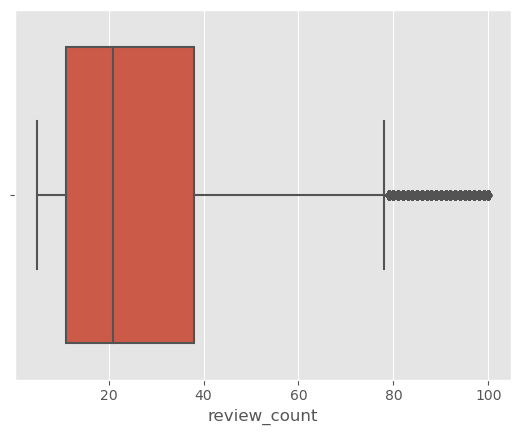

In [471]:
import seaborn as sns
sns.boxplot(x=yelp5['review_count'])

<AxesSubplot:xlabel='checkincnt'>

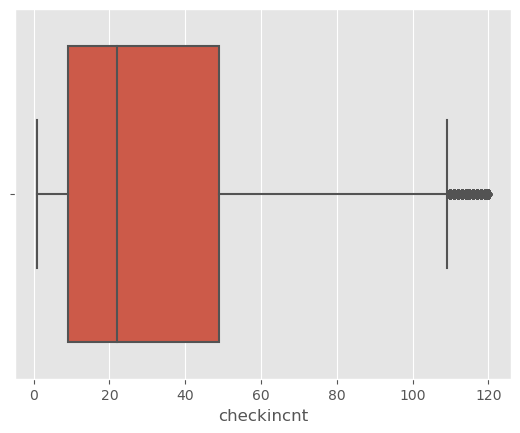

In [474]:
import seaborn as sns
sns.boxplot(x=yelp5['checkincnt'])

<AxesSubplot:xlabel='nu'>

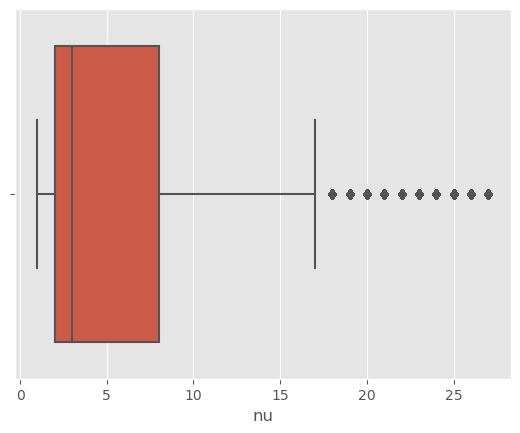

In [463]:
import seaborn as sns
sns.boxplot(x=yelp['nu'])

In [487]:
yelp.describe()

,level_0,index,stars,review_count,is_open,checkincnt,ofdaysopen,Totaltime,AcceptCreditCard,Wifi_free,Wifi_no,Wifi_pay,Noise,parking,Restaurant,Health,Education,Spa,Fitness,Car_services,nu,elite_years,days_yelped,income,star_bin
count,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000,69032.000000
mean,38640.677193,43337.503766,3.628556,33.056206,0.744437,69.479908,6.394904,56.623189,0.800122,0.285317,0.710221,0.004462,0.548760,0.575574,0.541662,0.093478,0.012081,0.144860,0.063174,0.103285,4.802889,2.307119,3381.472583,87858.079899,0.683263
std,22305.975365,25024.318256,0.864511,25.606529,0.436180,114.514591,0.981611,24.874523,0.399912,0.451569,0.453663,0.066647,0.939847,0.494259,0.498265,0.291104,0.109250,0.351963,0.243277,0.304334,4.798117,1.984451,778.628011,33025.694785,0.465207
min,0.000000,0.000000,1.000000,5.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,320.000000,23125.000000,0.000000
25%,19324.750000,21635.750000,3.000000,13.000000,0.000000,11.000000,6.000000,42.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,2902.000000,68050.600000,0.000000
50%,38624.500000,43352.500000,3.500000,25.000000,1.000000,31.000000,7.000000,57.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,1.400000,3445.333333,71908.000000,1.000000
75%,57956.250000,65020.250000,4.500000,47.000000,1.000000,81.000000,7.000000,73.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,3.000000,3918.333333,105336.000000,1.000000
max,77258.000000,86632.000000,5.000000,108.000000,1.000000,2971.000000,7.000000,167.883333,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,27.000000,16.000000,6267.000000,241408.000000,1.000000


In [442]:
def remove_outlier_IQR(df):
    Q1=df.quantile(0.25)
    Q3=df.quantile(0.75)
    IQR=Q3-Q1
    df_final=df[~((df<(Q1-1.5*IQR)) | (df>(Q3+1.5*IQR)))]
    return df_final


In [453]:
yelp['Totaltime'] = yelp['Totaltime'].abs()

In [444]:
def outliers(x):
    q1, q3 = np.percentile(x, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - (iqr * 1.5)
    upper_bound = q3 + (iqr * 1.5)
    return np.where((x > upper_bound) | (x < lower_bound))

In [458]:
out = list(outliers(yelp.nu)[0])

In [461]:
len(list(outliers(yelp.nu)[0]))

9374

In [462]:
yelp.drop(index=out,inplace=True)

In [467]:
yelp = yelp.reset_index()

In [470]:
out = list(outliers(yelp.review_count)[0])
yelp.drop(index=out,inplace=True)

In [472]:
yelp = yelp.reset_index()

In [473]:
out = list(outliers(yelp.review_count)[0])
yelp.drop(index=out,inplace=True)

In [43]:
yelp_outlier_removed=remove_outlier_IQR(yelp.review_count)
yelp_outlier_removed=pd.DataFrame(yelp_outlier_removed)
ind_diff=yelp.index.difference(yelp_outlier_removed.index)

for i in range(0, len(ind_diff),1):
    yelp_final=yelp.drop([ind_diff[i]])
    yelpro=yelp_final
    
sns.boxplot(y='price', x='property_type',data=yelp_final)
plt.xticks(rotation=90)
plt.ylabel('Price ($)')

In [361]:
yelp5 = yelp

In [44]:
yelp5.describe()

In [396]:
yelp5 = yelp[yelp['review_count']<=100]

In [431]:
yelp5 = yelp5[yelp5['checkincnt']<=120]

In [ ]:
fig, ax = plt.subplots(figsize=(16,8))
ax.scatter(yelp['INDUS'], boston_df['TAX'])
ax.set_xlabel('Proportion of non-retail business acres per town')
ax.set_ylabel('Full-value property-tax rate per $10,000')
plt.show()

In [ ]:
def indicies_of_outliers(x):
    q1, q3 = np.percentile(x, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - (iqr * 1.5)
    upper_bound = q3 + (iqr * 1.5)
    return np.where((x > upper_bound) | (x < lower_bound))

tt = 

In [451]:
import re

yelp = pd.read_csv('Yelp_Final.csv')
yelp = yelp.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [452]:
yelp.drop('Unnamed0',axis=1,inplace=True)

In [67]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
lr = LinearRegression()
y_pred = lr.fit(X_train, y_train).predict(X_test)

In [68]:
from sklearn.metrics import mean_squared_error

mean_squared_error(y_test,y_pred)

0.21197179825394616

In [69]:
(mean_squared_error(y_test,y_pred))**0.5

0.4604039511710843

In [70]:
from sklearn.tree import DecisionTreeRegressor 
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

dtr = DecisionTreeRegressor(random_state = 0) 
y_pred = dtr.fit(X_train, y_train).predict(X_test)
mean_squared_error(y_test,y_pred)

0.3738746017821691

In [71]:
(mean_squared_error(y_test,y_pred))**0.5

0.611452861455541

In [253]:
from sklearn.tree import DecisionTreeRegressor 
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

dtr = DecisionTreeRegressor(random_state = 0) 
y_pred = dtr.fit(X_train, y_train).predict(X_test)

In [254]:
mean_squared_error(y_test,y_pred)

1.0322845006694676

In [283]:
from sklearn import tree

plt.figure(figsize=(100, 100))
tree.plot_tree(dtr,max_depth=2)

In [286]:
from sklearn import preprocessing

lab_enc = preprocessing.LabelEncoder()
encoded = lab_enc.fit_transform(yelp['stars'])

In [ ]:
from sklearn import svm
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = encoded

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
svm_multi = svm.SVC(kernel='linear', C=1, decision_function_shape='ovo')
y_pred = svm_multi.fit(X_train, y_train).predict(X_test)
accuracy_score(y_test,y_pred)

In [331]:
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = encoded

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
nbmulti = GaussianNB()
y_pred = nbmulti.fit(X_train, y_train).predict(X_test)
accuracy_score(y_test,y_pred)

0.14682118288009605

In [296]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = encoded

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
dc = DecisionTreeClassifier()
y_pred = dc.fit(X_train, y_train).predict(X_test)

In [298]:
accuracy_score(y_test,y_pred)

0.2289579389630177

In [477]:
yelp_class = yelp

In [435]:
yelp_class5 = yelp5

In [478]:
yelp_class['star_bin'] = yelp_class['stars']

In [437]:
yelp_class5['star_bin'] = yelp_class5['stars']

In [438]:
star_list = []
for i in yelp_class5.star_bin:
    if i < 3.5:
        i = 0
    else:
        i = 1
    star_list.append(i)

In [439]:
yelp_class5['star_bin'] = star_list

In [479]:
star_list = []
for i in yelp_class.star_bin:
    if i < 3.5:
        i = 0
    else:
        i = 1
    star_list.append(i)

In [480]:
yelp_class['star_bin'] = star_list

In [34]:
from sklearn.metrics import accuracy_score

In [272]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

X = yelp_class.drop(['business_id','stars','star_bin'],axis=1)
y = yelp_class['star_bin']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
dc = DecisionTreeClassifier()
y_pred = dc.fit(X_train, y_train).predict(X_test)

In [273]:
accuracy_score(y_test,y_pred)

0.6622189390091878

In [65]:
from sklearn import metrics 

In [264]:
yelp_class[yelp_class['star_bin']==1]

,Unnamed0,business_id,stars,review_count,is_open,checkincnt,ofdaysopen,Totaltime,AcceptCreditCard,Wifi_free,Wifi_no,Wifi_pay,Noise,parking,Restaurant,Health,Education,Spa,Fitness,Car_services,nu,elite_years,days_yelped,income,star_bin


In [484]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = yelp_class.drop(['business_id','stars','star_bin'],axis=1)
y = yelp_class['star_bin']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
rc = RandomForestClassifier(n_estimators = 100, random_state = 42)
y_pred = rc.fit(X_train, y_train).predict(X_test)
accuracy_score(y_test,y_pred)

0.7109166763240237

<AxesSubplot:>

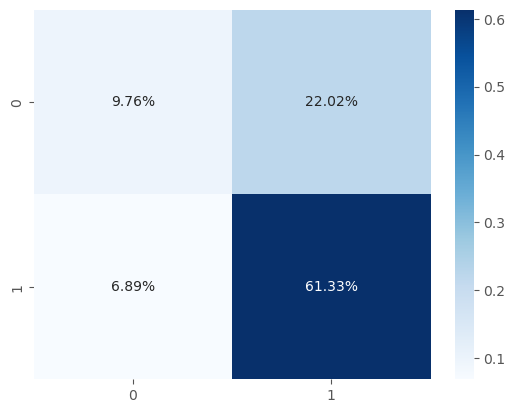

In [485]:
from sklearn.metrics import confusion_matrix
import pylab as pl

cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm/np.sum(cm), annot=True, 
            fmt='.2%', cmap='Blues')

In [332]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

X = yelp_class.drop(['business_id','stars','star_bin'],axis=1)
y = yelp_class['star_bin']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
rc = RandomForestClassifier(n_estimators = 100, random_state = 42)
y_pred = rc.fit(X_train, y_train).predict(X_test)

In [333]:
accuracy_score(y_test,y_pred)

0.7484186712221248

In [15]:
from sklearn.metrics import confusion_matrix
import pylab as pl

cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm/np.sum(cm), annot=True, 
            fmt='.2%', cmap='Blues')

In [16]:
print(metrics.classification_report(y_test,y_pred))

In [17]:
print(metrics.confusion_matrix(y_test,y_pred))

In [18]:
yelp_class.columns

In [19]:
yelp_class

In [20]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

X = yelp_class.drop(['business_id','stars','star_bin'],axis=1)
y = yelp_class['star_bin']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
logr = LogisticRegression()
y_pred = logr.fit(X_train, y_train).predict(X_test)
accuracy_score(y_test,y_pred)

In [22]:
cm = confusion_matrix(y_test,y_pred)
sns.heatmap(cm/np.sum(cm), annot=True, 
            fmt='.2%', cmap='Blues')

In [23]:
y_pred.to_list()

In [24]:
for i,j in zip(y_test,y_pred):
    print(i,j)

In [5]:
import lightgbm as lgb
# import shap
# from plotly.subplots import make_subplots
# import plotly.graph_objects as go

pd.set_option('display.max_rows', 160)
pd.set_option('display.max_columns', 160)
pd.set_option('display.max_colwidth', 30)

import warnings
warnings.filterwarnings("ignore")

In [6]:
def build_lgb_model(params, X_train, X_val, y_train, y_val, cat_features):
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_val = lgb.Dataset(X_val, y_val)
    model = lgb.train(params=params, train_set=lgb_train, valid_sets=(lgb_train, lgb_val), verbose_eval=50,
                     categorical_feature=cat_features)
    return model

In [97]:
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)

In [25]:
yelp.columns

In [76]:
params = {
    'objective': 'mse',
    'metric': 'mse',
    'num_leaves': 1023,
    'min_data_in_leaf':11,
    'feature_fraction':0.8,
    'learning_rate': 0.01,
    'num_rounds': 1000,
    'early_stopping_rounds': 33,
    'seed': 3
}
#designating the categorical features which should be focused on
cat_features = ['AcceptCreditCard',
       'Wifi_free', 'Wifi_no', 'Wifi_pay', 'Noise', 'parking', 'Restaurant',
       'Health', 'Education', 'Spa', 'Fitness', 'Car_services']

lgb_model = build_lgb_model(params, X_train, X_val, y_train, y_val, cat_features)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2007
[LightGBM] [Info] Number of data points in the train set: 64974, number of used features: 23
[LightGBM] [Info] Start training from score 3.654246
Training until validation scores don't improve for 33 rounds
[50]	training's l2: 0.366583	valid_1's l2: 0.386791
[100]	training's l2: 0.23296	valid_1's l2: 0.269315
[150]	training's l2: 0.170915	valid_1's l2: 0.220272
[200]	training's l2: 0.138329	valid_1's l2: 0.19889
[250]	training's l2: 0.119583	valid_1's l2: 0.190253
[300]	training's l2: 0.106363	valid_1's l2: 0.185818
[350]	training's l2: 0.0964507	valid_1's l2: 0.18395
[400]	training's l2: 0.0883634	valid_1's l2: 0.183043
[450]	training's l2: 0.0814701	valid_1's l2: 0.182684
[500]	training's l2: 0.0754676	valid_1's l2: 0.182466
[550]	training's l2: 0.0701275	valid_1's l2: 0.182427
Early stop

In [78]:
params = {
    'objective': 'rmse',
    'metric': 'rmse',
    'num_leaves': 1023,
    'min_data_in_leaf':11,
    'feature_fraction':0.8,
    'learning_rate': 0.01,
    'num_rounds': 1000,
    'early_stopping_rounds': 33,
    'seed': 3
}
#designating the categorical features which should be focused on
cat_features = ['AcceptCreditCard',
       'Wifi_free', 'Wifi_no', 'Wifi_pay', 'Noise', 'parking', 'Restaurant',
       'Health', 'Education', 'Spa', 'Fitness', 'Car_services']

lgb_model = build_lgb_model(params, X_train, X_val, y_train, y_val, cat_features)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006792 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2007
[LightGBM] [Info] Number of data points in the train set: 64974, number of used features: 23
[LightGBM] [Info] Start training from score 3.654246
Training until validation scores don't improve for 33 rounds
[50]	training's rmse: 0.605461	valid_1's rmse: 0.621925
[100]	training's rmse: 0.482659	valid_1's rmse: 0.518955
[150]	training's rmse: 0.413419	valid_1's rmse: 0.469331
[200]	training's rmse: 0.371926	valid_1's rmse: 0.445971
[250]	training's rmse: 0.345808	valid_1's rmse: 0.43618
[300]	training's rmse: 0.326133	valid_1's rmse: 0.431066
[350]	training's rmse: 0.310565	valid_1's rmse: 0.428894
[400]	training's rmse: 0.29726	valid_1's rmse: 0.427836
[450]	training's rmse: 0.28543	valid_1's rmse: 0.427416
[500]	training's rmse

In [86]:
import re

df = pd.read_csv('Yelp_Final.csv')
df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [89]:
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)

In [93]:
def build_lgb_model(params, X_train, X_val, y_train, y_val):
    lgb_train = lgb.Dataset(X_train, y_train)
    lgb_val = lgb.Dataset(X_val, y_val)
    model = lgb.train(params=params, train_set=lgb_train, valid_sets=(lgb_train, lgb_val), verbose_eval=50)
    return model

In [98]:
params = {
    'objective': 'mse',
    'metric': 'mse',
    'num_leaves': 1023,
    'min_data_in_leaf':11,
    'feature_fraction':0.8,
    'learning_rate': 0.01,
    'num_rounds': 1000,
    'early_stopping_rounds': 33,
    'seed': 3
}

lgb_model = build_lgb_model(params, X_train, X_val, y_train, y_val)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013244 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1994
[LightGBM] [Info] Number of data points in the train set: 64974, number of used features: 22
[LightGBM] [Info] Start training from score 3.654246
Training until validation scores don't improve for 33 rounds
[50]	training's l2: 0.519953	valid_1's l2: 0.571841
[100]	training's l2: 0.43259	valid_1's l2: 0.528638
[150]	training's l2: 0.374917	valid_1's l2: 0.50865
[200]	training's l2: 0.333236	valid_1's l2: 0.499356
[250]	training's l2: 0.300061	valid_1's l2: 0.494729
[300]	training's l2: 0.272714	valid_1's l2: 0.492055
[350]	training's l2: 0.248952	valid_1's l2: 0.490057
[400]	training's l2: 0.227585	valid_1's l2: 0.488344
[450]	training's l2: 0.209085	valid_1's l2: 0.487435
[500]	training's l2: 0.192831	valid_1's l2: 0.486987
[550]	training's l2: 0.178926	valid_1's l2: 0.486597
[600]	training

In [488]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
lr = LinearRegression()
y_pred = lr.fit(X_train, y_train).predict(X_test)

In [26]:
mean_squared_error(y_test,y_pred)

In [27]:
for i,j in zip(y_test,y_pred):
    print(i,j)

In [494]:
from sklearn.tree import DecisionTreeRegressor 
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

dtr = DecisionTreeRegressor(random_state = 0) 
y_pred = dtr.fit(X_train, y_train).predict(X_test)
mean_squared_error(y_test,y_pred)

0.41151929539923515

In [28]:
metrics.r2_score(y_test,y_pred)

In [29]:
for i,j in zip(y_test,y_pred):
    print(i,j)

In [119]:
from sklearn.ensemble import RandomForestRegressor
  
X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
rr = RandomForestRegressor()
y_pred = rr.fit(X_train, y_train).predict(X_test)
mean_squared_error(y_test,y_pred)

0.5073601747541439

In [136]:
metrics.r2_score(y_test,y_pred)

0.2442523917320607

In [135]:
mean_squared_error(y_test,y_pred_round)

0.528267694722748

In [130]:
def round_off_rating(number):

    return round(number * 2) / 2

In [132]:
y_pred_round = []
for i in y_pred:
    y_pred_round.append(round_off_rating(i))

In [30]:
for i,j in zip(y_test,y_pred_round):
    print(i,j)

In [10]:
from sklearn import datasets
import xgboost as xgb

param = {
    'eta': 0.3, 
    'max_depth': 3,  
    'eval_metric' : 'mlogloss',
    'num_class': 3} 

steps = 20

X = yelp_class.drop(['business_id','stars','star_bin'],axis=1)
y = yelp_class['star_bin']

xgb_model = xgb.XGBClassifier(num_class=7,
                                  learning_rate=0.1,
                                  num_iterations=1000,
                                  max_depth=10,
                                  feature_fraction=0.7, 
                                  scale_pos_weight=1.5,
                                  boosting='gbdt',
                                  metric='multiclass',
                                  eval_metric='mlogloss')

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)
D_train = xgb.DMatrix(X_train, label=y_train)
D_test = xgb.DMatrix(X_test, label=y_test)

model = xgb_model.fit(param, D_train, steps)
y_pred = model.predict(D_test)

In [157]:
y_pred_xg = []
for i in y_pred:
    y_pred_xg.append(i.astype(int))

In [11]:
accuracy_score(y_test,y_pred_xg)

In [12]:
y_pred_xg

In [13]:
yelp.columns

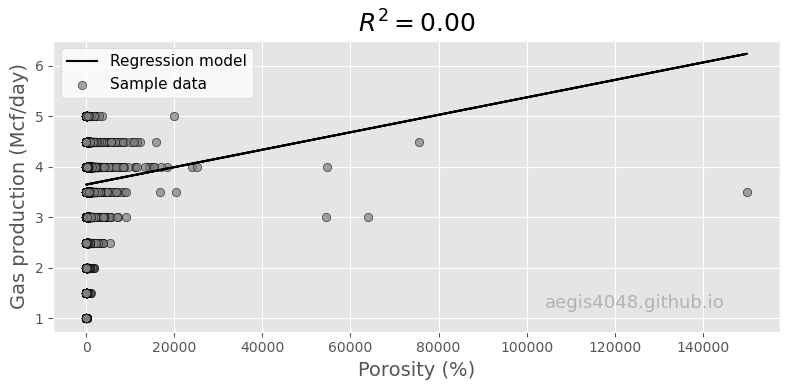

In [175]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import linear_model

######################################## Data preparation #########################################

file = 'https://aegis4048.github.io/downloads/notebooks/sample_data/unconv_MV_v5.csv'
df = pd.read_csv(file)

X = yelp['of'].values.reshape(-1,1)
y = yelp['stars'].values

################################################ Train #############################################

ols = linear_model.LinearRegression()
model = ols.fit(X, y)
response = model.predict(X)

############################################## Evaluate ############################################

r2 = model.score(X, y)

############################################## Plot ################################################

plt.style.use('default')
plt.style.use('ggplot')

fig, ax = plt.subplots(figsize=(8, 4))

ax.plot(X, response, color='k', label='Regression model')
ax.scatter(X, y, edgecolor='k', facecolor='grey', alpha=0.7, label='Sample data')
ax.set_ylabel('Gas production (Mcf/day)', fontsize=14)
ax.set_xlabel('Porosity (%)', fontsize=14)
ax.text(0.8, 0.1, 'aegis4048.github.io', fontsize=13, ha='center', va='center',
         transform=ax.transAxes, color='grey', alpha=0.5)
ax.legend(facecolor='white', fontsize=11)
ax.set_title('$R^2= %.2f$' % r2, fontsize=18)

fig.tight_layout()

In [33]:
yelp.columns

In [194]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars','ofdaysopen', 'Wifi_pay', 'Noise', 'parking'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
lr = LinearRegression()
y_pred = lr.fit(X_train, y_train).predict(X_test)

In [35]:
mean_squared_error(y_test,y_pred)

In [187]:
import seaborn as sns
g = sns.pairplot(yelp)

In [185]:
from matplotlib import pyplot

In [34]:
lr.coef_

In [36]:
yelp.columns

In [207]:
xc = X.columns.to_list()

In [14]:
xc

Feature: review_count, Score: 0.12652
Feature: is_open, Score: 0.01410
Feature: checkincnt, Score: 0.11910
Feature: ofdaysopen, Score: 0.07043
Feature: Totaltime, Score: 0.16635
Feature: AcceptCreditCard, Score: 0.01294
Feature: Wifi_free, Score: 0.00564
Feature: Wifi_no, Score: 0.00869
Feature: Wifi_pay, Score: 0.00098
Feature: Noise, Score: 0.02301
Feature: parking, Score: 0.01431
Feature: Restaurant, Score: 0.01707
Feature: Health, Score: 0.01083
Feature: Education, Score: 0.00204
Feature: Spa, Score: 0.01106
Feature: Fitness, Score: 0.01208
Feature: Car_services, Score: 0.01120
Feature: nu, Score: 0.05509
Feature: elite_years, Score: 0.06549
Feature: days_yelped, Score: 0.14449
Feature: income, Score: 0.10858


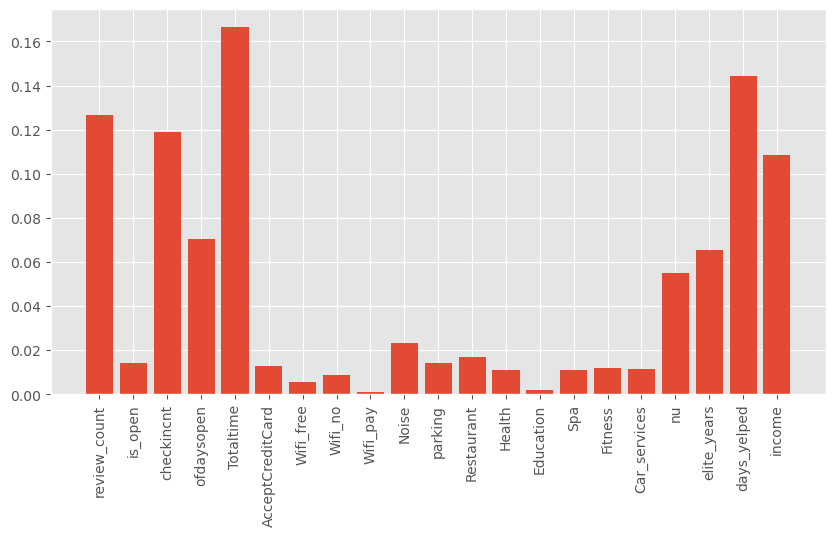

In [228]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define dataset
# define the model
X = yelp.drop(['business_id','stars'],axis=1)
y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)
model = DecisionTreeRegressor()
# fit the model
model.fit(X_train, y_train)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in zip(xc,importance):
    print('Feature: %0s, Score: %.5f' % (i,v))
# plot feature importance
pyplot.figure(figsize=(10,5))
pyplot.bar([x for x in range(len(importance))], importance,tick_label=xc)
plt.xticks([x for x in range(len(importance))], xc, rotation='vertical')
pyplot.show()

In [236]:
from sklearn.tree import DecisionTreeRegressor 
from sklearn.model_selection import train_test_split

X = yelp.drop(['business_id','stars','is_open','AcceptCreditCard',
 'Wifi_free',
 'Wifi_no',
 'Wifi_pay',
 'Noise',
 'parking',
 'Restaurant',
 'Health',
 'Education',
 'Spa',
 'Fitness','Car_services'],axis=1)

y = yelp['stars']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

dtr = DecisionTreeRegressor(random_state = 0) 
y_pred = dtr.fit(X_train, y_train).predict(X_test)
mean_squared_error(y_test,y_pred)

1.1233321021284455

In [31]:
metrics.r2_score(y_test,y_pred)

In [32]:
importance = lr.coef_
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()